# Homework #4
 
1. Extraction protocol
2. EDA
3. Data cleansing
 
### Part 1 - Extraction protocol
 
Fill the excel file with the variables, indicating the values required in the file.

### Part 2 - EDA
 
#### 2.1 - Descriptive statistics
 
Generate a table showing the minimum, maximum, median, IQR, mean and standard deviation for each variable. Use the functions summary (in R), describe (in Python), or use the Table1 function from the mechkar package

In [1]:
if (!require("car")) install.packages("car")
if (!require("tibble")) install.packages("tibble")
if (!require("dplyr")) install.packages("dplyr")

Loading required package: car
Loading required package: carData
Loading required package: tibble
Loading required package: dplyr

Attaching package: ‘dplyr’

The following object is masked from ‘package:car’:

    recode

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



In [ ]:
#con <-dbConnect(odbc(),
   #             Driver="SQL Server", 
    #            Server= "DESKTOP-F1Q7Q52\\SQLEXPRESS",
    #            Database="BoxOffice",
    #            Trusted_connection = "True")


In [ ]:
#movies_ff <- dbReadTable(con,"movies_ff_v")


In [ ]:
#movies_ff

In [4]:
load ("C:/Users/elile/Desktop/DS10/GITT/data/BoxOffice_ff.RData")


In [5]:
df<-movies_ff
y<-"revenue"

In [7]:
head(df)

,movie_id,budget,original_language,popularity,release_date,runtime,runtime_cat,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<int>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,14000000,en,6.575393,2015-02-20,93,Short,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,40000000,en,8.248895,2004-08-06,113,Medium,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,3300000,en,64.299990,2014-10-10,105,Medium,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,1200000,hi,3.174936,2012-03-09,122,Large,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,0,ko,1.148070,2009-02-05,118,Medium,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,8000000,en,0.743274,1987-08-06,83,Short,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0


In [8]:
####################  FUNCTIONS  ###########################################
#### Usage:
####   x: character vector with the name of the variables
####   y: the name of the strata variable (optional)
####   rn: character vector with the text we want to replace the variable names
####   data: the dataset to be used
####   miss: include missing statistics: [0=none, 1=only for categorical variables, 2=for all variables]
####   excel: export the table to excel [0=no, 1=yes]
####   excel_file: the name of the excel file we want to save the table (optional)
####
###################

Table1 <- function(x=NULL, y=NULL, rn=NULL, data=NULL, miss=3, catmiss=TRUE, formatted=TRUE, categorize=FALSE,
                    factorVars=NULL, maxcat=10, delzero=TRUE, decimals=1, messages=TRUE, excel=0, excel_file=NULL,
                    debug=FALSE) {
  ### define sub-functions
  options(warn=-1)
  Del <- NULL
  Pop <- NULL
  n <- NULL
  g1 <- function(var)c(Mean=mean(var,na.rm=TRUE), SD=stats::sd(var,na.rm=TRUE))
  g2 <- function(var)c(Median=stats::median(var,na.rm=TRUE), IQR=stats::quantile(var,c(0.25,0.75),na.rm=TRUE))
  msg <- NULL

  ### function for transforming variables to factors
  setFactors <- function(data=data, factorVars=factorVars, catmiss=catmiss, maxcat=maxcat) {
    #print(factorVars)
    if(is.null(factorVars)==T) {
      aa <- sapply(sapply(data, unique), length)
      factorVars <- names(which(aa <= maxcat))
    }
    #print(factorVars)
    for (v in factorVars) {
      ct <- ifelse( ((is.null(factorVars)==F & (v %in% factorVars)) | (is.null(factorVars)==T & length(unique(data[[v]])) <= maxcat)),1,0)
      if (ct == 1) {
        data[[v]] <- factor(data[[v]])
        if(catmiss == T & sum(is.na(data[[v]])==T) > 0) {
          data[[v]] <- factor(data[[v]],levels=c(levels(data[[v]]),"Missing"))
          data[[v]][which(is.na(data[[v]])==T)] <- "Missing"
        }
      }
    }
    return(data)
  }
  ### proceed to convert varibles to factors
  if (categorize == T | is.null(factorVars)==F ) {
    data <- setFactors(data, factorVars, catmiss, maxcat)
  }

  getSimpleTable  <- function(x=x, rn=rn, data=data, miss=miss, catmiss=catmiss,formatted=formatted,
                              categorize=categorize,maxcat=maxcat, delzero=delzero) {
    if (is.null(x)==TRUE) { x <- names(data)}
    if (is.null(rn)==TRUE) { rn <- x}
    ln <- length(x)
    pb <- utils::txtProgressBar(min=0,max=ln,style=3)
    msg <- NULL
    ### define the column names
    tableaaaa <- cbind(Del="Del",V1="Variables",V2="Categories",n="n","Population")
    tablebbbb <- cbind(Del="Del",V1="Variables",V2="Categories",n="n",val1="val1",val2="val2",val3="val3")
    tbl1 <- cbind(0,"Individuals","n",n=1, nrow(data))
    tbl2 <- cbind(0,"Individuals","n",n=1, nrow(data),NA,NA)
    tableaaaa <- rbind(tableaaaa,tbl1)
    tablebbbb <- rbind(tablebbbb,tbl2)
    q <- 1
    n <- 1
    ii <- 1
    for (v in x)
    {
      if (v %in% names(data)) {
        ### define if the actual variable has to be treated as numeric or factor
        ct <- ifelse(is.numeric(data[[v]])==T & categorize==T &
                       ((is.null(factorVars)==F & (v %in% factorVars)) |
                          (is.null(factorVars)==T & length(unique(data[[v]])) <= maxcat)),1,0)
        ### treat as numeric
        if (length(unique(data[v]))==0) {
          if (messages==T) {
            #print(paste("The variable",v,"has no data... avoided"))
            msg <- c(msg, paste("The variable",v,"has no data... avoided"))
          }
        } else if (inherits(data[[v]], "Date")==TRUE) {
          if (messages==T) {
            msg <- c(msg, paste("The variable",v,"is a date. Dates are not allowed in Table1... avoided"))
          }
        } else if (is.numeric(data[[v]])==T & ct==0) {
          ## report mean and standard deviation
          t_n <- g1(data[[v]])
          tp <- paste(format(round(t_n[1],decimals),nsmall=1,big.mark=",")," (", format(round(t_n[2],decimals),nsmall=1,big.mark=","),")",sep="")
          tbl1 <- cbind(0,rn[q],"Mean (SD)",n=1, tp)
          tbl2 <- cbind(0,rn[q],"Mean (SD)",n=1,t_n[1],t_n[2],NA)
          tableaaaa <- rbind(tableaaaa,tbl1)
          tablebbbb <- rbind(tablebbbb,tbl2)
          ## report median and Interquartile ranges (25%,75%)
          t_n <- g2(data[[v]])
          tp <- paste(format(round(t_n[1],decimals),nsmall=1,big.mark=",")," (", format(round(t_n[2],decimals),nsmall=1,big.mark=","),"-", format(round(t_n[3],decimals),nsmall=1,big.mark=","), ")",sep="")
          tbl1 <- cbind(0,rn[q],"Median (IQR)",n=2, format(tp,big.mark=","))
          tbl2 <- cbind(0,rn[q],"Median (IQR)",n=2,t_n[1],t_n[2],t_n[3])
          tableaaaa <- rbind(tableaaaa,tbl1)
          tablebbbb <- rbind(tablebbbb,tbl2)
          ## report number and percent of missing
          if (miss >= 1) {
            datams <- subset(data,is.na(data[[v]])==T)
            if (nrow(datams)>0) {
              data$cnt <- 1
              datams$cnt <- 1
              t_n <- table(data$cnt)
              t_m <- sum(datams$cnt)
              tp <- paste(format(t_m,big.mark=",")," (",format(round((t_m/t_n)*100,decimals),nsmall=1,big.mark=","),"%)",sep="")
              tbl1 <- cbind(0,rn[q],"Missing (%)",n=3, tp)
              tbl2 <- cbind(0,rn[q],"Missing (%)",n=3, t_m, (t_m/t_n)*100, NA)
            } else {
              tbl1 <- cbind(1,rn[q],"Missing (%)",n=3, " -- ")
              tbl2 <- cbind(1,rn[q],"Missing (%)",n=3, NA, NA, NA)
            }
            tableaaaa <- rbind(tableaaaa,tbl1)
            tablebbbb <- rbind(tablebbbb,tbl2)
          }
        } else {
          t_n <- table(data[[v]])
          ttotal <- sum(t_n)
          nm <- row.names(t_n)
          for (f in 1:length(nm)) {
            del1 <- ifelse(length(nm)==2 & (nm[f]=="No" | nm[f]=="no" | nm[f]==0 | nm[f]=="0" | nm[f]=="None" | nm[f]=="none"),1,0)
            tp <- t_n[f] / ttotal * 100
            pct <- paste(format(round(t_n[f],decimals),nsmall=0,big.mark=",")," (", format(round(tp,decimals),nsmall=1,big.mark=","), "%)",sep="")
            tbl1 <- cbind(del1,rn[q],nm[f],n=f, pct)             ########### delete rows 0/1 !!!!!!!!!
            tbl2 <- cbind(del1,rn[q],nm[f],n=f, t_n[f], tp, NA)  ########### delete rows 0/1 !!!!!!!!!
            tableaaaa <- rbind(tableaaaa,tbl1)
            tablebbbb <- rbind(tablebbbb,tbl2)
          }
          if (miss >= 2 & catmiss==F ) {
            datams <- subset(data,is.na(data[[v]])==T)
            if (nrow(datams)>0) {
              data$cnt <- 1
              datams$cnt <- 1
              t_n <- table(data$cnt)
              t_m <- sum(datams$cnt)
              tp <- paste(format(t_m,big.mark=",")," (",format(round((t_m/t_n)*100,decimals),nsmall=1,big.mark=","),"%)",sep="")
              tbl1 <- cbind(0,rn[q],"Missing (%)",n=f, tp)
              tbl2 <- cbind(0,rn[q],"Missing (%)",n=f, t_m, (t_m/t_n)*100, NA)
            } else {
              tbl1 <- cbind(1,rn[q],"Missing (%)",n=f, " -- ")
              tbl2 <- cbind(1,rn[q],"Missing (%)",n=f, NA, NA, NA)
            }
            tableaaaa <- rbind(tableaaaa,tbl1)
            tablebbbb <- rbind(tablebbbb,tbl2)
          }
        }
      } else {
        if (messages==T) {
          msg <- c(msg, paste("The variable",v,"doesn't exists in the dataset... avoiding"))
        }
      }
      q <- q + 1
      if(debug==FALSE) {
        utils::setTxtProgressBar(pb,ii)
        ii <- ii + 1
      } else {
        print(v)
      }
    }
    if(formatted==TRUE) {
      return(tableaaaa)
    } else {
      return(tablebbbb)
    }
    close(pb)
  }

  pvals <- function(x=x,y=y,rn=rn,data=data,categorize=categorize,maxcat=maxcat) {
    ptab <- NULL
    if (is.null(y)==FALSE) {
      if (y %in% names(data)) {
        if (is.null(x)==TRUE) { x <- names(data)}
        if (is.null(rn)==TRUE | length(rn)<2) {rn <- x}
        q <- 1
        ptab <- cbind(V="Variables",pval="pval", n="n")

        ln <- length(x)
        ii <- 0
        pb <- utils::txtProgressBar(min=0,max=ln,style=3)

        for (v in x) {
          if (v %in% names(data)) {
            ct <- ifelse(is.numeric(data[[v]])==T & categorize==T & length(unique(data[[v]])) <= maxcat,1,0)
            if (is.numeric(data[[y]])==T & categorize==T & length(unique(data[[y]])) <= maxcat) {
              data[[y]] <- as.factor(data[[y]])
            } else if (is.numeric(data[[y]])==T) {
              if (messages==T) {
                msg <- c(msg, paste("The variable",y,"is not a factor. Please convert to factor or change the 'categorize' flag to TRUE."))
              }
              pval <- "Please rerun!!!"
            }
            if (is.numeric(data[[v]])==TRUE & length(unique(data[[v]])) > 1 & ct == 0) {
              ### first check for homoscedasticity
              tryCatch({
                if (stats::bartlett.test(data[[v]], data[[y]])[3] >= 0.05) {
                  pval <- round(as.numeric(suppressMessages(car::Anova(stats::lm(data[[v]] ~ data[[y]])))[1, 4]), 3)
                } else {
                  pval <- round(as.numeric(suppressMessages(car::Anova(stats::lm(data[[v]] ~ data[[y]]), white.adjust = TRUE))[1, 3]), 3)
                }
              }, warning = function(w) {
                ww <- "suppress warnings..."
              }, error = function(e) {
                pval <- "---"
              })
            } else if (length(unique(data[[v]]))==1) {
              pval <- NA
            } else {
              if (min(table(data[[v]],data[[y]])) > 5) {
                pval <- round(as.numeric(stats::chisq.test(data[[v]],data[[y]])$p.val),3)
              } else {
                if(min(table(data[[v]],data[[y]]))==0) {
                  #in cases where there are cells with zero, we use Fisher's exact test
                  tryCatch(
                    pval <- round(as.numeric(stats::fisher.test(data[[v]],data[[y]], workspace=1e9)$p.val),3),
                    error = function(e) {msg <- c(msg,paste0("Unable to calcualte the Fisher test for variables ",v," and ",y))})
                } else {
                  pval <- round(as.numeric(stats::kruskal.test(data[[v]],data[[y]], workspace=1e9)$p.val),3)
                }
              }
            }
            ptab <- rbind(ptab,cbind(V=rn[q],pval=pval,n=2))
          }
          if(debug==FALSE) {
            utils::setTxtProgressBar(pb,ii)
            ii <- ii + 1
          }
          q <- q + 1
        }
      }
    }
    return(ptab)
  }
  ####################### Begin analysis
  ##### check for x's witch have one unique values...get them out...


  vv <- NULL
  j <- 0
  jj <- NULL
  for(v in x) {
    if(length(unique(data[[v]])) < 2) {
      vv <- c(vv,v)
      j <- j + 1
      jj <- c(jj,j)
    }
  }
  warning(paste("The following variables have unique values and will not be included in the analysis:",vv))
  x <- setdiff(x, vv)
  if(is.null(rn)==FALSE & length(jj)>0) {
    rn <- rn[-jj]
  }

  ##### if y is null then make a simple table
  tabaaa1 <- getSimpleTable(x=x, rn=rn, data=data, miss=miss, catmiss=catmiss,formatted=formatted,categorize=categorize,maxcat=maxcat, delzero=delzero)
  tabaaa1 <- tibble::as.tibble(tabaaa1)
  ############################  CHANGE TO 5 !!!!!!!!!!!!!!
  if(length(tabaaa1) > 5) {
    names(tabaaa1) <- c("Del","V1","V2","n","Pop","pop2","pop3")
  } else {
    names(tabaaa1) <- c("Del","V1","V2","n","Pop")
  }
  ##### if y has two levels, then make a compound comparison
  if (is.null(y)==FALSE){
    if (y %in% names(data)) {
      if (is.factor(data[[y]])==F) {
        if (length(levels(factor(data[[y]]))) > 8) {
          if (messages==T) {
            print("The dependent variable has more than 8 levels, table too large!")
          }
        } else if(min(table(data[[y]]))==0) {
          print("The dependent variable has one or more levels with no individuals assigned!")
        } else {
          data[[y]] <- factor(data[[y]])
        }
      }
      if (length(levels(data[[y]])) >= 2) {
        for (lv in levels(data[[y]])) {
          dtsub <- subset(data, data[[y]]==lv)
          tab <- getSimpleTable(x=x, rn=rn, data=dtsub, miss=miss, catmiss=catmiss, formatted=formatted,categorize=categorize,maxcat=maxcat, delzero=delzero)
          tab <- data.frame(tab)
          ############################  CHANGE TO 5 !!!!!!!!!!!!!!
          if(length(tab) > 5) {
            names(tab) <- c("Del","V1","V2","n",paste0(lv,"_1"),paste0(lv,"_2"),paste0(lv,"_3"))
          } else {
            names(tab) <- c("Del","V1","V2","n",lv)
          }
          ############################  CHANGE TO 5 !!!!!!!!!!!!!!
          tab[1,5] <- lv
          tabaaa1 <- suppressMessages(dplyr::left_join(tabaaa1, tab))
        }
        # what to do with dichotomous variables? We remove the "Zero" label...
        # clean unnecesary rows
        if (delzero == TRUE) {
          tabaaa1 <- dplyr::filter(tabaaa1,Del==0)
        }
        ### calculate the p-value
        ptab <- data.frame(pvals(x=x,y=y,rn=rn,data=data,categorize=categorize,maxcat=maxcat))
        names(ptab) <- c("V1","pval","n")
        tabaaa1 <- suppressMessages(dplyr::left_join(tabaaa1, ptab))
        tabaaa1 <- dplyr::filter(tabaaa1,Pop != " -- ") #%>%
      }
    }
  }

  tabaaa1 <- dplyr::select(tabaaa1,-n)
  tabaaa1 <- dplyr::select(tabaaa1,-Del)

  ##### returns the table...
  return(tabaaa1)
}

########################## END Table1 ###############

In [9]:
summary(df)

    movie_id        budget          original_language    popularity     
 Min.   :   1   Min.   :        0   Length:7375        Min.   :  0.000  
 1st Qu.:1848   1st Qu.:        0   Class :character   1st Qu.:  3.970  
 Median :3696   Median :  8000000   Mode  :character   Median :  7.456  
 Mean   :3698   Mean   : 22666657                      Mean   :  8.540  
 3rd Qu.:5550   3rd Qu.: 29000000                      3rd Qu.: 10.932  
 Max.   :7398   Max.   :380000000                      Max.   :547.488  
                                                                        
 release_date          runtime      runtime_cat           revenue         
 Length:7375        Min.   :  0.0   Length:7375        Min.   :1.000e+00  
 Class :character   1st Qu.: 94.0   Class :character   1st Qu.:2.405e+06  
 Mode  :character   Median :104.0   Mode  :character   Median :1.693e+07  
                    Mean   :107.7                      Mean   :6.688e+07  
                    3rd Qu.:118.0        

In [10]:
Table1(data = df)

  |======================================================================| 100%

V1,V2,Pop
<chr>,<chr>,<chr>
Variables,Categories,Population
Individuals,n,7375
movie_id,Mean (SD),"3,698.1 (2,136.7)"
movie_id,Median (IQR),"3,696.0 (1,848.5-5,550.5)"
movie_id,Missing (%),--
budget,Mean (SD),"22,666,656.9 (36,987,354.2)"
budget,Median (IQR),8e+06 (0.0-2.9e+07)
budget,Missing (%),--
original_language,af,1 (0.0%)


#### 2.2 - Visualization of the variables
 
For continuous variables plot two/three graphs: 
 
- one showing possible outliers (boxplot or scatterplot with index as x-axis)
- one showing the distribution (histogram)

Optionally, the exploreData function of the mechkar package could be used

In [11]:
if (!require("ggplot2")) install.packages("ggplot2")
if (!require("gridExtra")) install.packages("gridExtra")


Loading required package: ggplot2
Loading required package: gridExtra


[1] "movie_id"
[1] "budget"


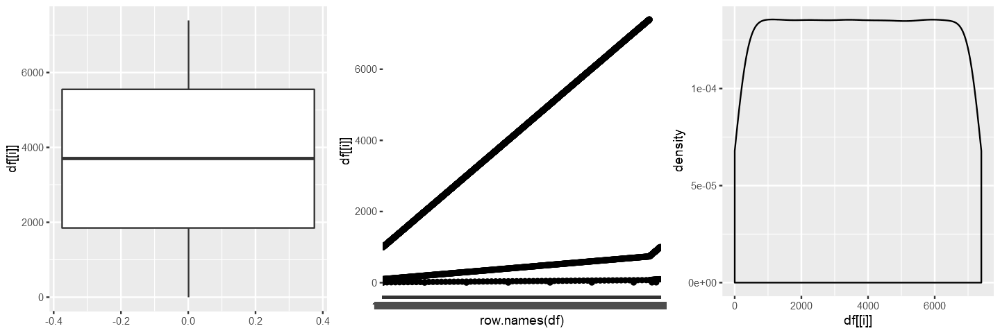

[1] "original_language"


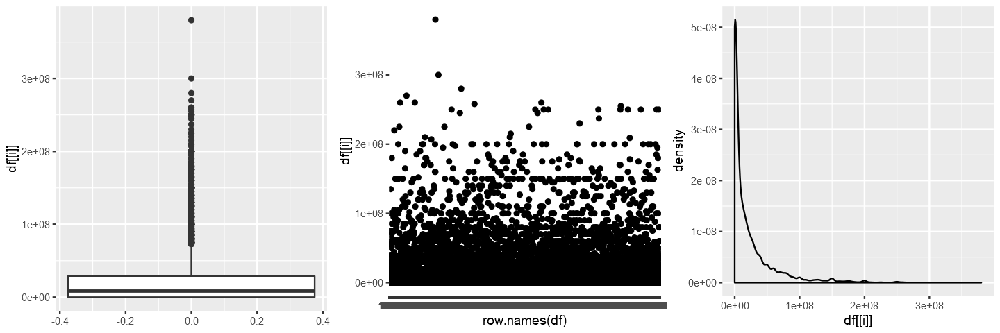

[1] "popularity"


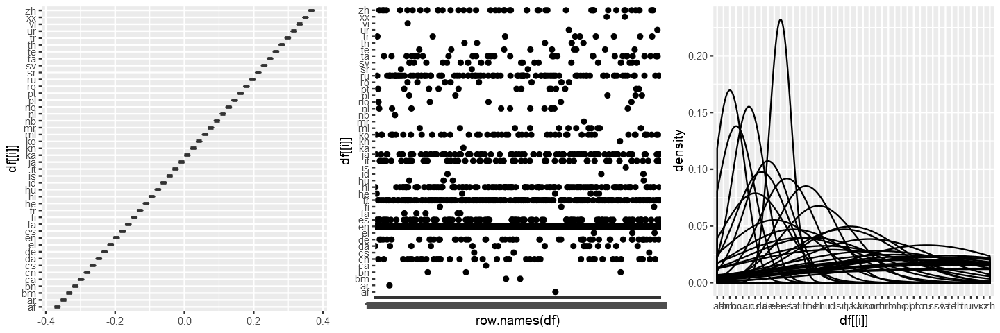

[1] "release_date"


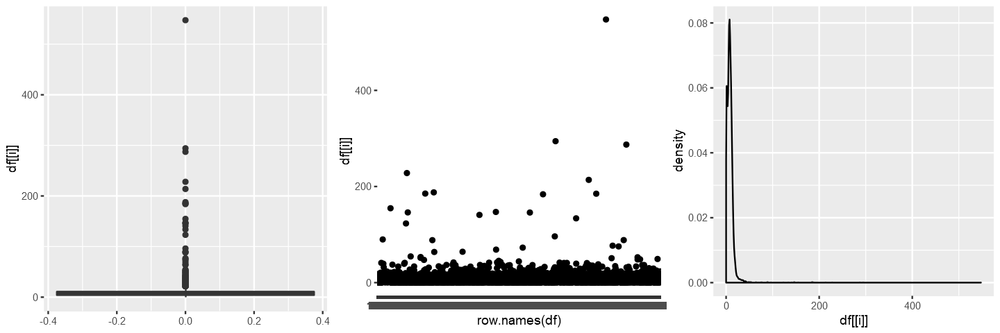

[1] "runtime"


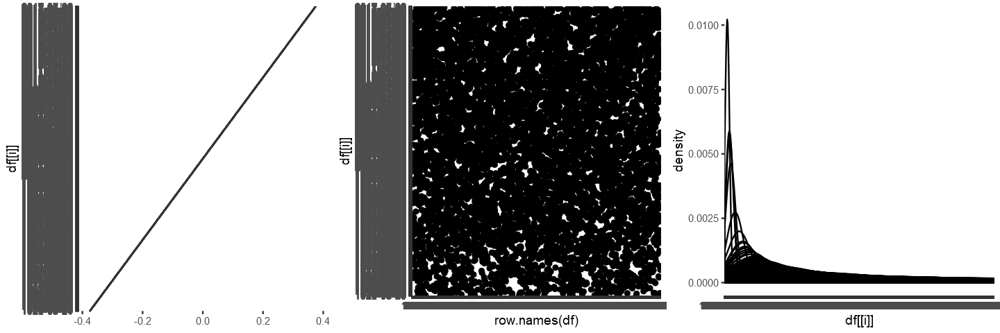

[1] "runtime_cat"


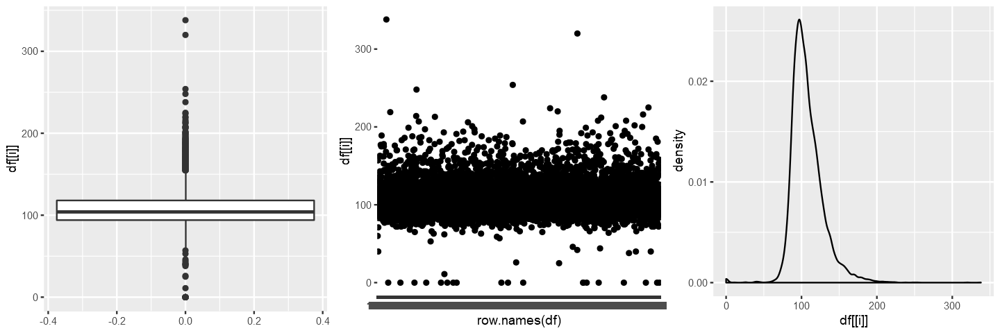

[1] "revenue"


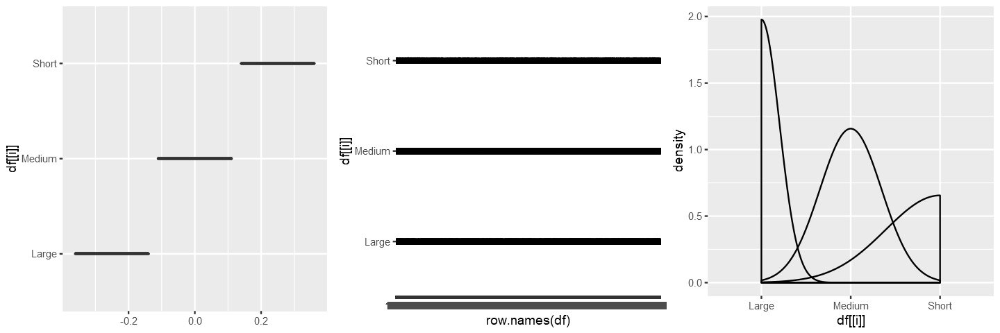

[1] "sw_lang_en"


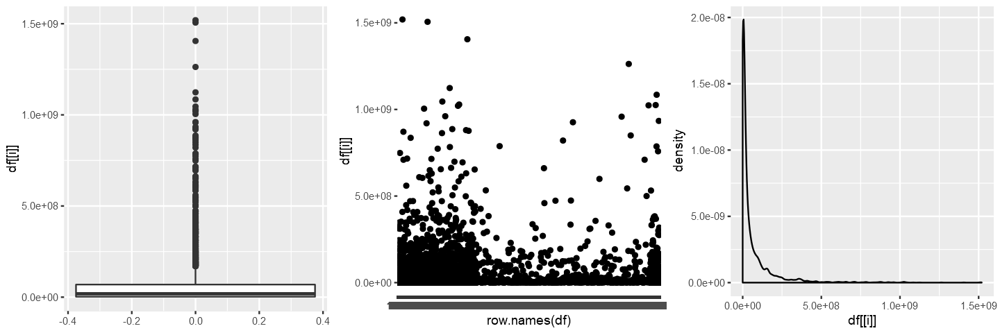

[1] "sw_web_presence"


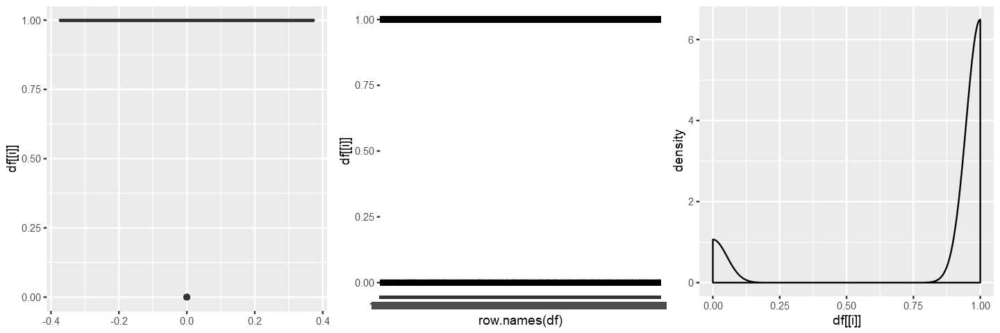

[1] "sw_has_poster"


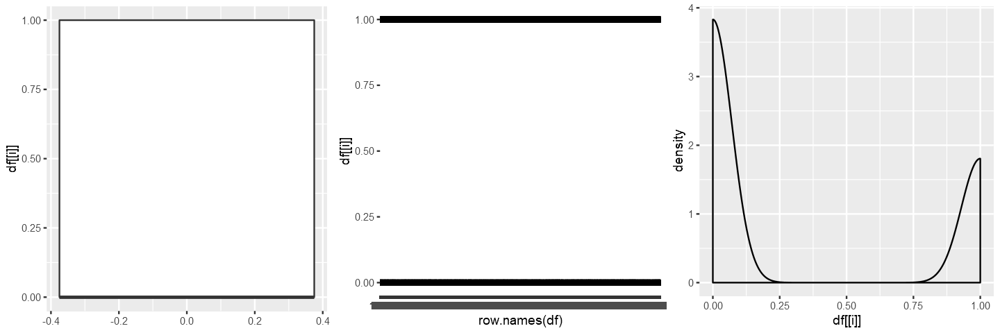

[1] "sw_tagline"


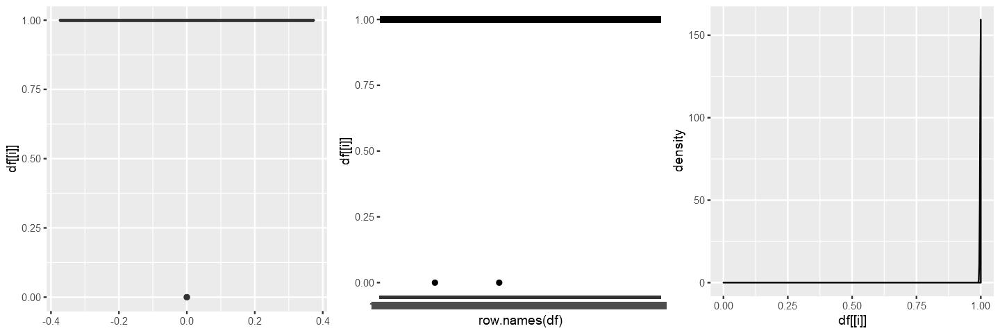

[1] "keyword_cnt"


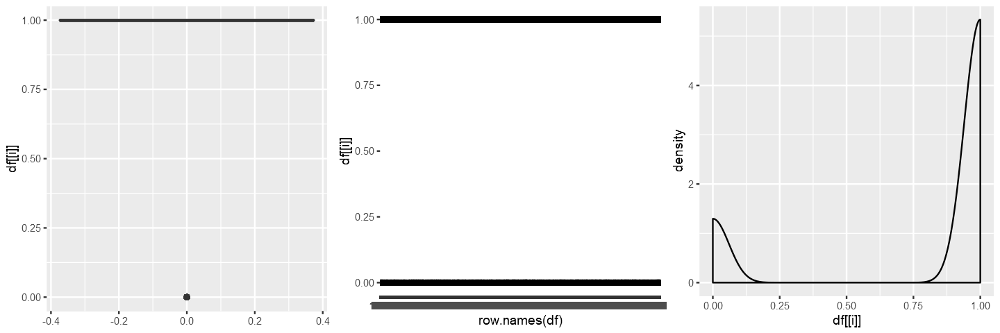

[1] "release_year"


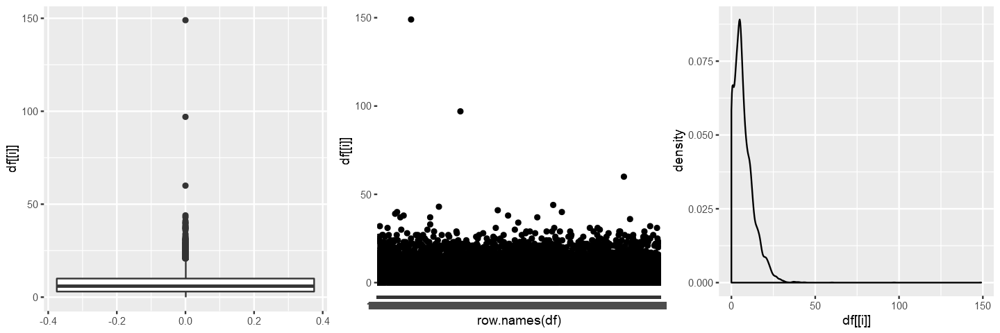

[1] "release_month"


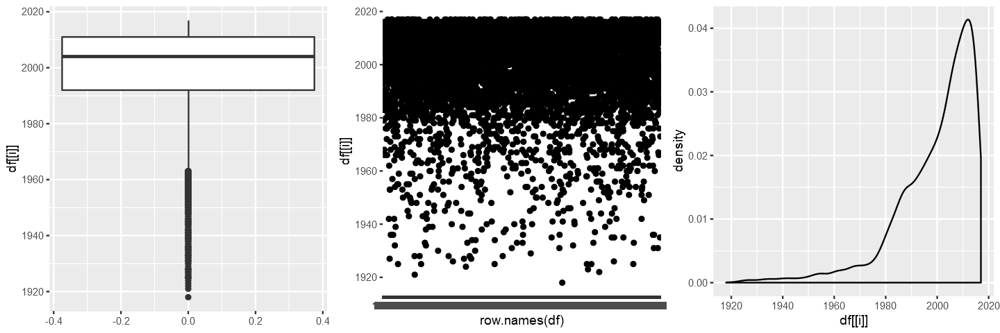

[1] "high_release_month"


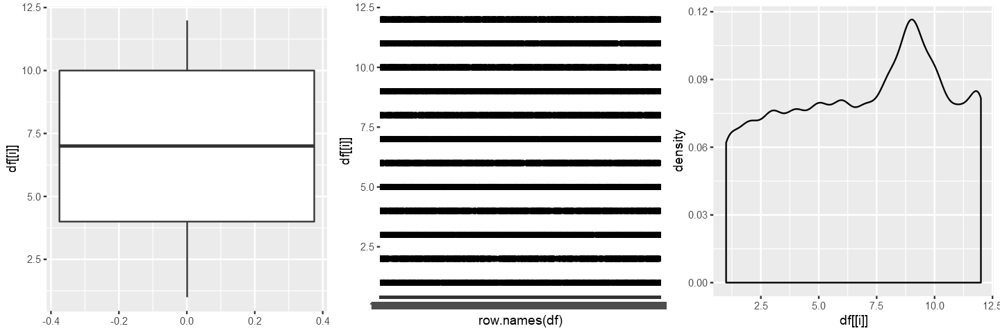

[1] "release_day"


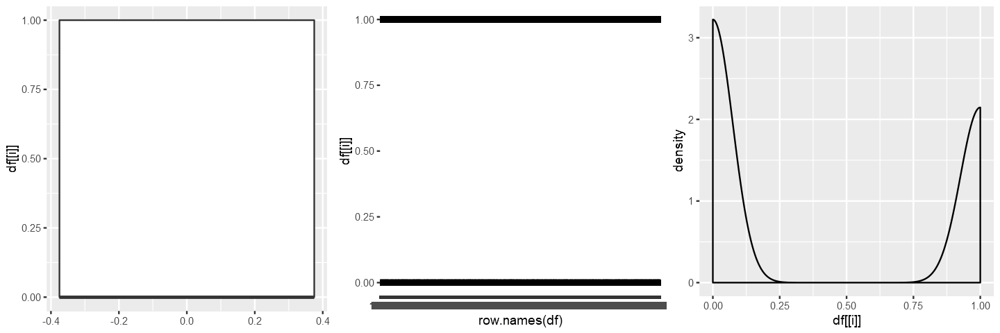

[1] "seasonality"


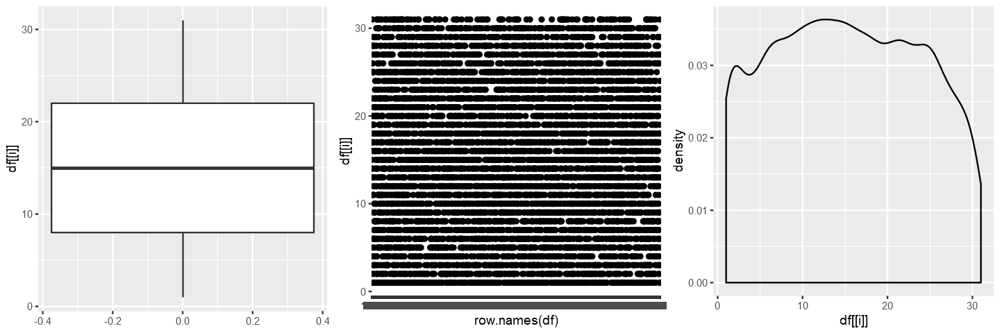

[1] "sw_collection"


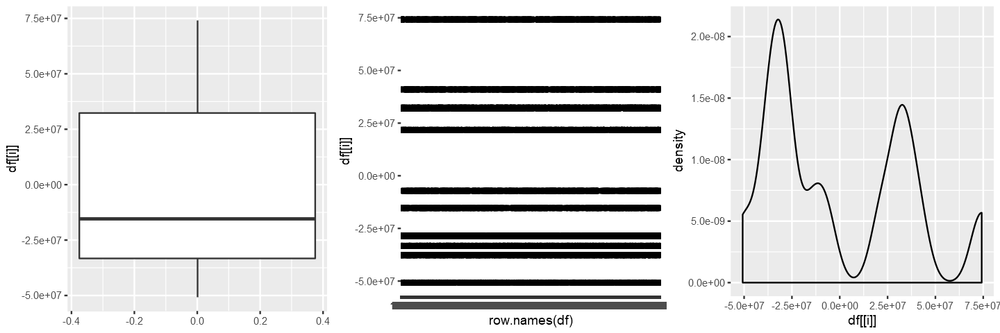

[1] "producers_cnt"


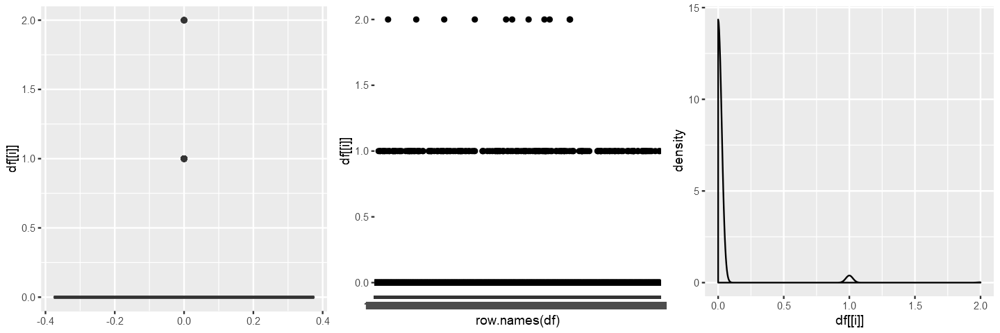

[1] "countries_cnt"


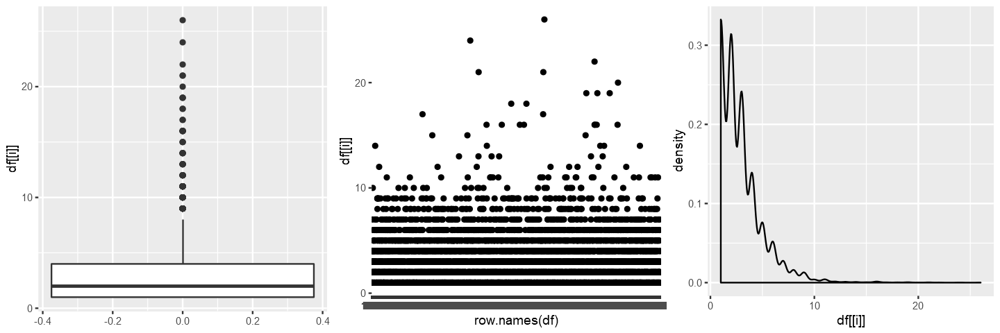

[1] "lang_US"


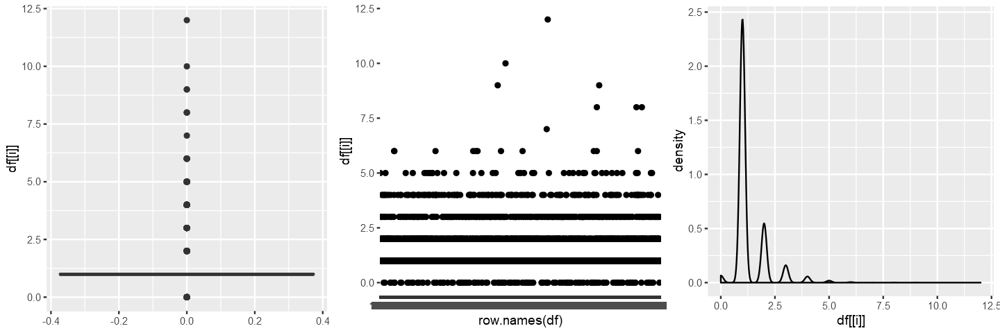

[1] "lang_FR"


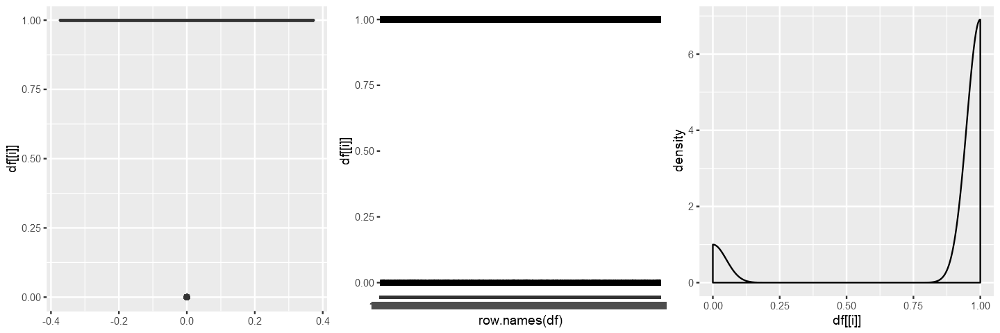

[1] "lang_RU"


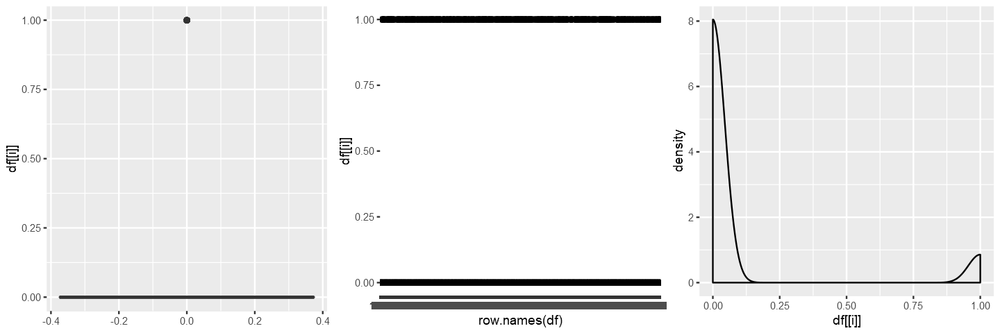

[1] "lang_ES"


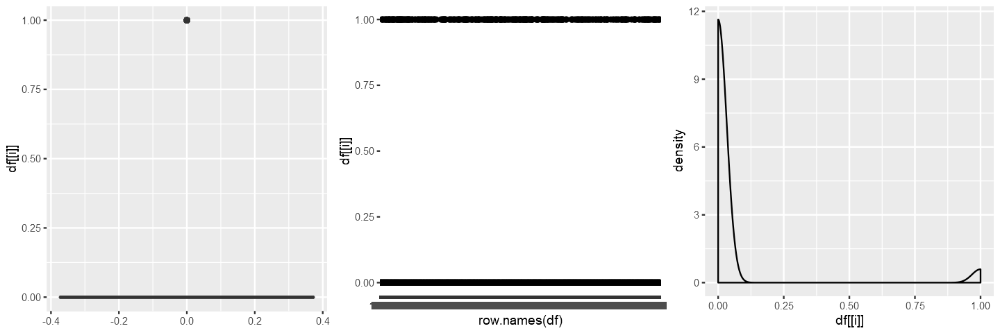

[1] "lang_JA"


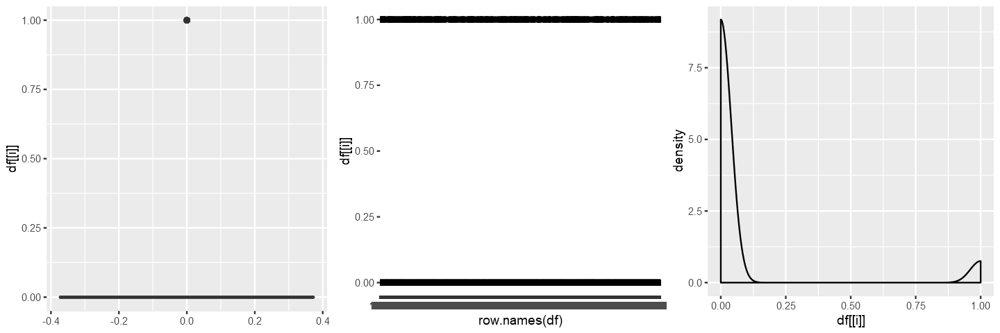

[1] "keywords_cnt"


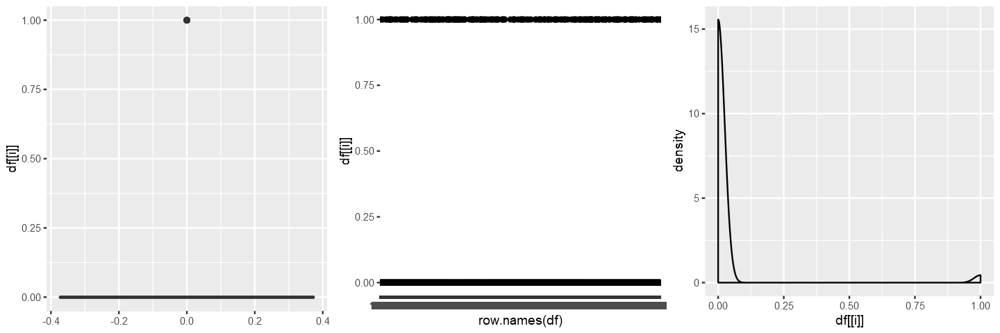

[1] "actor0_movies_cnt"


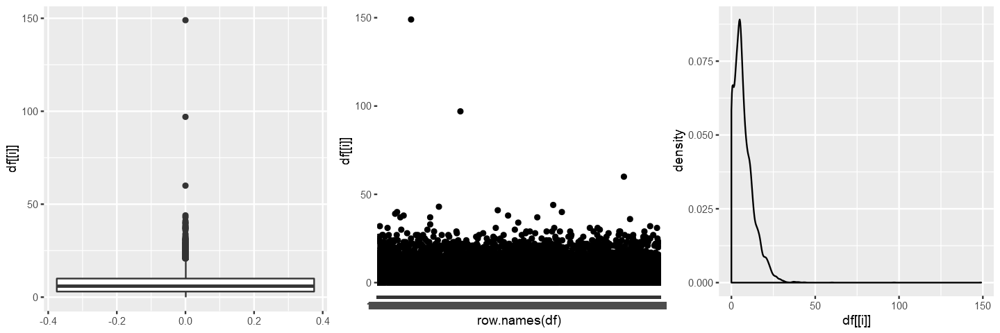

[1] "actor0_movies_5y_cnt"


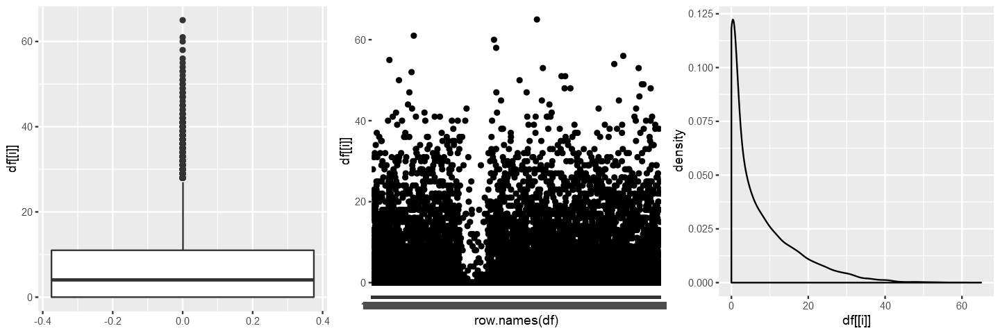

[1] "actor1_movies_cnt"


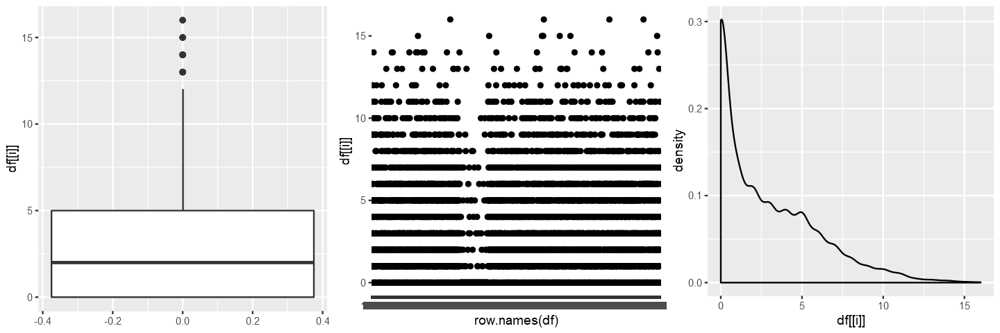

[1] "actor1_movies_5y_cnt"


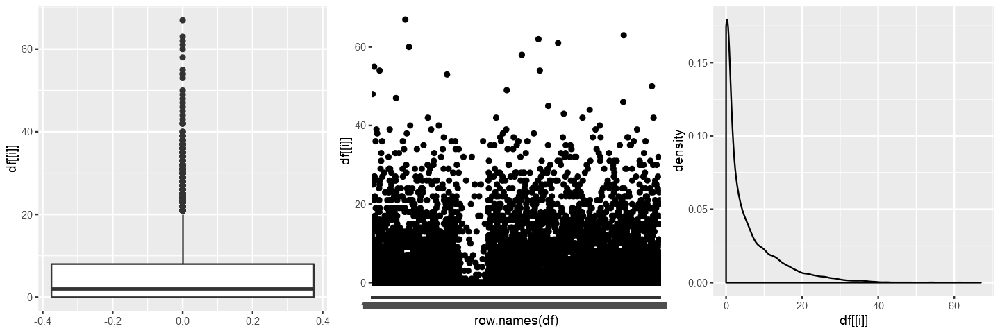

[1] "actor2_movies_cnt"


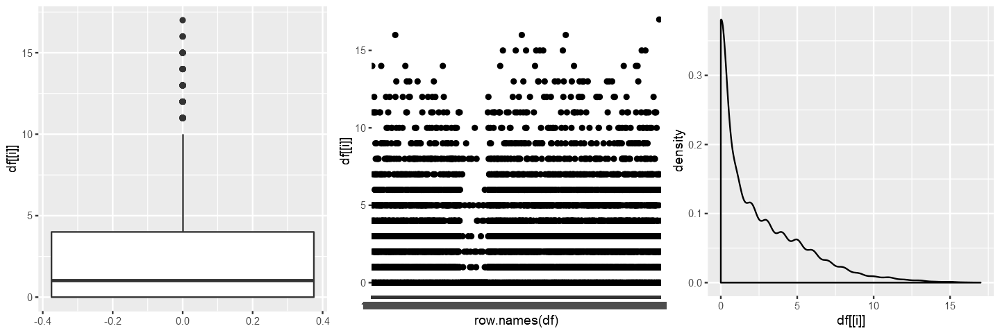

[1] "actor2_movies_5y_cnt"


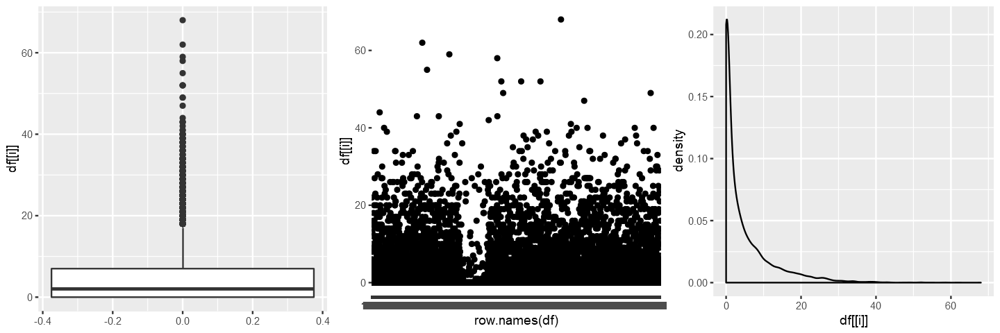

[1] "sw_female_actor0"


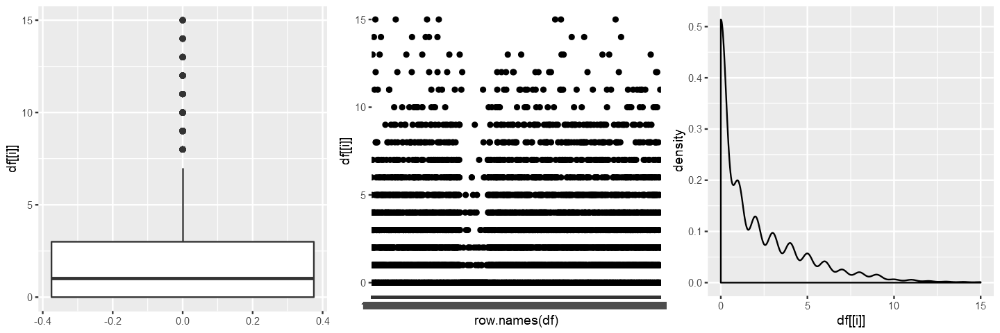

[1] "sw_female_actor1"


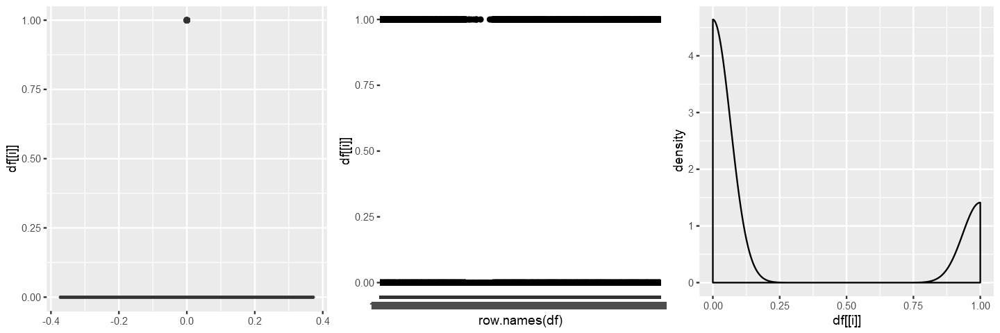

[1] "sw_female_actor2"


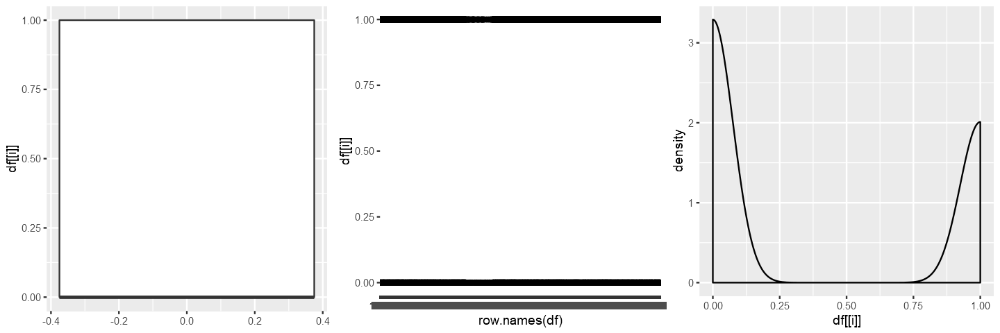

[1] "sw_male_actor0"


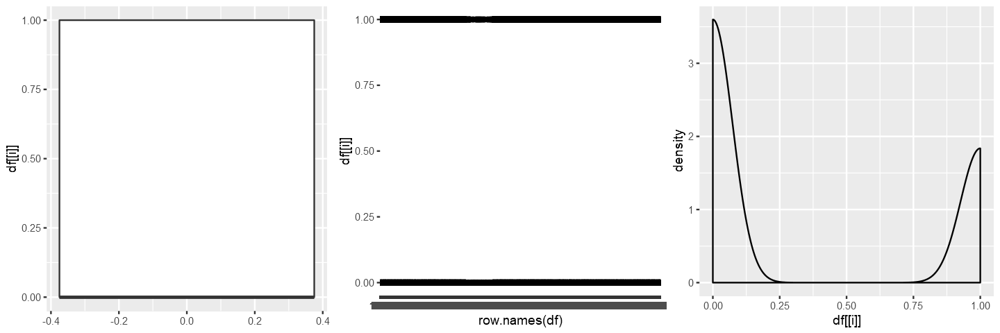

[1] "sw_male_actor1"


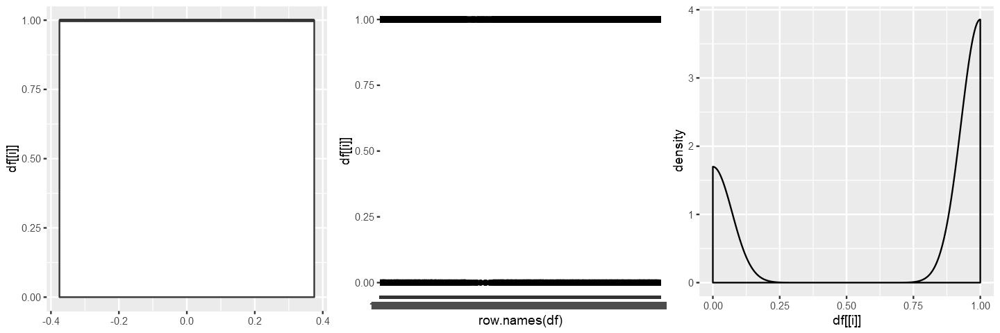

[1] "sw_male_actor2"


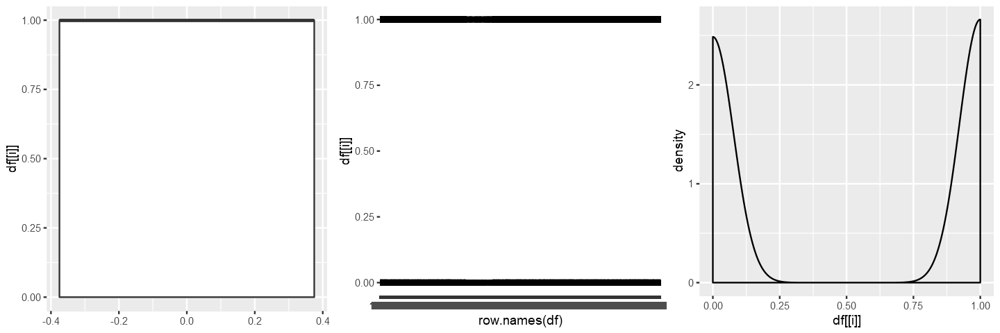

[1] "actor0_prev_revenue"


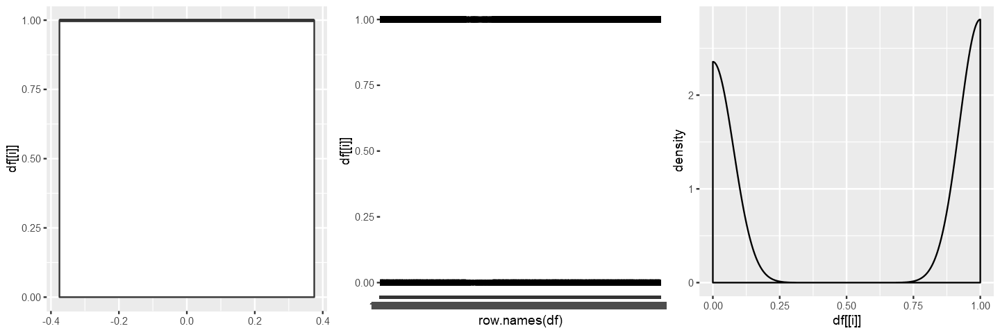

[1] "actor1_prev_revenue"


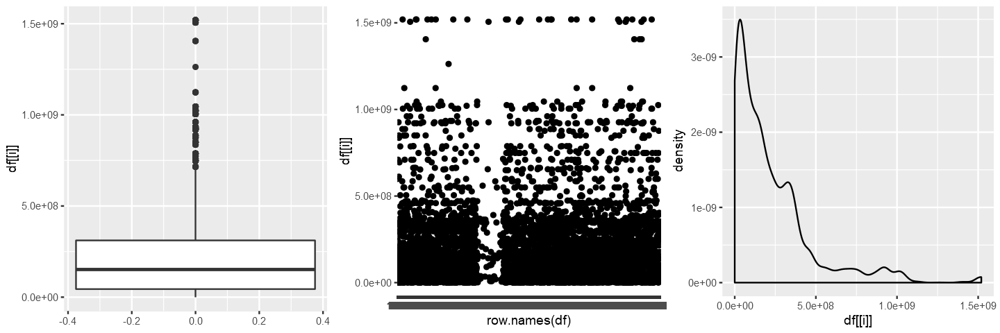

[1] "actor2_prev_revenue"


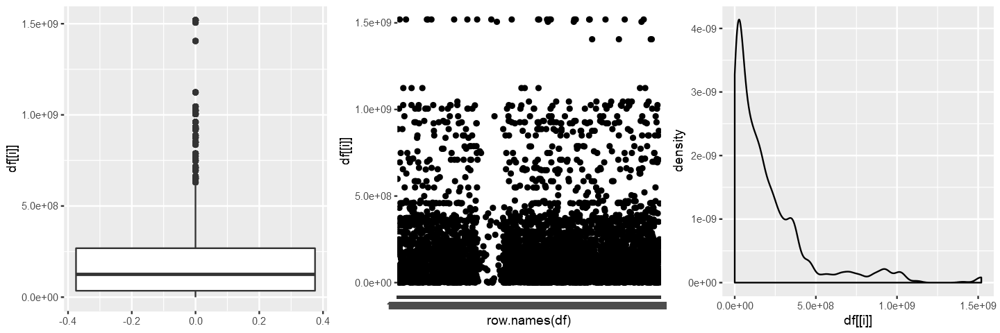

[1] "director_movies_cnt"


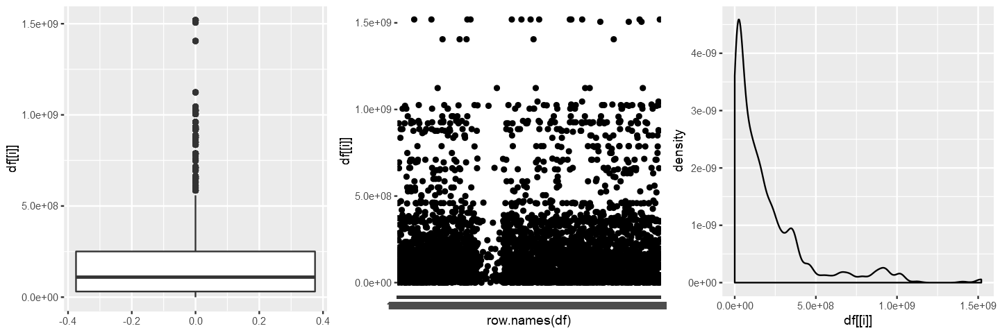

[1] "director_movies_5y_cnt"


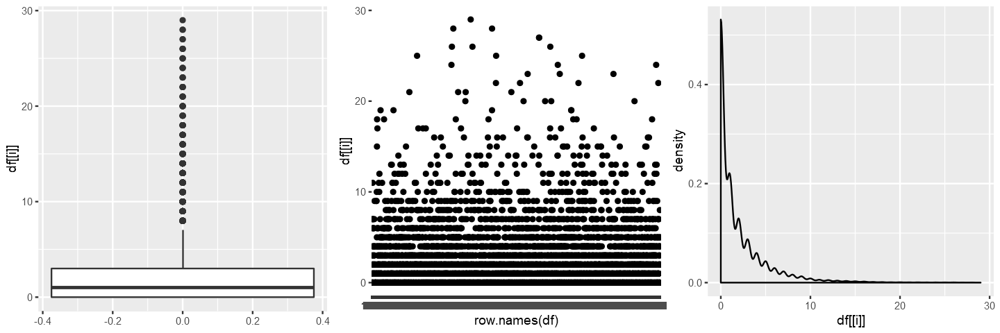

[1] "genre_adventure"


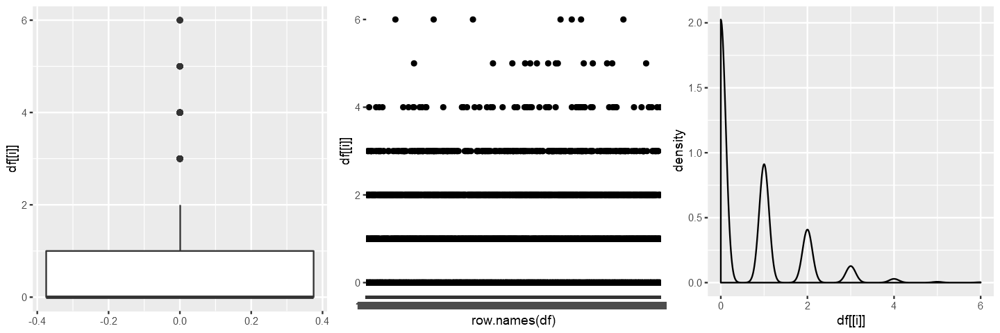

[1] "genre_fantasy"


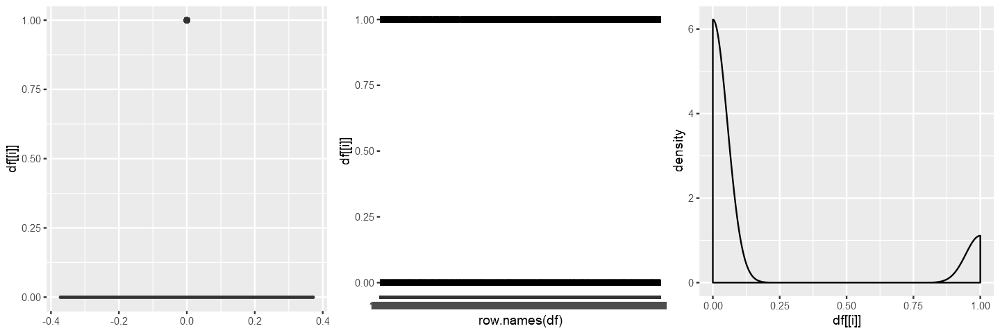

[1] "genre_animation"


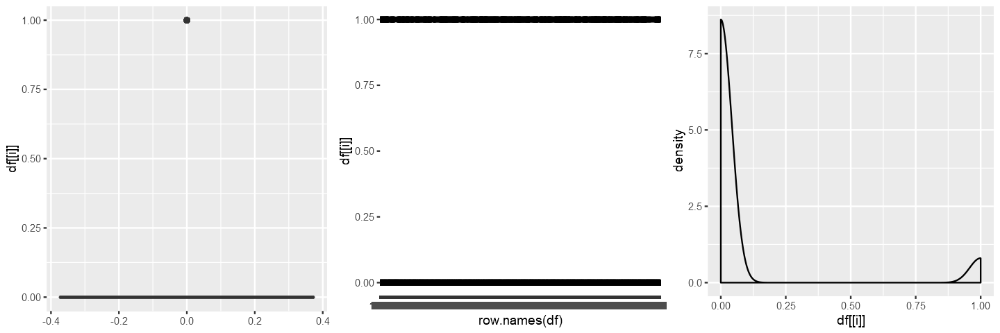

[1] "genre_drama"


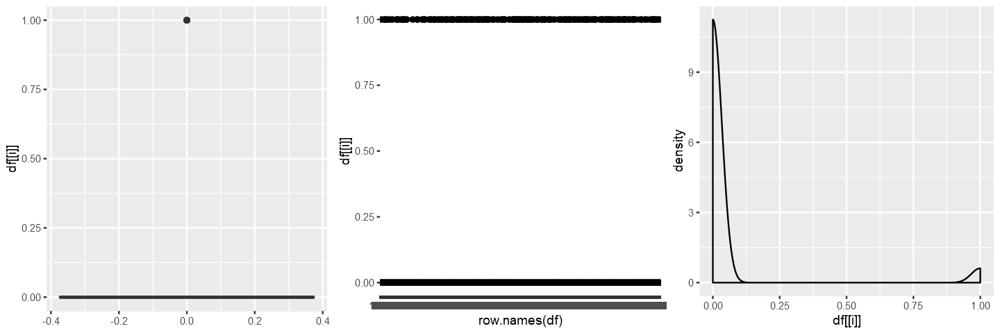

[1] "genre_horror"


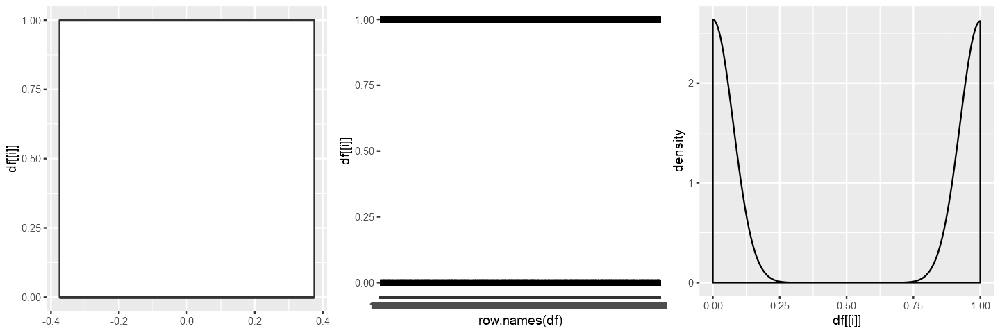

[1] "genre_action"


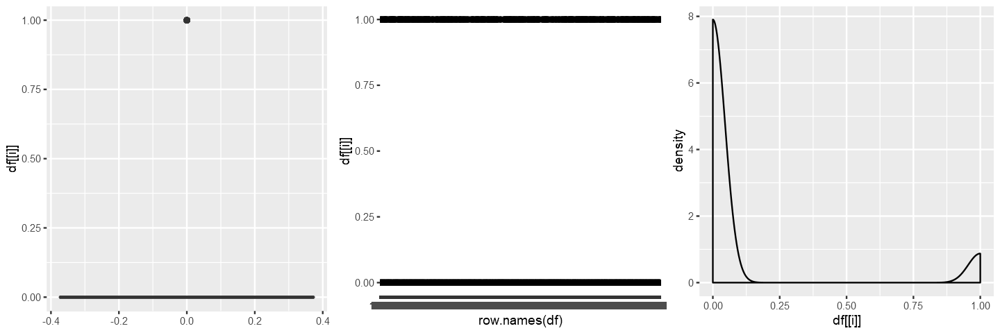

[1] "genre_comedy"


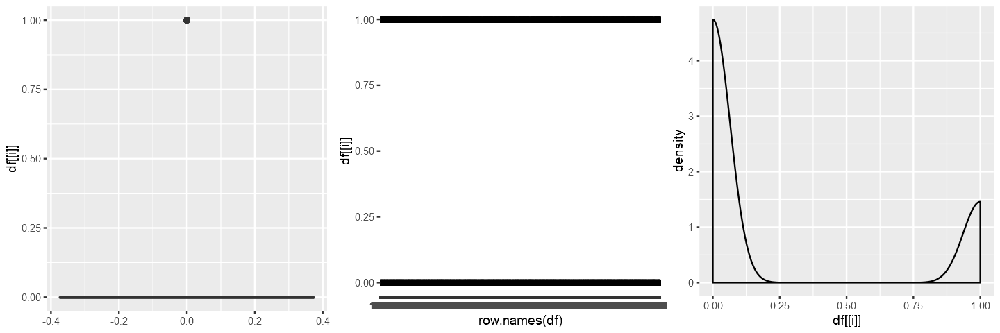

[1] "genre_history"


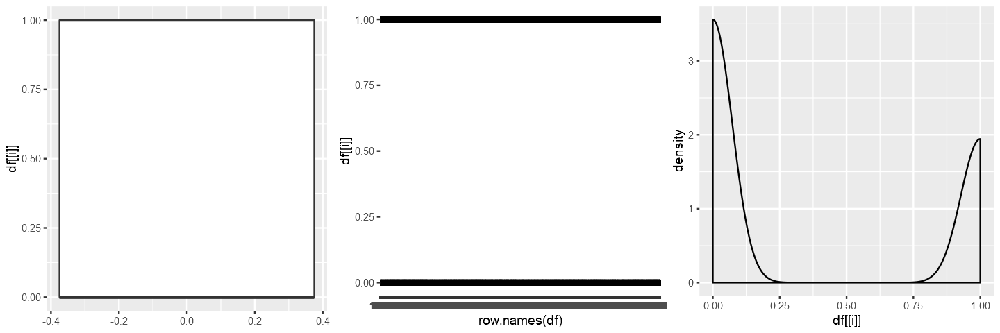

[1] "genre_western"


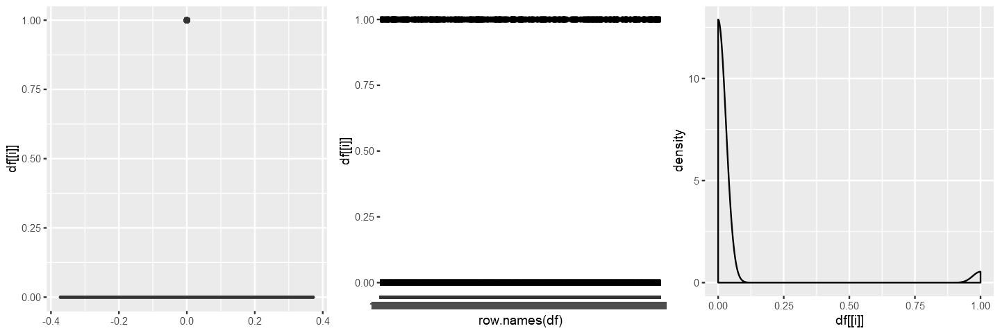

[1] "genre_thriller"


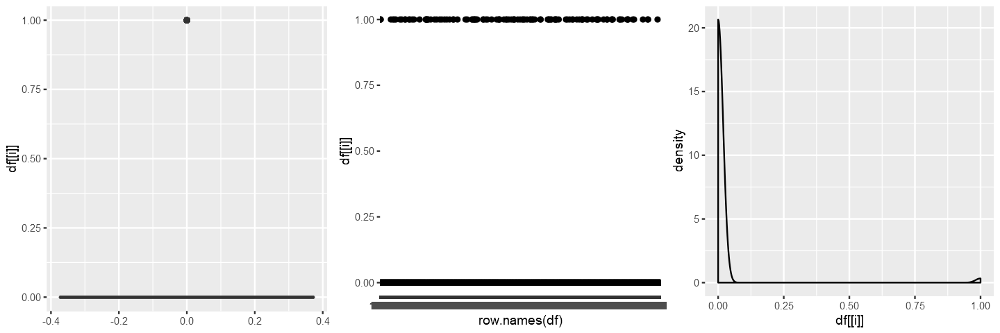

[1] "genre_crime"


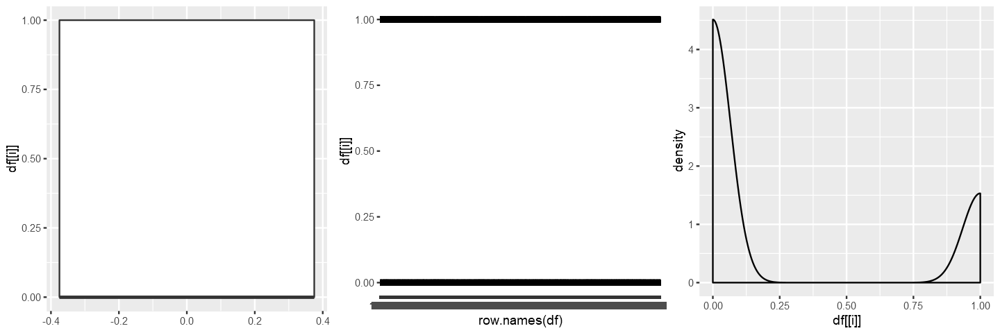

[1] "genre_documentary"


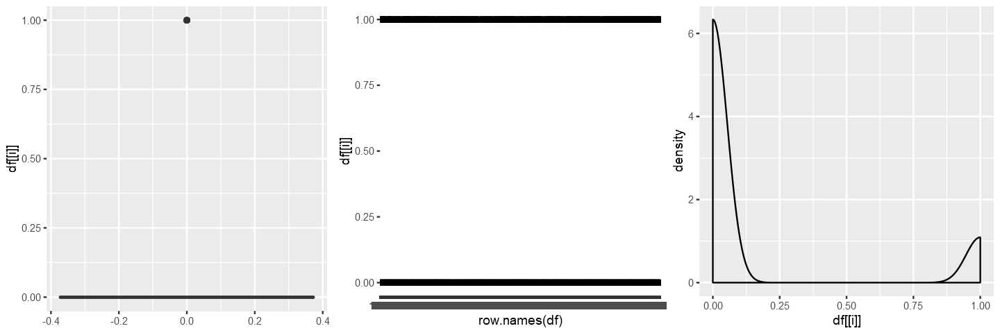

[1] "genre_science_fiction"


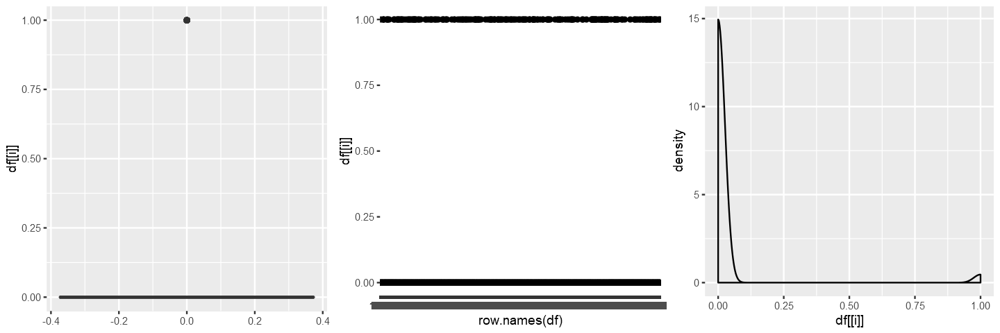

[1] "genre_mystery"


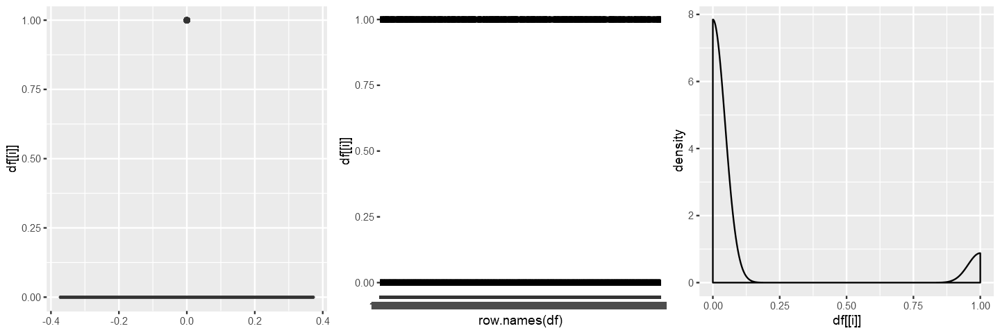

[1] "genre_music"


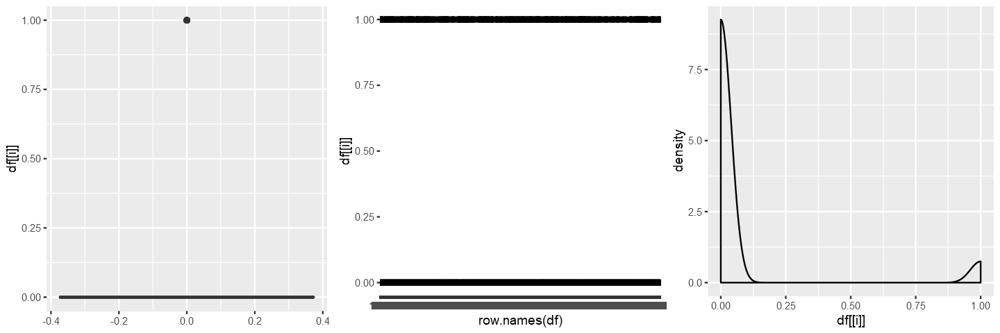

[1] "genre_romance"


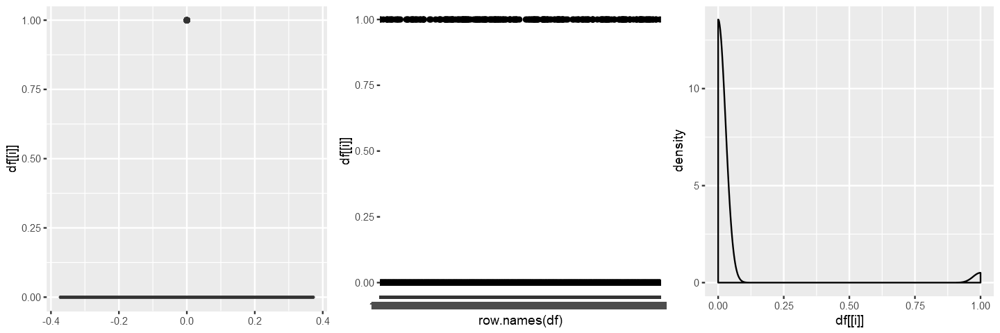

[1] "genre_family"


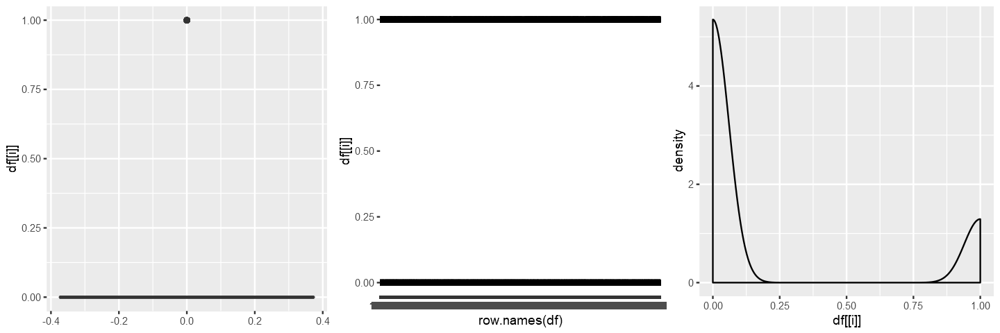

[1] "genre_war"


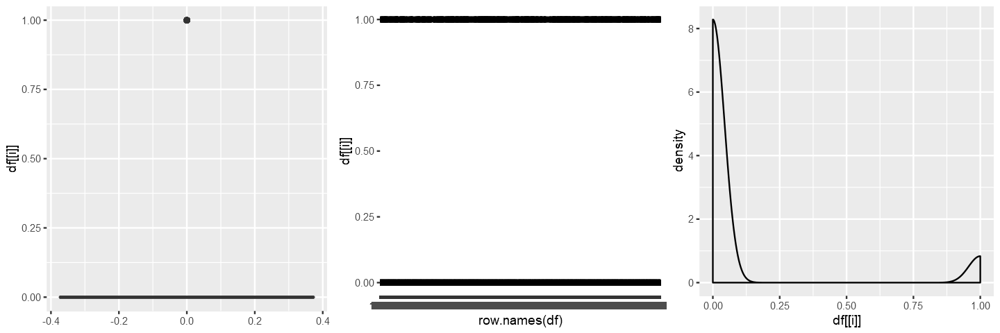

[1] "genre_foreign"


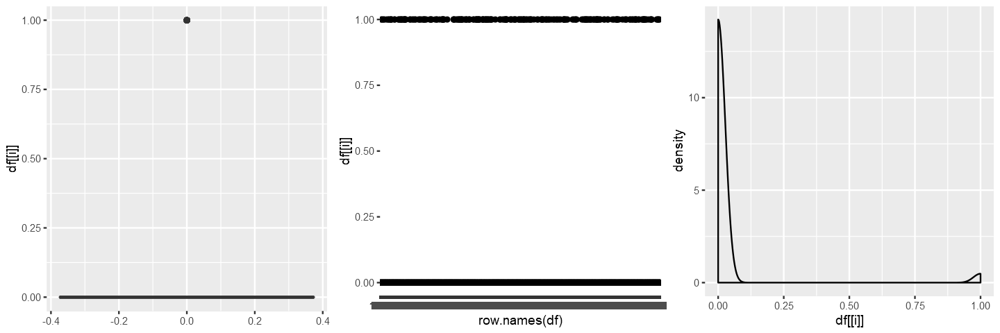

[1] "depart_Art"


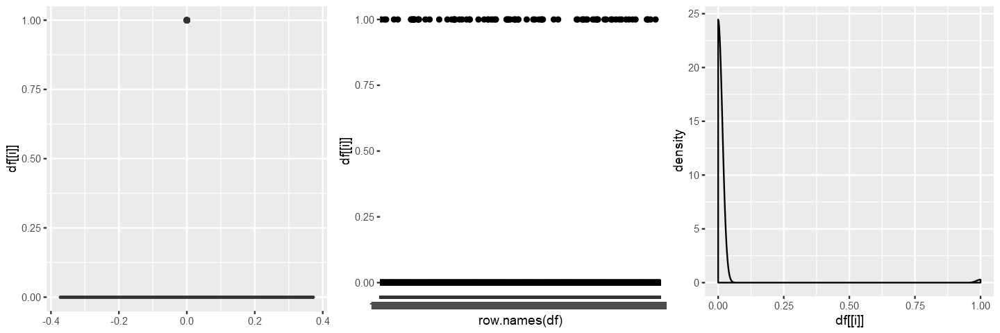

[1] "depart_Camera"


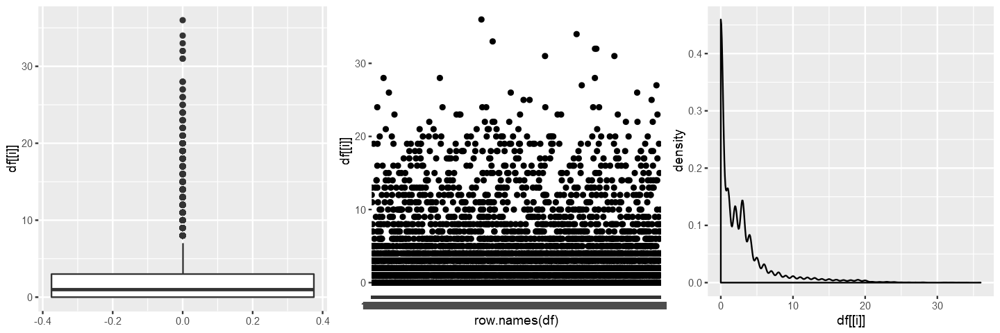

[1] "depart_Crew"


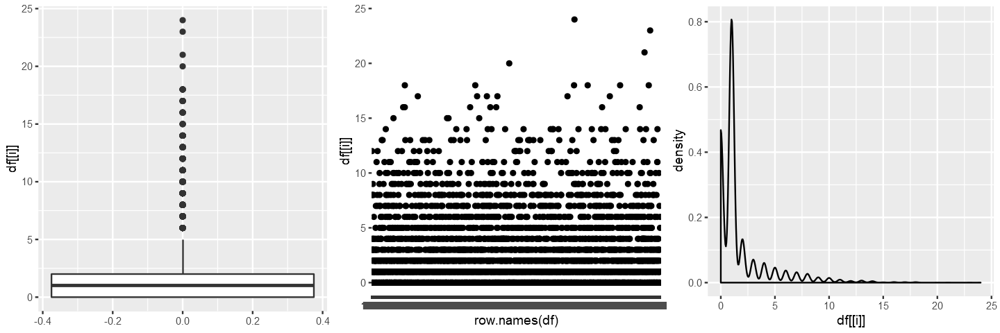

[1] "depart_Custom_Mkup"


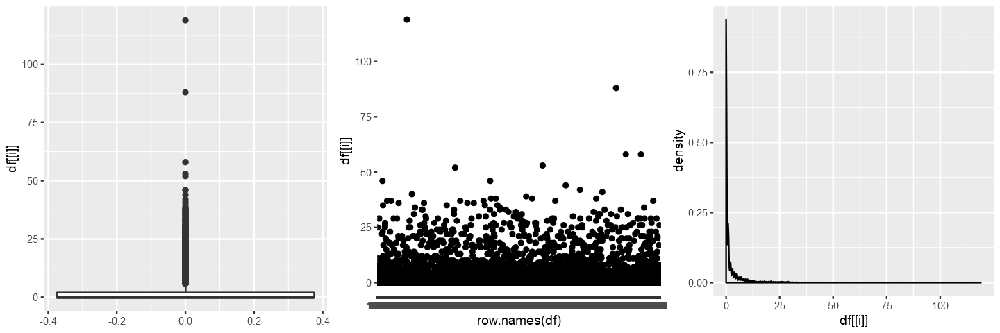

[1] "depart_Directing"


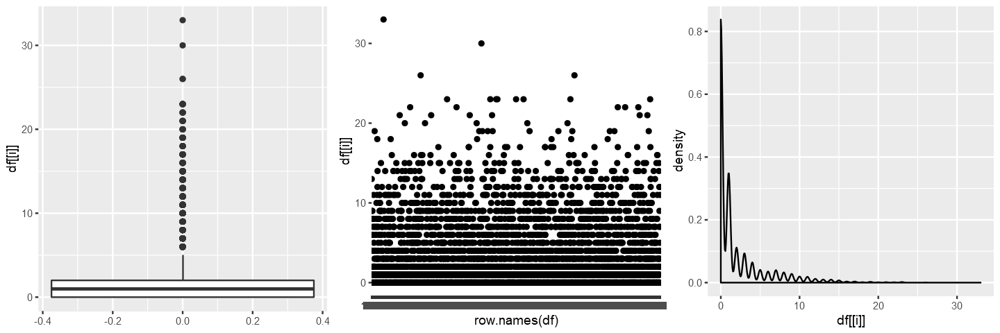

[1] "depart_Editing"


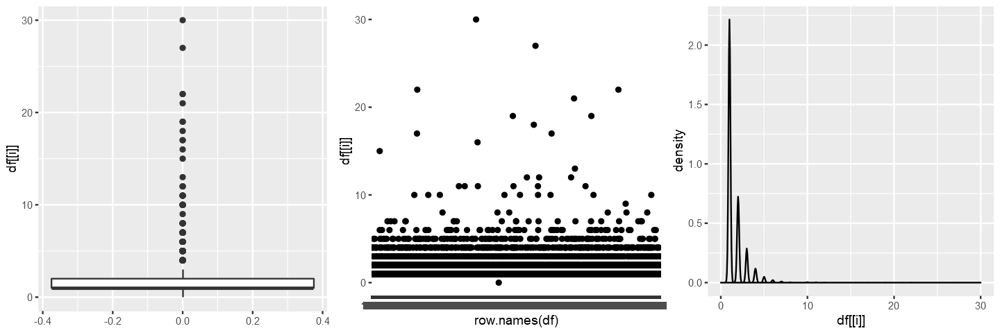

[1] "depart_Lighting"


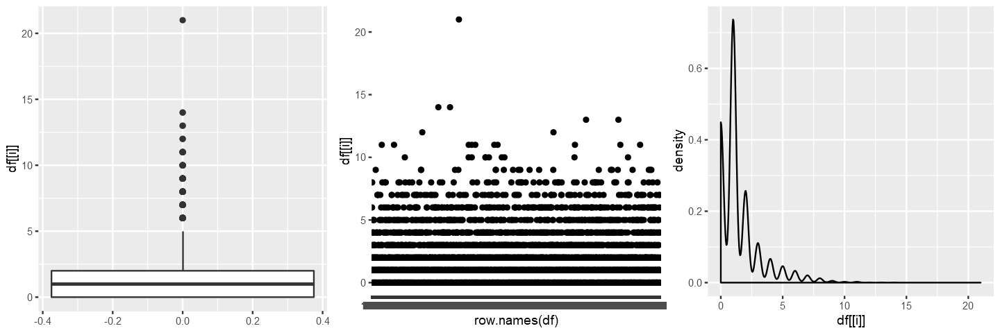

[1] "depart_Production"


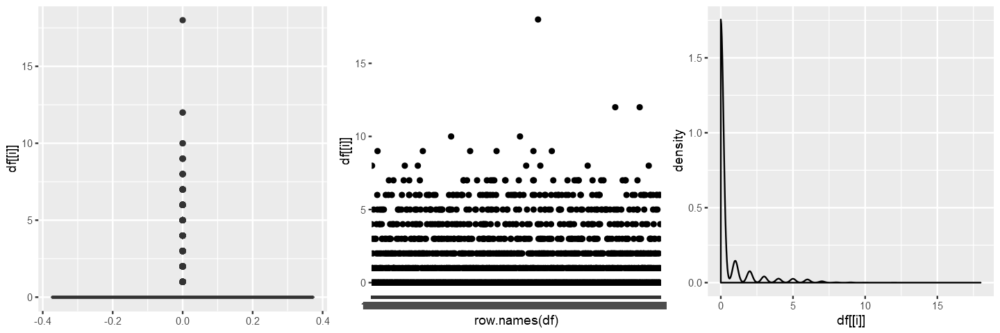

[1] "depart_Sound"


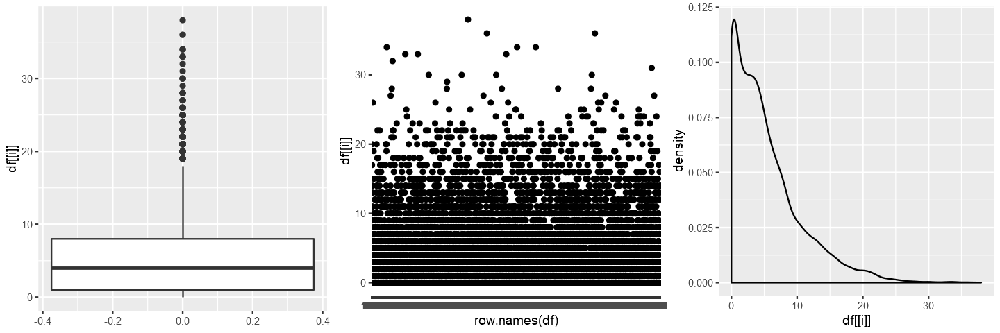

[1] "depart_Visual_Effects"


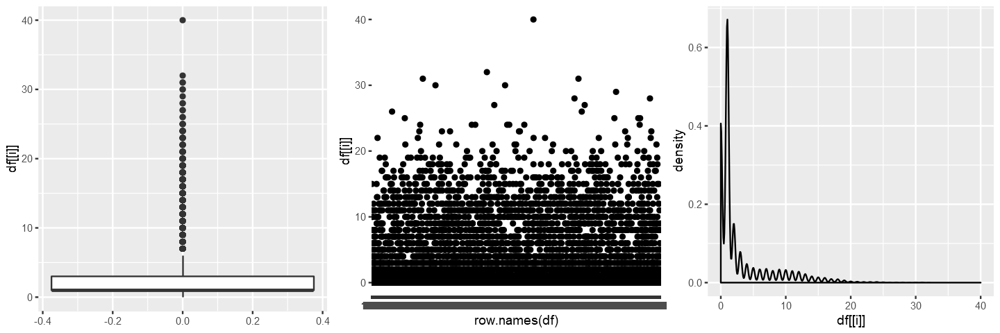

[1] "depart_Writing"


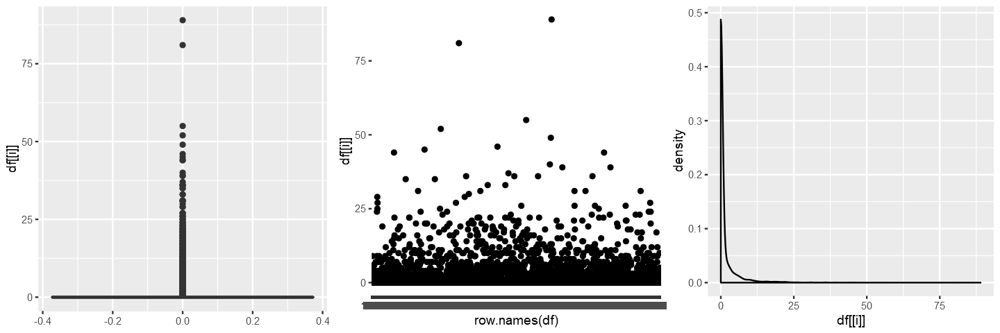

[1] "depart_Art_female"


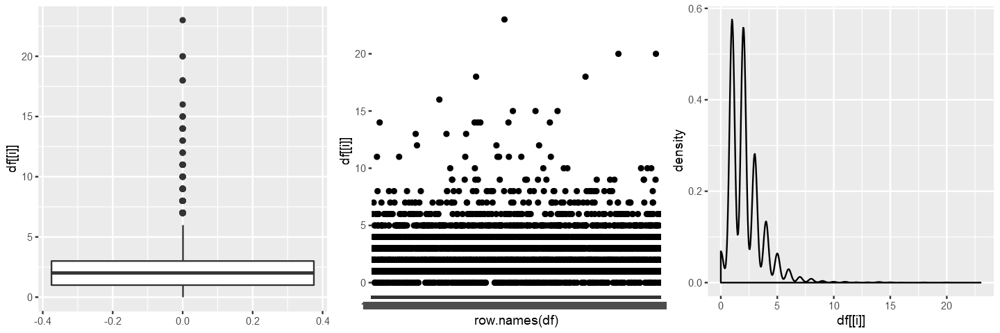

[1] "depart_Camera_female"


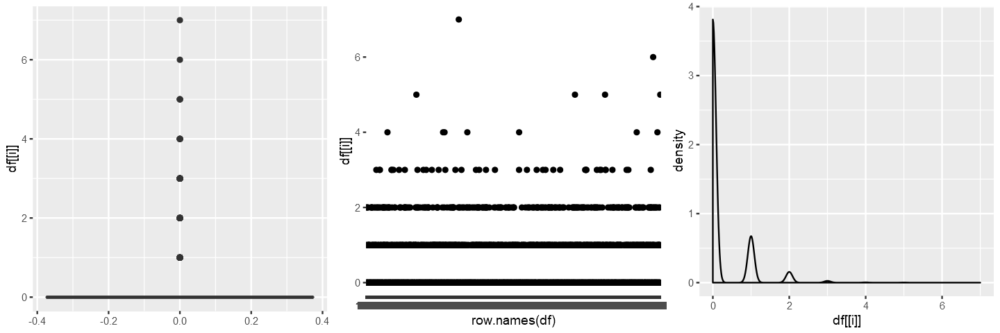

[1] "depart_Crew_female"


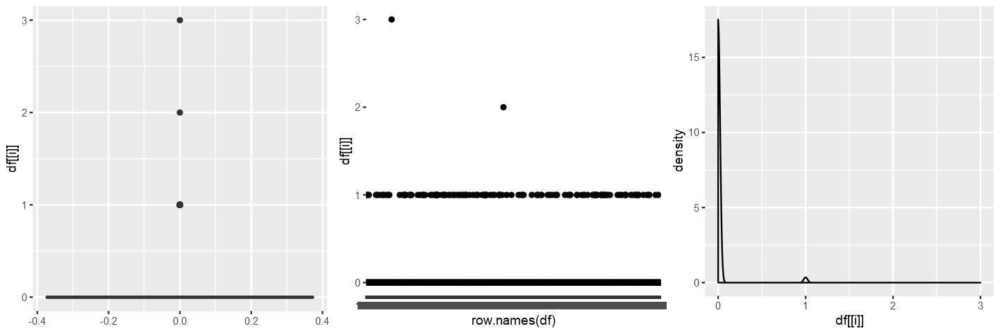

[1] "depart_Custom_Mkup_female"


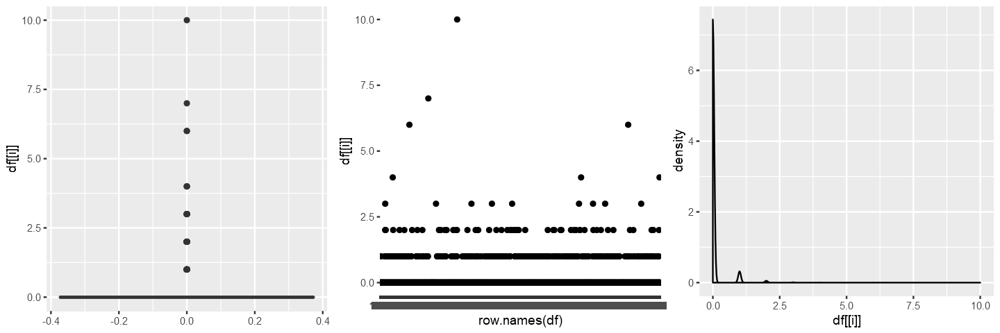

[1] "depart_Directing_female"


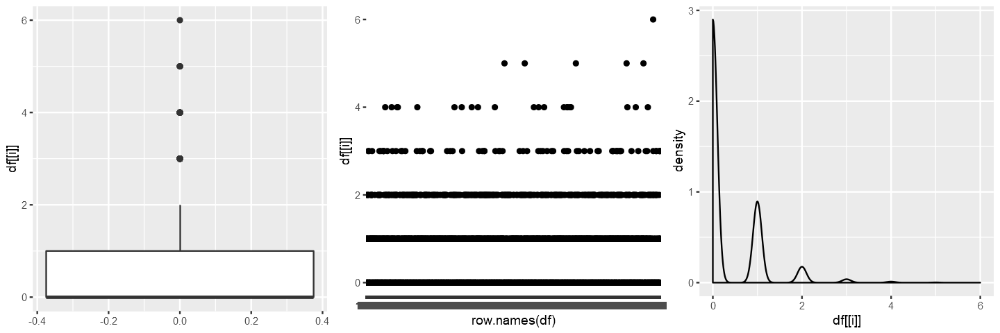

[1] "depart_Editing_female"


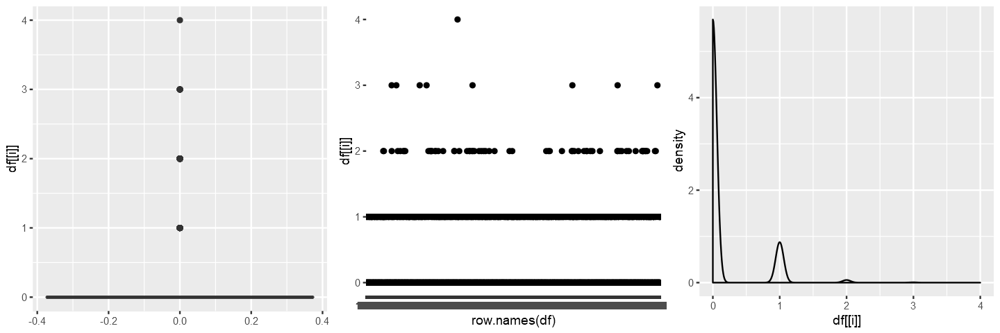

[1] "depart_Lighting_female"


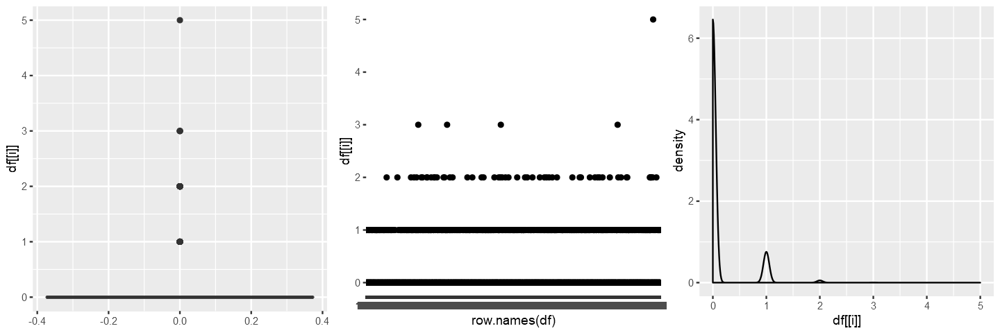

[1] "depart_Production_female"


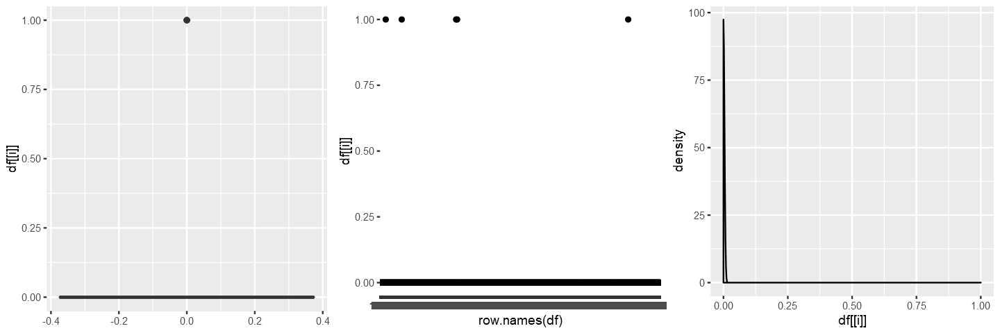

[1] "depart_Sound_female"


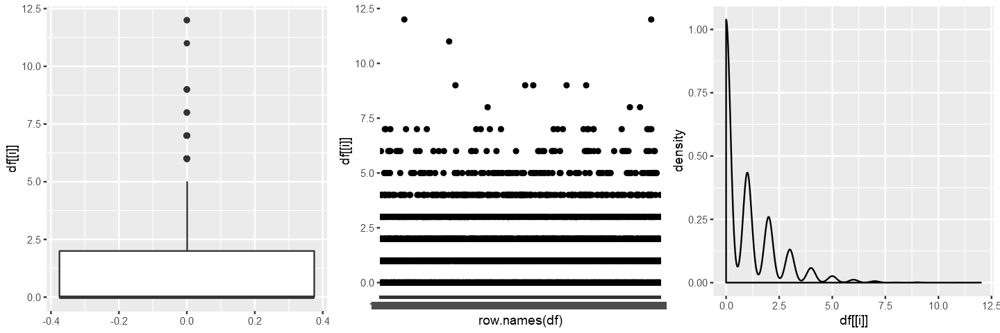

[1] "depart_Visual_Effects_female"


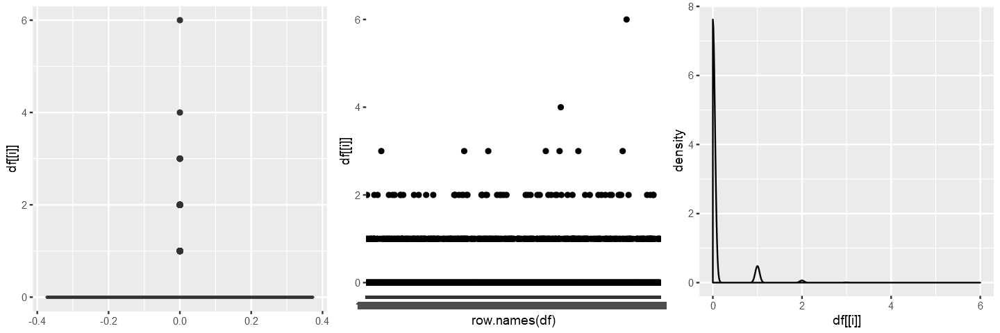

[1] "depart_Writing_female"


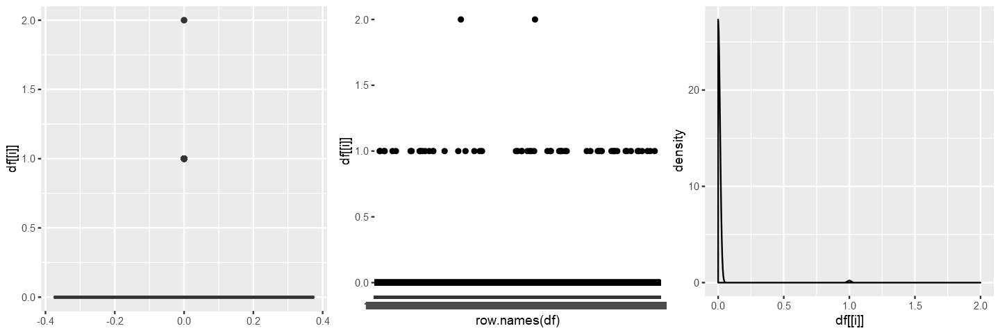

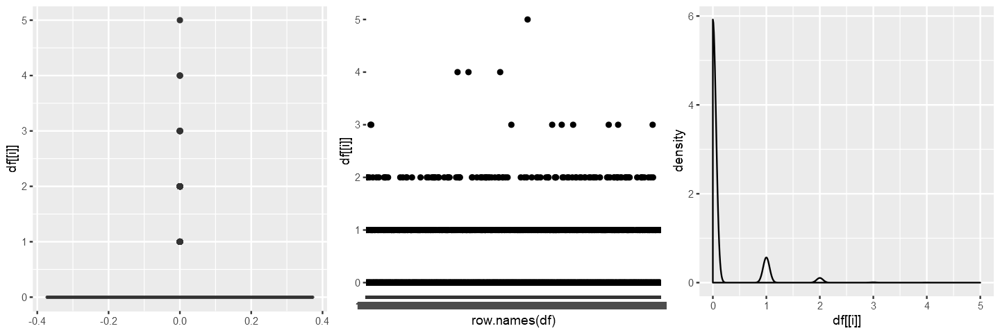

In [12]:
options(repr.plot.width = 12, repr.plot.height = 4)
for(i in names(df)) {
    print(i)
    p1 <- ggplot(data=df) + geom_boxplot(aes(y=df[[i]]))
    p2 <- ggplot(data=df) + geom_point(aes(x=row.names(df),y=df[[i]]))
    p3 <- ggplot(data=df) + geom_density(aes(df[[i]]))
    grid.arrange(p1, p2,p3, nrow = 1)
}

In [13]:
if (!require("ggplot2")) install.packages("ggplot2")


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


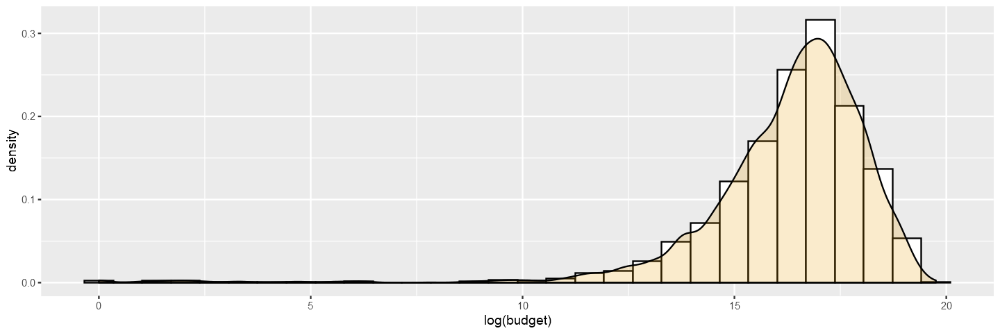

In [14]:
# Budget
ggplot(movies_ff, aes(x=log(budget))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 5, repr.plot.height = 3)

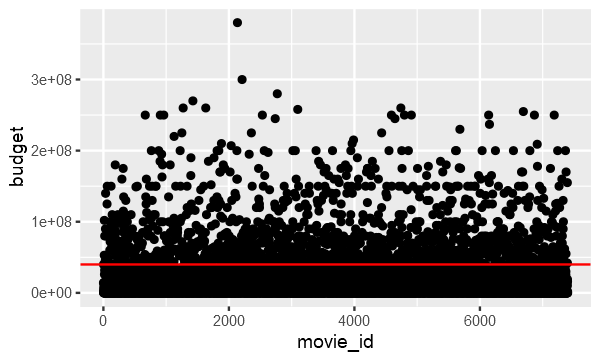

In [15]:
#Budget Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=budget)) +
    geom_hline(yintercept = 40000000 ,color="red")

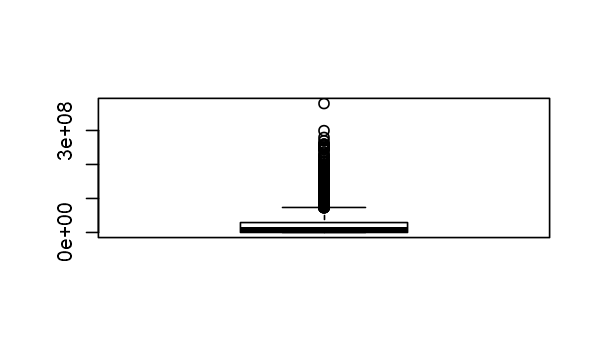

In [16]:
out_budget <- boxplot(movies_ff$budget)
options(repr.plot.width = 5, repr.plot.height =10)

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


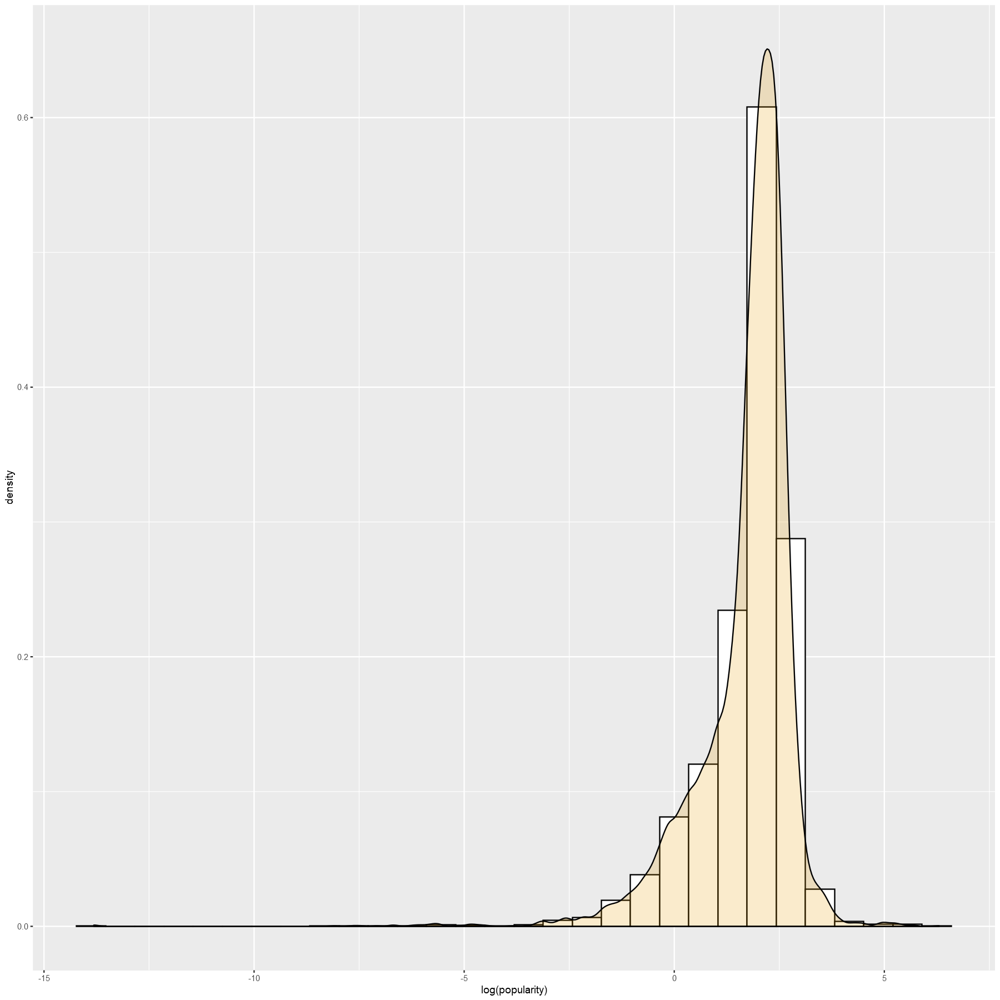

In [138]:
#Popularity
ggplot(movies_ff, aes(log(popularity))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

In [133]:
#movies category
movies_lang <- movies_ff %>% 
    mutate(orig_lang2=ifelse(original_language %in% c("en","fr","in","ru","es","ja"),original_language,'other'))

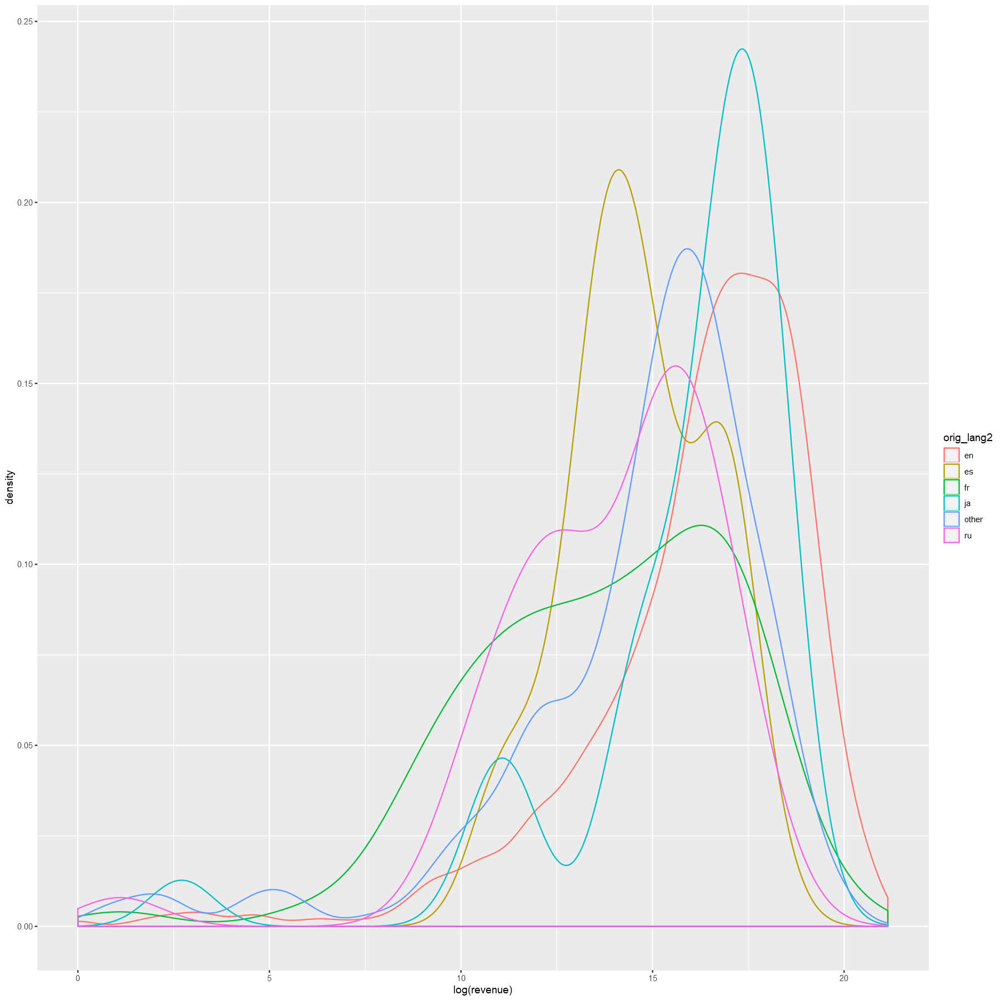

In [134]:
ggplot(data=movies_lang) +
    geom_density(aes(log(revenue), group=orig_lang2, color=orig_lang2))

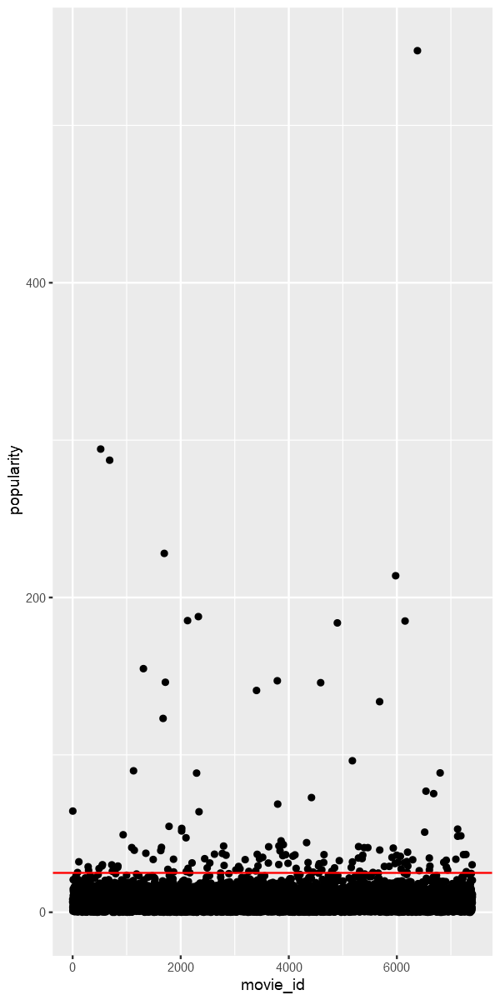

In [18]:
#Popularity Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=popularity)) +
    geom_hline(yintercept = 25 ,color="red")

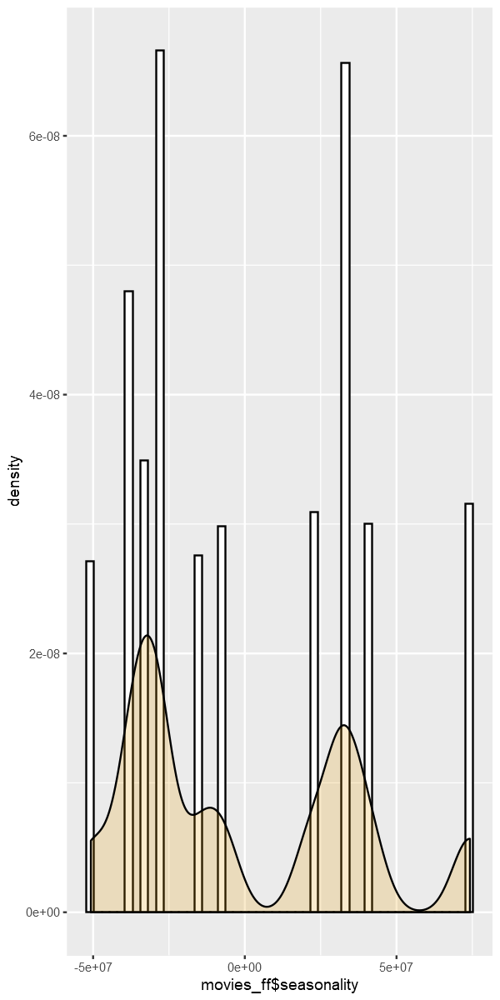

In [37]:
# seasonality
ggplot(movies_ff, aes(x=movies_ff$seasonality)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

In [113]:
movie.time <- movies_ff %>% 
    mutate(release_year,release_month) %>%
    group_by(release_year,release_month) %>%
    summarise(n=n(),revenue_mean=mean(revenue,na.rm=T)) %>%
    select(release_year,release_month,n,revenue_mean) %>%
    filter(between(release_year,1985,2016))

movie.time$revenue_mean <- ifelse(is.na(movie.time$revenue_mean),0,movie.time$revenue_mean)

movie.ts <- ts(movie.time$revenue_mean, start = c(1995, 1), end=c(2016,12), frequency = 12)

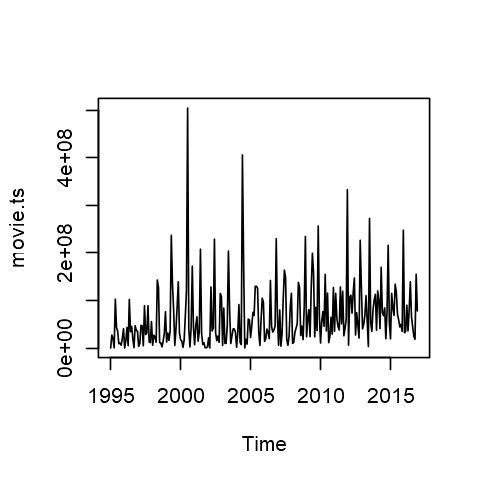

In [114]:
plot(movie.ts)

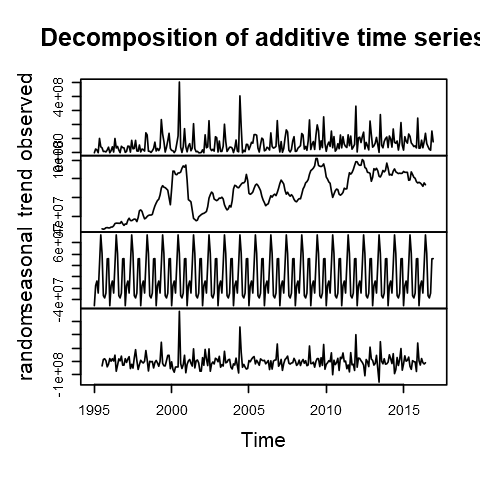

In [115]:
plot(decompose(movie.ts))

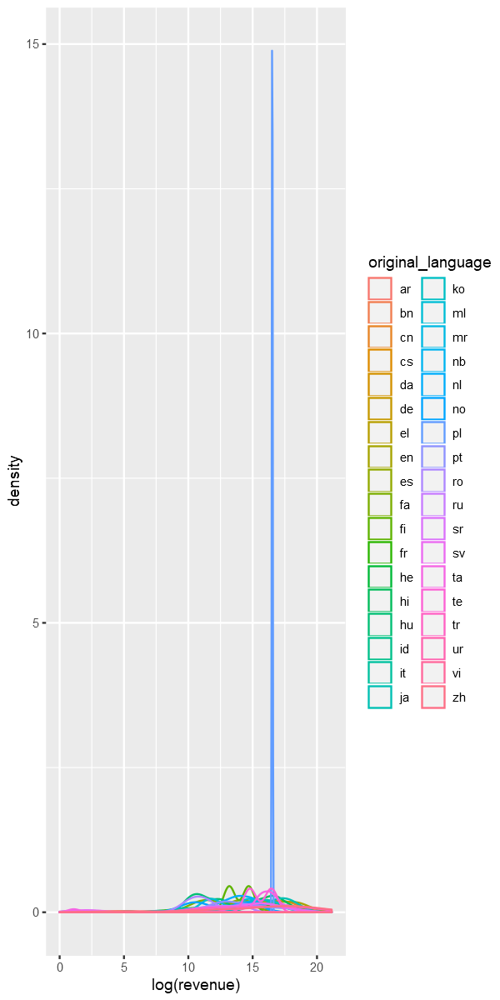

In [28]:
ggplot(data=movies_ff) +
    geom_density(aes(log(revenue), group=original_language, color=original_language))

In [39]:
exploreData <- function(data=data, y=NULL, rn=NULL, factorSize=10, dir="report", debug=FALSE, ...) {

  get_computer_type <- function(){
    # check if current R client is running on PC or on the server
    if (Sys.info()[1] == "Windows") {
      computer.type = "pc"
    } else if (Sys.info()[1] == "Linux") {
      computer.type = "server"
    }
    return(computer.type)
  }

  whatVarType <- function(var) {
    suppressWarnings(if (var=="integer" | var=="numeric") {
      return(1)
    } else if (var=="factor" | var=="character") {
      return(2)
    } else if (var=="Date" | "POSIXct" %in% var[[1]]) {
      return(3)
    } else {
      return(0)
    })
  }

  drawHistogram <- function(imgname=imgname, x=x) {
    d=stats::density(x, kernel = "gaussian",na.rm=TRUE)
    breakstar=(max(x,na.rm=TRUE) -min(x,na.rm=TRUE))/d$bw
    h=graphics::hist(x, breaks=breakstar)
    graphics::plot(h,main="",xlab=imgname)
    yfit<-seq(min(x,na.rm=TRUE),max(x,na.rm=TRUE),length=40)
    ffit<-stats::dnorm(yfit,mean=mean(x,na.rm=T),sd=stats::sd(x,na.rm=T))
    ffit <- ffit*diff(h$mids[1:2])*length(x)
    lines(yfit, ffit, col="blue", lwd=2)
  }

  drawFakeGraph <- function(imgname=imgname) {
    graphics::plot.window(xlim = c(0,0),ylim = c(0,0))
  }

  drawBars <- function(imgname=imgname, x=x) {
    graphics::plot(x)
  }

  drawGraphOne <- function(imgname=imgname, numVar=x, vartype=1) {
    if(vartype==1) {
      drawHistogram(imgname,numVar)
    } else if(vartype==2) {
      drawBars(imgname,numVar)
    } else {
      drawFakeGraph(imgname)
    }
  }

  getContinuousStats <- function(x) {
    N <- length(x)
    n <- length(x[which(is.na(x)==FALSE)])
    pct <- formatC(n/N * 100)
    nmiss <- length(x[which(is.na(x)==TRUE)])
    npct <- formatC(nmiss/N *100)
    ma <- mean(x, na.rm=TRUE)
    s <- stats::sd(x, na.rm=TRUE)
    me <- formatC(stats::median(x, na.rm=TRUE))
    q1 <- formatC(stats::quantile(x,1/4, na.rm=TRUE))
    q3 <- formatC(stats::quantile(x,3/4, na.rm=TRUE))
    mn <- formatC(min(x, na.rm=TRUE))
    mx <- formatC(max(x, na.rm=TRUE))
    html <- paste("<div class='Cell' style='align: top;'> <u>Data type</u>: Continuous <p> <u>Data length</u>: ",n ,"/", N, " (", pct, "%) <br> <u>Missing</u>: ",
                  nmiss, " (", npct, "%)<p> <u>Mean</u>: ", formatC(ma), "\t <u>StdDev</u>: ", formatC(s), "<br><u>Median</u>: ",me,
                  "\t <u>IQR</u>: ", q1, "-", q3, "<br><u>Min</u>: ", mn, "\t <u>Max</u>: ", mx, "</div>")
    return(html)
  }

  getCategortyStats <- function(x) {
    N <- length(x)
    n <- length(x[which(is.na(x)==FALSE)])
    pct <- formatC(n/N * 100)
    nmiss <- length(x[which(is.na(x)==TRUE)])
    npct <- formatC(nmiss/N *100)
    l <- levels(x)
    s <- summary(x)
    htm <- "<ul>"
    if (length(l) < 5) {
      for (lv in l) {
        htm <- paste(htm, "<li><u>", lv, "</u>: ", s[[lv]], "</li>")
      }
      htm <- paste(htm,"</ul>")
    }
    html <- paste("<div class='Cell'> <u>Data type</u>: Categorical Data <p> <u>Data length</u>: ",n, "/", N, " (", pct, "%) <br> <u>Missing</u>: ",
                  nmiss, " (", npct, "%) <p> <u>Number of levels</u>: ", length(l), "<br>", htm, "</div>")
    return(html)
  }

  getDatesStats <- function(x) {
    N <- length(x)
    n <- length(x[which(is.na(x)==FALSE)])
    pct <- formatC(n/N * 100)
    nmiss <- length(x[which(is.na(x)==TRUE)])
    npct <- formatC(nmiss/N *100)
    s <- summary(x)
    html <- paste("<div class='Cell'> <u>Data type</u>: Date <p> <u>Data length</u>: ",n, "/", N, " (", pct, "%) <br> <u>Missing</u>: ",
                  nmiss, " (", npct, "%) <p> <u>Min date</u>: ", min(x, na.rm=T), "<br><u>Max date</u>:",max(x, na.rm=T) , "</div>")
    return(html)
  }

  getStats <- function(numVar=x, vartype=1) {
    if(vartype==1) {
      html <- getContinuousStats(numVar)
    } else if(vartype==2) {
      html <- getCategortyStats(numVar)
    } else if (vartype==3) {
      html <- getDatesStats(numVar)
    } else {
      html <- "<div class='Cell'></div>"
    }
    return(html)
  }

  getOutliers <- function(x) {
    bp <- graphics::boxplot(x,plot=FALSE)
    return(bp$out)
  }

  getOutlierGraph <- function(x) {
    #  mod <- tryCatch({
    outl <- getOutliers(x)
    df <- data.frame(x=x, cl=1)
    if(length(outl)>0) {
      df$cl[which(df$x %in% outl)] <- 2
    }
    #pl <- stats::scatter.smooth(df$x,col=df$cl)
    pl <- tryCatch({
      stats::scatter.smooth(df$x,col=df$cl,xlab="index")
    }, warning = function(w) {
      n <- "warning!"
    }, error = function(e) {
      n <- "error!"
    }, finally = {
      graphics::plot(df$x ~ row.names(df),col=df$cl,xlab="index")
    })
    ma <- mean(x, na.rm=TRUE)
    s <- stats::sd(x, na.rm=TRUE)
    graphics::abline(h=ma-(2*s), col="red", lty=2)
    graphics::abline(h=ma+(2*s), col="red", lty=2)
    #  }, error = function(e) {
    #    pl <- drawFakeGraph("none")
    #  })
    return(pl)
  }

  getScatterGraph <- function(df=data,x,y,dtype=1) {
    #  mod <- tryCatch({
    if(dtype==1) {
      pl <- ggplot2::ggplot(df) + ggplot2::geom_smooth(ggplot2::aes(x=data[[x]], y=data[[y]]), method="loess") + ggplot2::xlab(x) + ggplot2::ylab(y)
    } else {
      pl <- ggplot2::ggplot(df) + ggplot2::geom_boxplot(ggplot2::aes(y=data[[x]], color=data[[y]])) + ggplot2::xlab(x) + ggplot2::ylab(y) + ggplot2::labs(color=y)
    }
    return(pl)
  }

  getOutliersHtml <- function(imgname=imgname, x=x, srcdir=srcdir) {
    bp <- getOutliers(x)
    if (length(unique(bp)) > 10) {
      xtrm <- paste("There are ", length(unique(bp)), " outlier values")
    } else if (length(unique(bp)) == 0) {
      xtrm <- "No outlier values found"
    } else {
      xtrm <- paste(formatC(unique(bp)), collapse=', ' )
    }
    imgsrc = paste(paste0(srcdir,"/fig/"),imgname, "_2.png",sep="")
    html <- paste0("<div class='Cell'><img class='origimg' src='",imgsrc,"' height='150' width='250'><br> <u>Outlier values</u>: <br> ", xtrm, "</div>")
    return(html)
  }
  ################## Prepare for the report ###################
  #report <- paste(mydir,"/report",sep="")

  ################## Check for values for rn ##################
  if(!is.null(rn)) {
    if(length(rn)!=ncol(data)) {
      message("the value of the 'rn' argument was avoided because it does not have the same number of columns of the dataframe")
      rn <- NULL
    }
    xname <- rn
    names(xname) <- names(data)
  } else {
    xname <- NULL
  }

  report <- dir
  if (!file.exists(report)) {
    dir.create(report)
  }
  fig <- paste(report,"/fig",sep="")
  if (!file.exists(fig)) {
    dir.create(fig)
  }
  if (get_computer_type()=="pc") {
    srcdir <- paste0(getwd(),"/",report)
  } else {
    #srcdir <- paste0("file_show?path=",getwd(),"/",report)
    srcdir <- paste0("/view/",getwd(),"/report")
  }
  # determine which columns are integer
  int_col <- which(sapply(data, is.integer))
  int_col <- c(int_col,(which(sapply(data, is.numeric))))
  mi <- vector()
  # find only those integers with less than 10 unique values and convert to factor
  for (li in int_col) {
    if (length(unique(data[,li])) < factorSize) {
      mi <- c(mi,li)
      if (is.factor(data[,li]) == FALSE) {
        data[,li] <- factor(data[,li])
      }
    }
  }

  str_col <- which(sapply(data, is.character))
  mi <- vector()
  # find only those integers with less than 10 unique values and convert to factor
  for (li in str_col) {
    mi <- c(mi,li)
    data[,li] <- factor(data[,li])
  }

  # create the html report page
  myhtml <- paste(report,"/report.html",sep="")
  cat("<!DOCTYPE html>
      <html>
      <head>
      <title>Data Visualization</title>
      <meta http-equiv='Content-Type' content='text/html; charset=UTF-8' />
      <link rel='stylesheet' href='http://code.jquery.com/mobile/1.4.5/jquery.mobile-1.4.5.min.css'>

      <script src='http://code.jquery.com/jquery-1.10.2.js'></script>
      <script>
      $(document).ready(function(){
      $('.onetoone').hide();
      });

      $(function() {
      $('.origimg').click(function(e) {
      $('#popup_img').attr('src',$(this).attr('src'));
      $('#myContainer').hide();
      var pos = $(document).scrollTop();
      $('#myContainer').css({'top':pos+20,'left':250, 'position':'absolute', 'border':'1px solid black', 'padding':'0px'});
      $('#myContainer').show();
      });
      $('#myContainer').click(function(e) {
      $('#myContainer').hide();
      });

      $('#myform2').submit(function(e) {
      e.preventDefault();
      });

      $('#onetoone').on('click',function() {
      console.log('onetone button - 1');
      $('#onetoone').hide();
      $('#aslist').show();
      // To show only individual rows:
      $('.Row').hide();
      $('.onetoone').show();
      // then we iterate
      var i = $('.Row').length;
      // Then we iterate
      var nxt = $('#idx').val();
      if (nxt < i & nxt >0) {
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(1)
      }
      console.log('onetone button - 2');
      });

      $('#aslist').on('click',function() {
      console.log('aslist button - 1');
      $('#onetoone').show();
      $('#aslist').hide();
      $('.onetoone').hide();
      $('.Row').show();
      console.log('aslist button - 2');
      });

      $('#less').on('click',function(){
      console.log('less button - 1');
      var i = $('.Row').length;
      var nxt = parseInt($('#idx').val(),10) - 1;
      if (nxt < i & nxt >0) {
      $('#idx').val(nxt)
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(1)
      }
      console.log('less button - 2');
      });

      $('#more').on('click',function(){
      console.log('more button - 1');
      var i = $('.Row').length;
      var nxt = parseInt($('#idx').val(),10) + 1;
      if (nxt < i & nxt >0) {
      $('#idx').val(nxt)
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(i)
      }
      console.log('more button - 2');
      });

      $('#idx').on('change', function(){
      console.log('idx changed - 1');
      var i = $('.Row').length;
      var nxt = $('#idx').val();
      if (nxt < i & nxt >0) {
      $('#idx').val(nxt)
      $('.Row').hide();
      $('.Row').eq(0).show();
      $('.Row').eq(nxt).show();
      } else {
      $('#idx').val(i)
      }
      console.log('idx changed - 2');
      });
      });

      </script>

      <style type='text/css'>
      .Table
      {
      display: table;
      }
      .Title
      {
      display: table-caption;
      text-align: center;
      font-weight: bold;
      font-size: larger;
      background-color:#4C6F50;
      color: #fff;
      }
      .Row
      {
      display: table-row;
      }
      .Row:nth-child(even) {
        background-color: #56882433;
      }
      .Cell
      {
      display: table-cell;
      border: solid;
      border-width: thin;
      padding-left: 5px;
      padding-right: 5px;
      vertical-align: top;
      font-family: Arial, Helvetica, sans-serif;
      font-size: 14px;
      }
      </style>

      </head>

      <body>
      <div id='pageone' data-role='main' class='ui-content'>
      ", file = myhtml, sep='\n',append=FALSE)

  html <- paste("<p><p><h1> Data Visualization & Exploration </h1>
                <form>
                <input type='button' id='onetoone' value='Show as Cards'>
                <input type='button' id='aslist' class='onetoone' value='Show as List'>
                </form>
                <p>
                ")
  cat(html, file = myhtml, sep='\n', append=TRUE)
  # begin table
  alt1 <- ifelse(is.null(y)== TRUE, "", "<div class='Cell Title'> Dependent <br> Variable <br> Distribution </div>")
  html <- paste("<p><p>
                <div class='Table'>
                <div class='Row'>
                <div class='Cell Title'> Variable </div>
                <div class='Cell Title'> Distribution </div>
                <div class='Cell Title'> Descriptive <br> Statistics</div>
                <div class='Cell Title'> Outliers </div>"
                , alt1,
                "</div>")
  cat(html, file = myhtml, sep='\n', append=TRUE)

  #### determinate the type of each variable...
  data_types <- sapply(sapply(data, class), whatVarType)
  ln <- length(data)
  ii <- 0
  pb <- utils::txtProgressBar(min=0,max=ln,style=3)
  for(x in names(data)) {

    ## check if the value has at least more than one unique value...
    if(length(unique(data[[x]])) < 2) {
      message(paste("The variable",x,"has less than two unique values, so will not be included"))
    } else {

      if(debug==TRUE) {
        print(x)
      } else {
        pb <- utils::txtProgressBar(min=0,max=ln,style=3)
      }

      html <- paste("<div class='Row'><div class='Cell'><b>",x,"</b><p>",xname[x],"</p></div>")

      cat(html, file = myhtml, sep='\n', append=TRUE)
      #### initialize the first graph
      imgname = paste(fig,"/",x, "_1.png",sep="")
      imgsrc = paste(paste0(srcdir,"/fig/"),x, "_1.png",sep="")
      ### send the data with the type to generate the correct graph..
      grDevices::png(imgname)
      drawGraphOne(x, data[[x]], data_types[x])
      grDevices::dev.off()
      html <- paste0("<div class='Cell'><img class='origimg'  src='",imgsrc,"' height='150' width='150'><br></div>")
      cat(html, file = myhtml, sep='\n', append=TRUE)

      # second, show the statistics
      html <- getStats(data[[x]],data_types[x])
      cat(html, file = myhtml, sep='\n', append=TRUE)

      # third, determine the outliers
      imgname = paste(fig,"/",x, "_2.png",sep="")
      if(data_types[x]==1) {
        grDevices::png(imgname)
        getOutlierGraph(data[[x]])
        grDevices::dev.off()
        html <- getOutliersHtml(x,data[[x]],srcdir)
      } else {
        html <- "<div class='Cell'></div>"
      }
      cat(html, file = myhtml, sep='\n', append=TRUE)

      # fourth, if y is assigned, make a corresponding plot
      if(is.null(y)==FALSE) {
        imgname = paste(fig,"/",x, "_3.png",sep="")
        imgsrc = paste(paste0(srcdir,"/fig/"),x, "_3.png",sep="")
        #print(imgname)
        grDevices::png(imgname)
        ### scatter.smooth(data[[x]] ~ data[[y]])
        #suppressWarnings(getScatterGraph(data,x,y,data_types[y]))
        plot(getScatterGraph(data,x,y,data_types[y]))
        grDevices::dev.off()
        html <- paste0("<div class='Cell'><img class='origimg' src='",imgsrc,"' height='150' width='150'><br></div>")
        cat(html, file = myhtml, sep='\n', append=TRUE)
      }
      html <- paste("</div>")
      cat(html, file = myhtml, sep='\n', append=TRUE)

      if(debug==FALSE) {
        utils::setTxtProgressBar(pb,ii)
        ii <- ii + 1
      }
    }
  }
  html <- paste("</div>")
  cat(html, file = myhtml, sep='\n', append=TRUE)
  # end table
  html <- paste("</div>
                <div data-role='popup' id='myContainer' style='display: none;'>
                <img id='popup_img' src='' />
                </div>
                </div>
                </div>
                </div>
                <p>
                <div class='onetoone'>
                <form id='myform2'>
                <span> <input type='button' id='less' value=' << '> </span>
                <span> <input id='idx' name='idx' value='1'></input></span>
                <span> <input type='button' id='more' value=' >> '> </span>
                </form>
                </div>
                <p>
                </body></html>
                ")
  cat(html, file = myhtml, sep='\n', append=TRUE)
  if(.Platform$OS.type == "unix") {
    system(paste("start /b ", myhtml))
  } else {
    shell(paste("explorer ", gsub("/", "\\\\", myhtml) ), intern=TRUE)
  }
}

###################### END exploreData ###############

In [20]:
exploreData(data=df, y=y)

  |===================================================================== |  99%

character(0)
attr(,"status")
[1] 1

##### Calling 
the report.html from the exploreData function into the notebook...
 
<a href="https://github.com/ilyalevner/DataScience/tree/master/stats/report" target='report_eda1.pdf'> Report</a>


#### 2.3 - Correlation matrix
 
Create a correlation matrix and present it as a graph...
There are many ways to do this:
 
- Creating the correlations manually with a loop
- Calling packages that make this automatically
 
 

In [116]:
if(!require(corrplot)) {install.packages("corrplot");require(corrplot)}

In [117]:
install.packages("Hmisc")

Installing package into 'C:/Users/elile/Documents/R/win-library/3.6'
(as 'lib' is unspecified)


In [118]:
library(Hmisc)

In [150]:
nm <- movies_ff[, sapply(movies_ff, is.numeric)]
head(nm)

,movie_id,budget,popularity,runtime,revenue,sw_lang_en,sw_web_presence,sw_has_poster,sw_tagline,keyword_cnt,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<int>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,14000000,6.575393,93,12314651,1,0,1,1,4,...,0,0,0,0,0,0,0,0,0,0
2,2,40000000,8.248895,113,95149435,1,0,1,1,4,...,0,0,0,0,0,0,3,0,0,1
3,3,3300000,64.299990,105,13092000,1,1,1,1,12,...,0,1,0,0,0,0,2,0,0,0
4,4,1200000,3.174936,122,16000000,0,1,1,0,7,...,0,0,0,0,0,0,0,0,0,0
5,5,0,1.148070,118,3923970,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,8000000,0.743274,83,3261638,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [179]:
#nm <- names(movies_ff[,2:85])
#vn <- c('movie_id')
#for(v in vn) {
 #       if((is.numeric(movies_ff[[v]])) & (max(movies_ff[[v]],na.rm=T)>1))
  #          {nm <- c(nm,v)}}

nm

movie_id,budget,popularity,runtime,revenue,sw_lang_en,sw_web_presence,sw_has_poster,sw_tagline,keyword_cnt,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
<int>,<int>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,14000000,6.575393,93,12314651,1,0,1,1,4,...,0,0,0,0,0,0,0,0,0,0
2,40000000,8.248895,113,95149435,1,0,1,1,4,...,0,0,0,0,0,0,3,0,0,1
3,3300000,64.299990,105,13092000,1,1,1,1,12,...,0,1,0,0,0,0,2,0,0,0
4,1200000,3.174936,122,16000000,0,1,1,0,7,...,0,0,0,0,0,0,0,0,0,0
5,0,1.148070,118,3923970,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
6,8000000,0.743274,83,3261638,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
7,14000000,7.286477,92,85446075,1,1,1,1,0,...,0,0,1,1,0,0,3,0,0,0
8,0,1.949044,84,2586511,1,0,1,1,7,...,0,0,0,1,0,0,0,0,0,0
9,0,6.902423,100,34327391,1,0,1,1,4,...,0,0,0,0,0,0,0,0,0,0


In [153]:
res <- cor(nm, use ="pairwise.complete.obs",method="s")

In [69]:
if (!require("RColorBrewer")) install.packages("RColorBrewer")

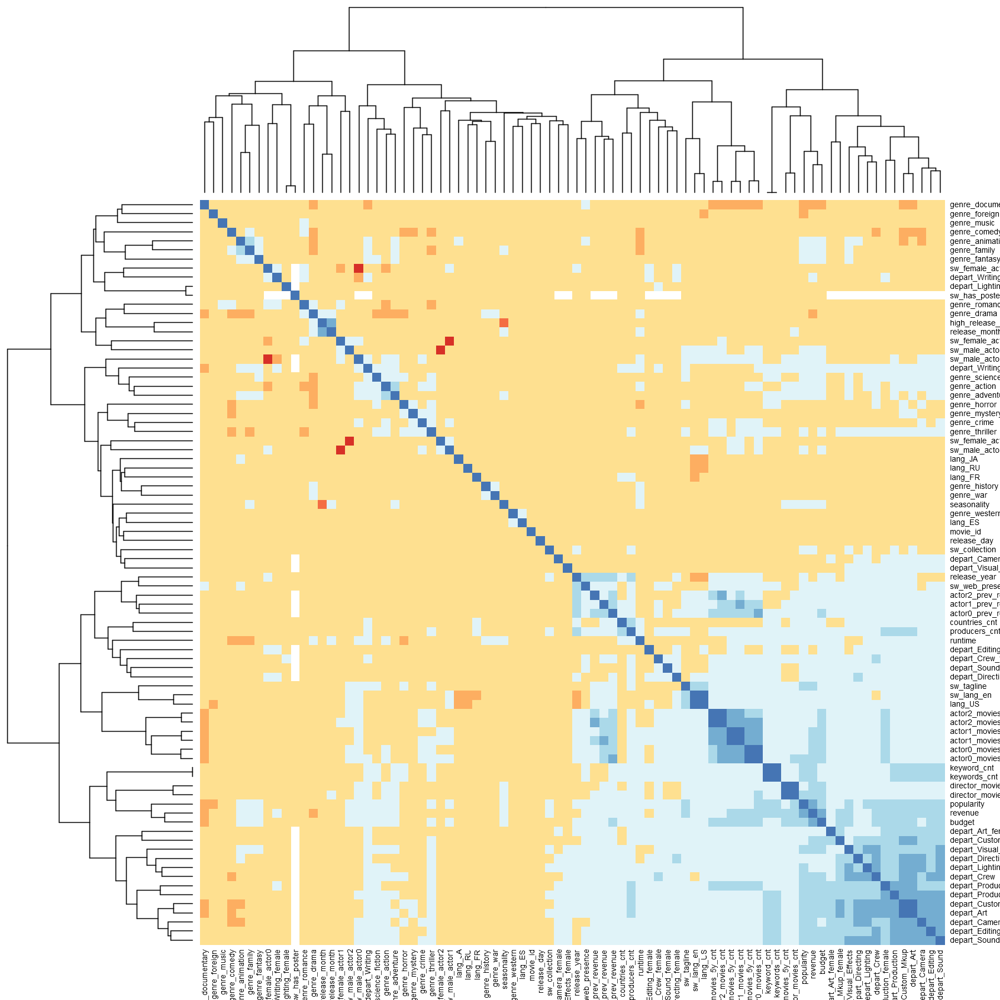

In [155]:
heatmap(res,symm = T,cexCol = 0.8, cexRow = 0.8, col=brewer.pal(n=8, name="RdYlBu"))

In [157]:
if (!require("corrplot")) install.packages("corrplot")
if (!require("RColorBrewer")) install.packages("RColorBrewer")

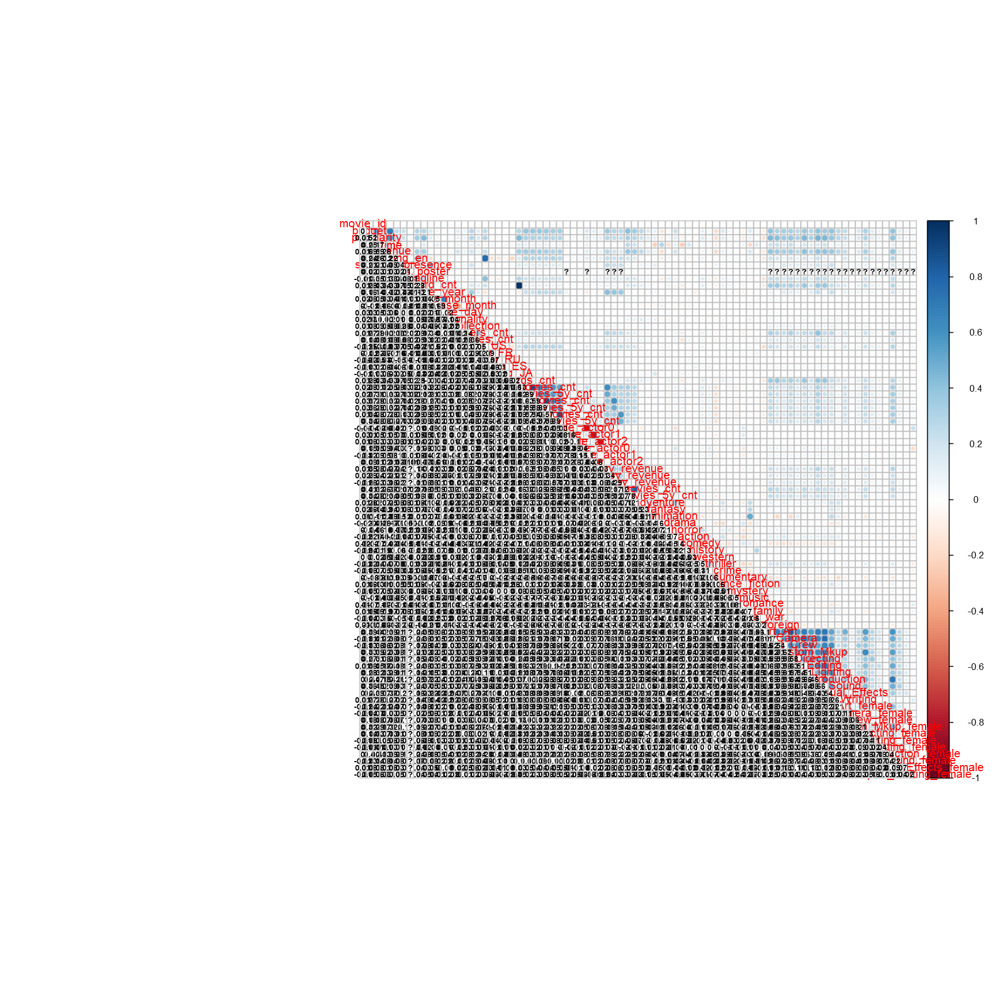

In [160]:
corrplot.mixed(res, lower.col = "black", number.cex = .7, tl.srt = 90)

#### 2.4 - Describe the outcome variable

- Histogram
- Histogram by categories


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


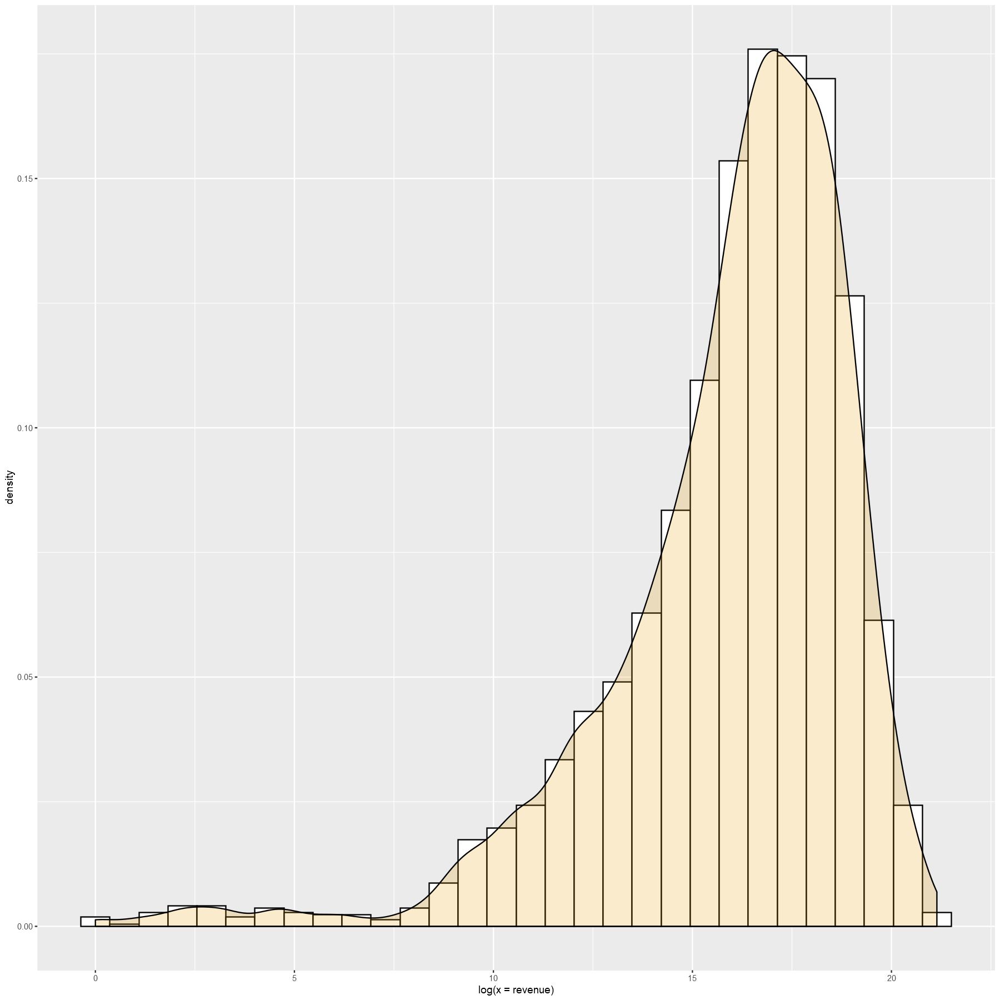

In [161]:
#Revenue Analysis
ggplot(movies_ff, aes(log(x=revenue))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()


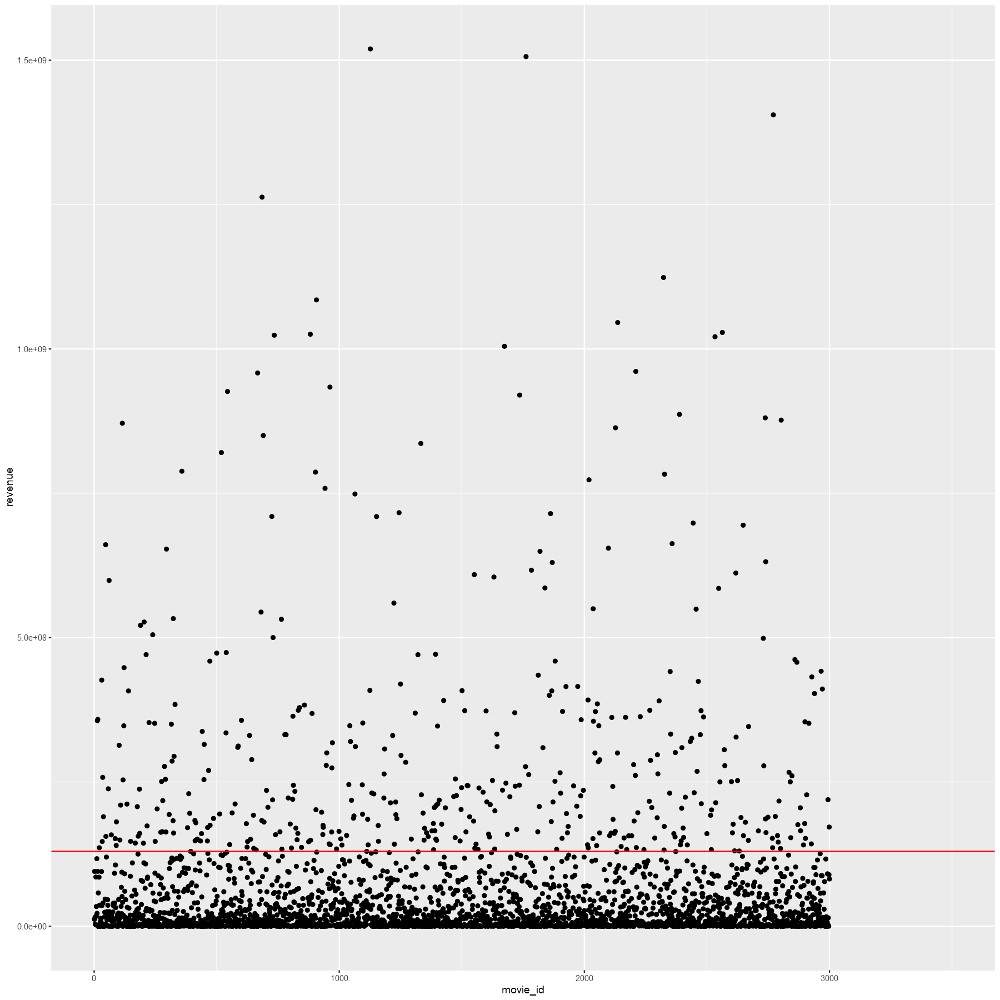

In [162]:
#Revenue Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=revenue)) + 
    xlim (0,3500) +
    geom_hline(yintercept = 130000000 ,color="red")

#### 2.5 - Graphs to catch outliers


In [164]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- setdiff(names(data),"movie_id")
    outdata <- data.frame(movie_id=data$movie_id)
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            med <- median (data[[v]],na.rm=TRUE)
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[paste0(v,"_out")] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}


missingMatrix <- function(data) {
    vn <- setdiff(names(data),"movie_id")
    missdata <- data.frame(movie_id=data$movie_id)
    for(v in vn) {
        mv <- ifelse(is.na(data[[v]]),1,0)
        missdata[paste0(v,"_miss")] <- mv
    }
    missdata$row1 <- NULL
    return(missdata)
}

minmax <- function(x) {
    return(((x-min(x,na.rm=T))/(max(x,na.rm=T)-min(x,na.rm=T))))
}

getMissingness <- function (data, getRows = FALSE) {
    require(dplyr)
    l <- nrow(data)
    vn <- names(data)
    nadf <- data
    cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(na.count > 
        0)
    totmiss <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::tally()
    idx <- NULL
    msg <- (paste("This dataset has ", as.character(totmiss), 
        " (", as.character(round(totmiss/nrow(data) * 100, 1)), 
        "%)", " complete rows. Original data has ", nrow(data), 
        " rows.", sep = ""))
    if (getRows == TRUE & totmiss != 0) {
        nadf$rn <- seq_len(nrow(data))
        idx <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::select(rn)
    }
    print(list(head(cnt, n = 10), msg))
    return(list(missingness = cnt, message = msg, rows = idx$rn))
}

In [165]:
movies_outliers <- outlierMatrix(movies_ff)

In [167]:
head(movies_outliers)

,movie_id,budget_out,popularity_out,runtime_out,revenue_out,sw_lang_en_out,sw_web_presence_out,sw_has_poster_out,sw_tagline_out,keyword_cnt_out,...,depart_Camera_female_out,depart_Crew_female_out,depart_Custom_Mkup_female_out,depart_Directing_female_out,depart_Editing_female_out,depart_Lighting_female_out,depart_Production_female_out,depart_Sound_female_out,depart_Visual_Effects_female_out,depart_Writing_female_out
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,3,0,1,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
4,4,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
5,5,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
6,6,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


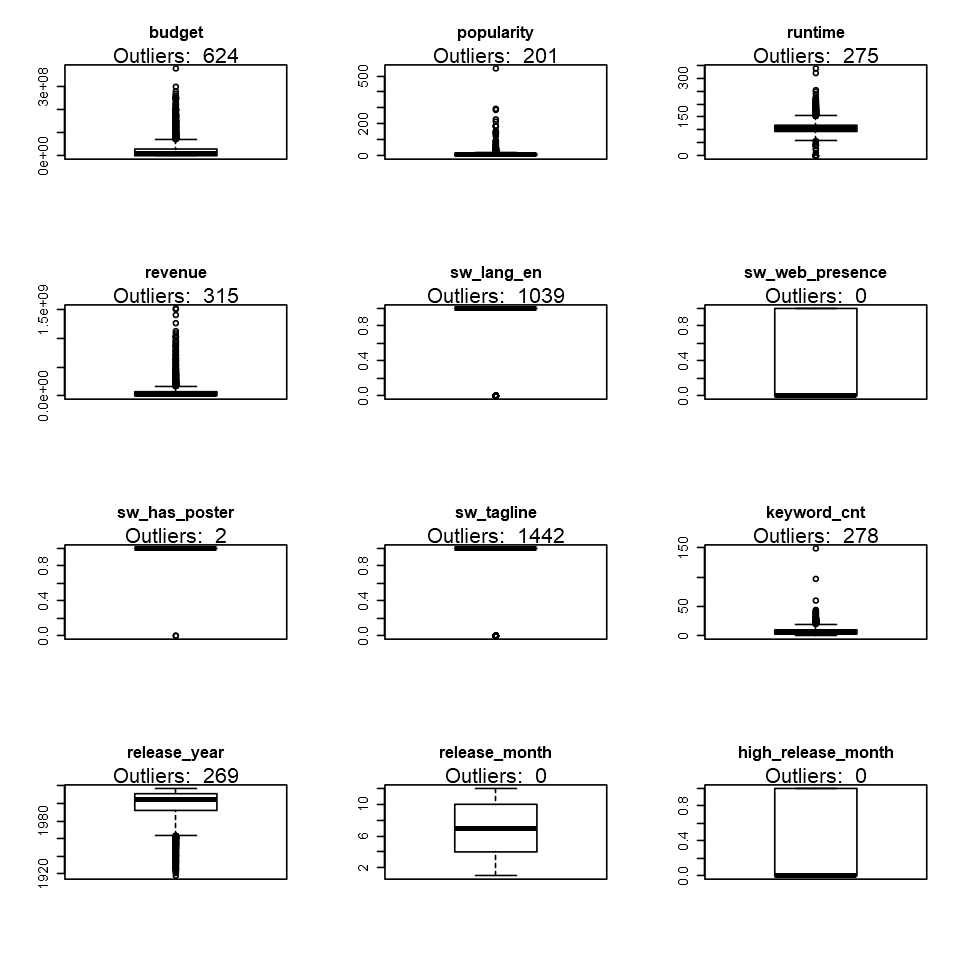

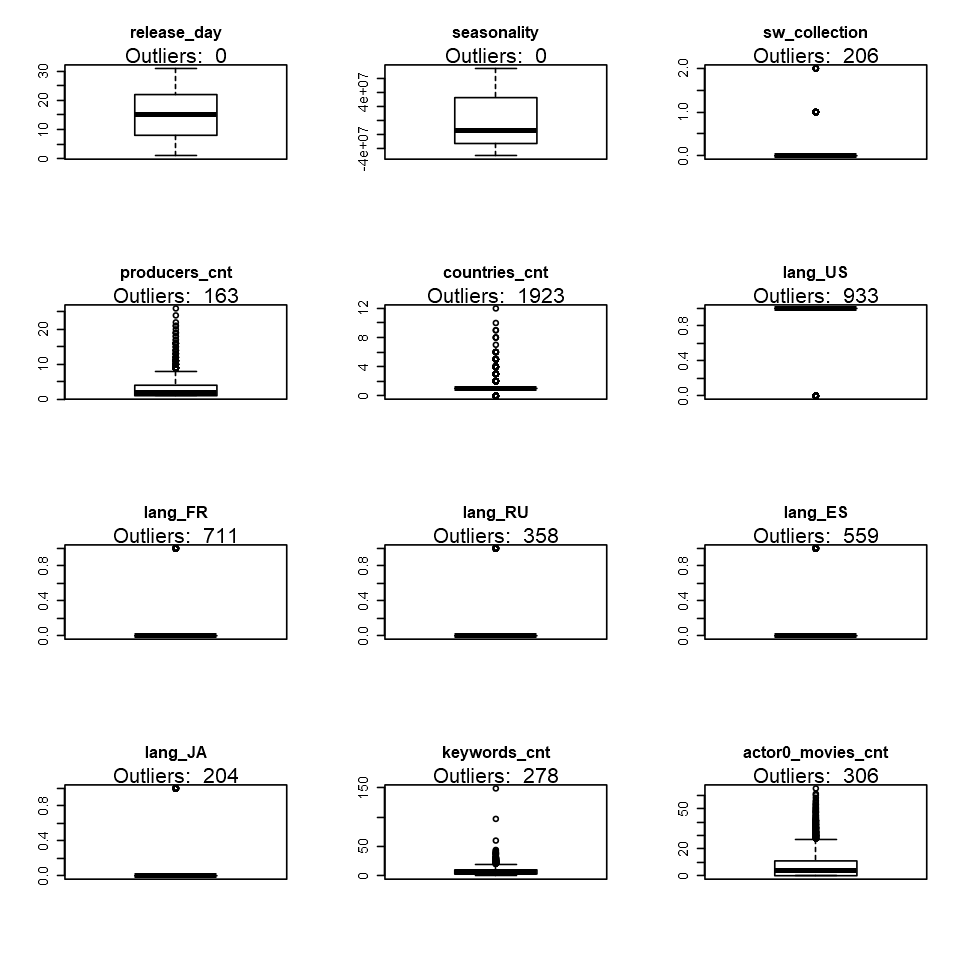

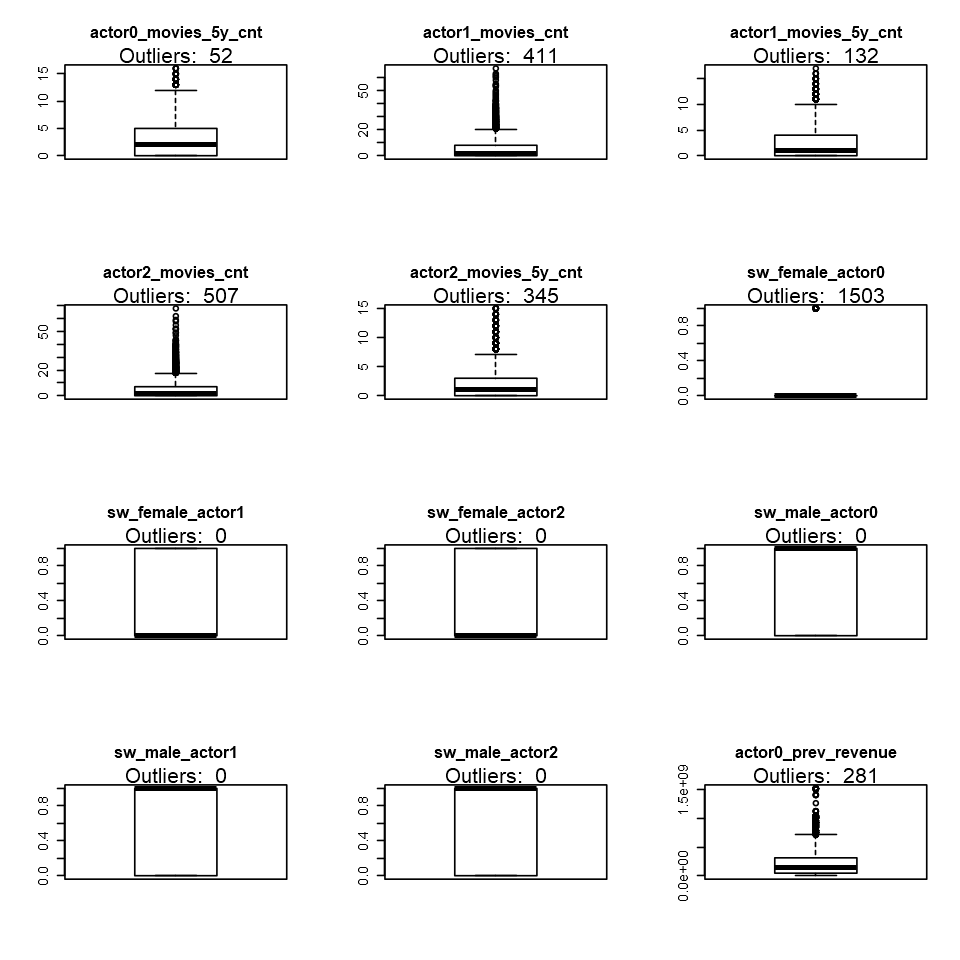

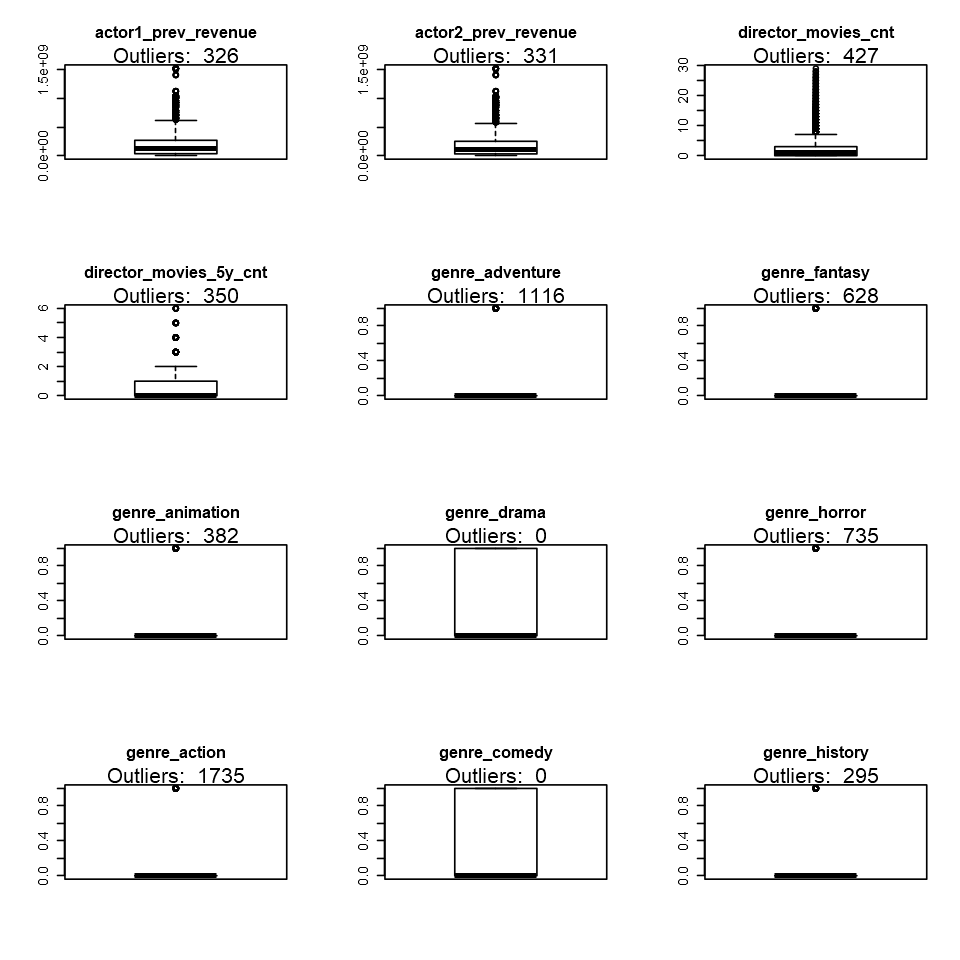

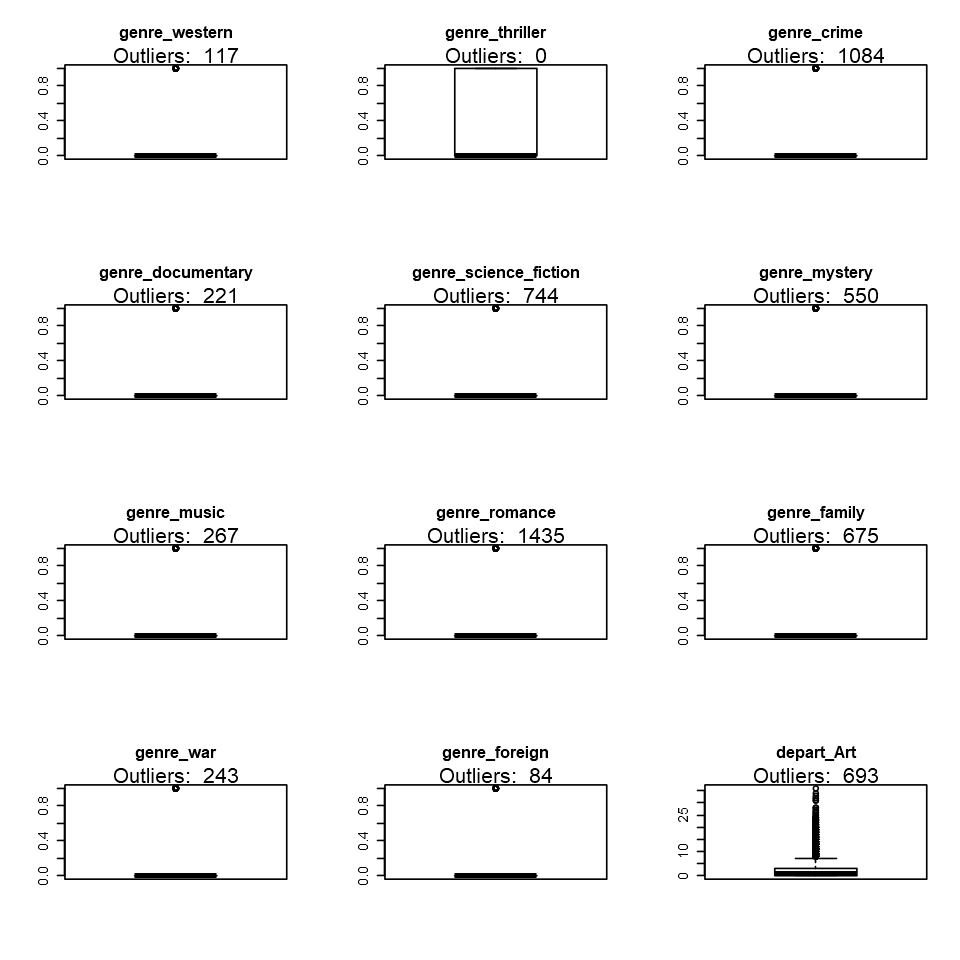

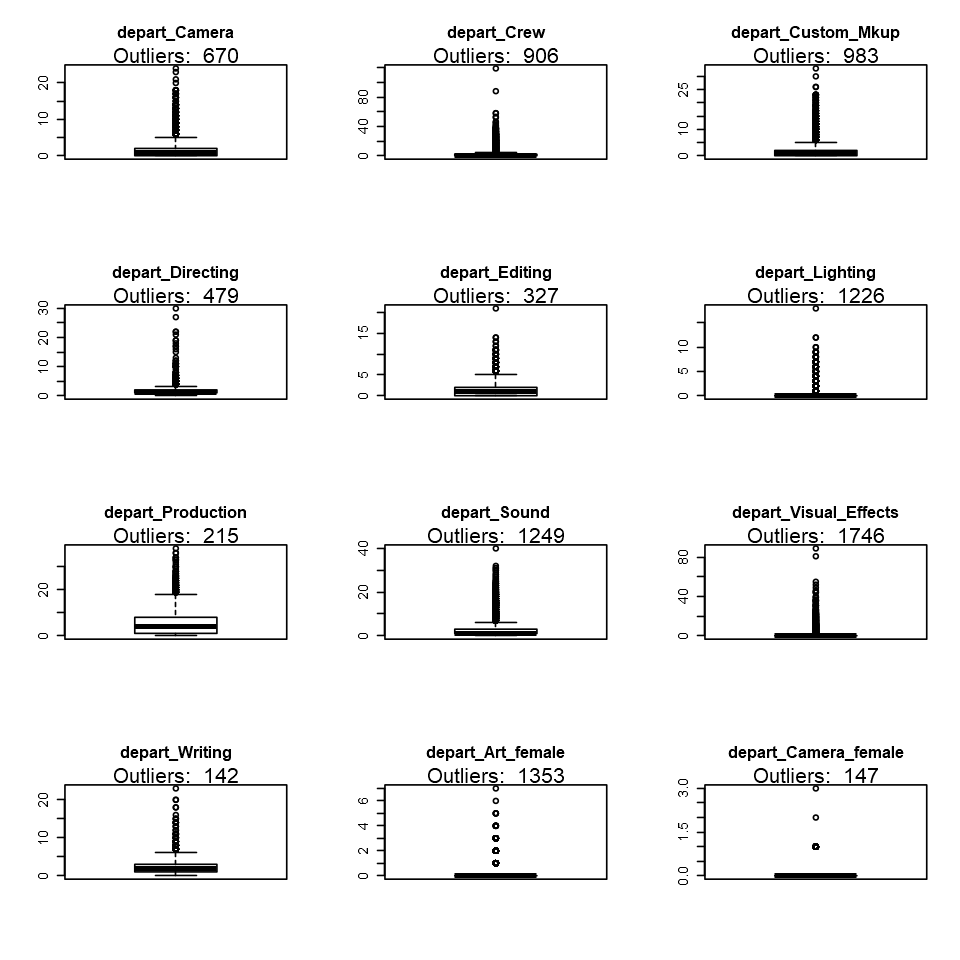

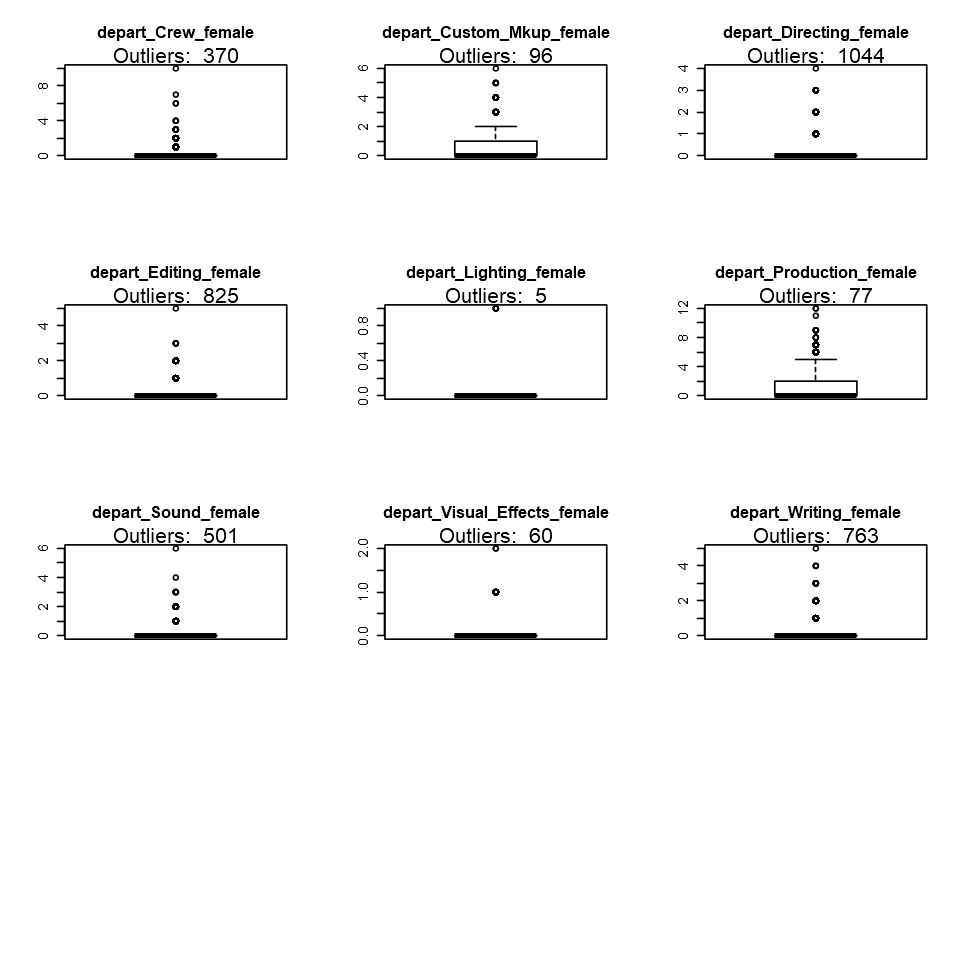

In [173]:
options(repr.plot.width = 8, repr.plot.height = 8)
par(mfrow=c(4,3))
for(v in names(nm[,2:85])) {
    outlier_values <- boxplot.stats(nm[,v])$out
    boxplot(nm[[v]],main=v)
    mtext(paste("Outliers: ", paste(length(outlier_values), collapse=", ")), cex=1)
}
par(mfrow=c(1,1))

#### 2.6 -  Describe the missing values

In [174]:
if (!require("dplyr")) install.packages("dplyr")

In [176]:
getMissingness <- function(data, getRows=FALSE) {
  desc <- na_count <- na_cnt <- rn <- pred <- dc <- NULL
  l <- nrow(data)
  vn <- names(data)
  ### copy the dataset and replace the NAs by 1 else 0
  nadf <- data
  cnt <- NULL
  miss <- function(x) return(sum(is.na(x) ))
  for(n in vn) {
    nadf[[n]] <- ifelse(is.na(nadf[[n]])==T,1,0)
    cnt <- rbind(cnt, data.frame(n,sum(nadf[[n]])))
  }
  names(cnt) <- c("var","na_count")
  cnt$rate <- round((cnt$na_count / nrow(nadf))*100,1)
  ### now sum by column
  nadf$na_cnt <- 0
  nadf$na_cnt <- rowSums(nadf)
  ### order descending the count of mossings and leave only those with missings
  cnt <- cnt %>%
    dplyr::arrange(desc(na_count)) %>%
    dplyr::filter(na_count>0)
  totmiss <- nadf %>% dplyr::filter(na_cnt==0) %>% dplyr::summarise(n=n())
  idx <- NULL
  msg <- (paste("This dataset has ", as.character(totmiss), " (",as.character(round(totmiss/nrow(data)*100,1)),"%)" ," complete rows. Original data has ",nrow(data)," rows.",sep=""))
  ### check id needs to return the row indexes
  if(getRows==TRUE & totmiss != 0) {
    nadf$rn <- seq_len(nrow(data))
    idx <- nadf %>% dplyr::filter(na_cnt==0) %>% dplyr::select(rn)
  }
  print(list(head(cnt,n=10), msg))
  return(list(missingness=cnt, message=msg, rows=idx$rn))
}

In [177]:
getMissingness(df)

[[1]]
                   var na_count rate
1              revenue     4382 59.4
2  actor2_prev_revenue     3423 46.4
3  actor1_prev_revenue     3201 43.4
4  actor0_prev_revenue     2752 37.3
5     sw_female_actor0      934 12.7
6       sw_male_actor0      934 12.7
7     sw_female_actor2      788 10.7
8       sw_male_actor2      788 10.7
9     sw_female_actor1      782 10.6
10      sw_male_actor1      782 10.6

[[2]]
[1] "This dataset has 1154 (15.6%) complete rows. Original data has 7375 rows."



var,na_count,rate
<fct>,<dbl>,<dbl>
revenue,4382,59.4
actor2_prev_revenue,3423,46.4
actor1_prev_revenue,3201,43.4
actor0_prev_revenue,2752,37.3
sw_female_actor0,934,12.7
sw_male_actor0,934,12.7
sw_female_actor2,788,10.7
sw_male_actor2,788,10.7
sw_female_actor1,782,10.6


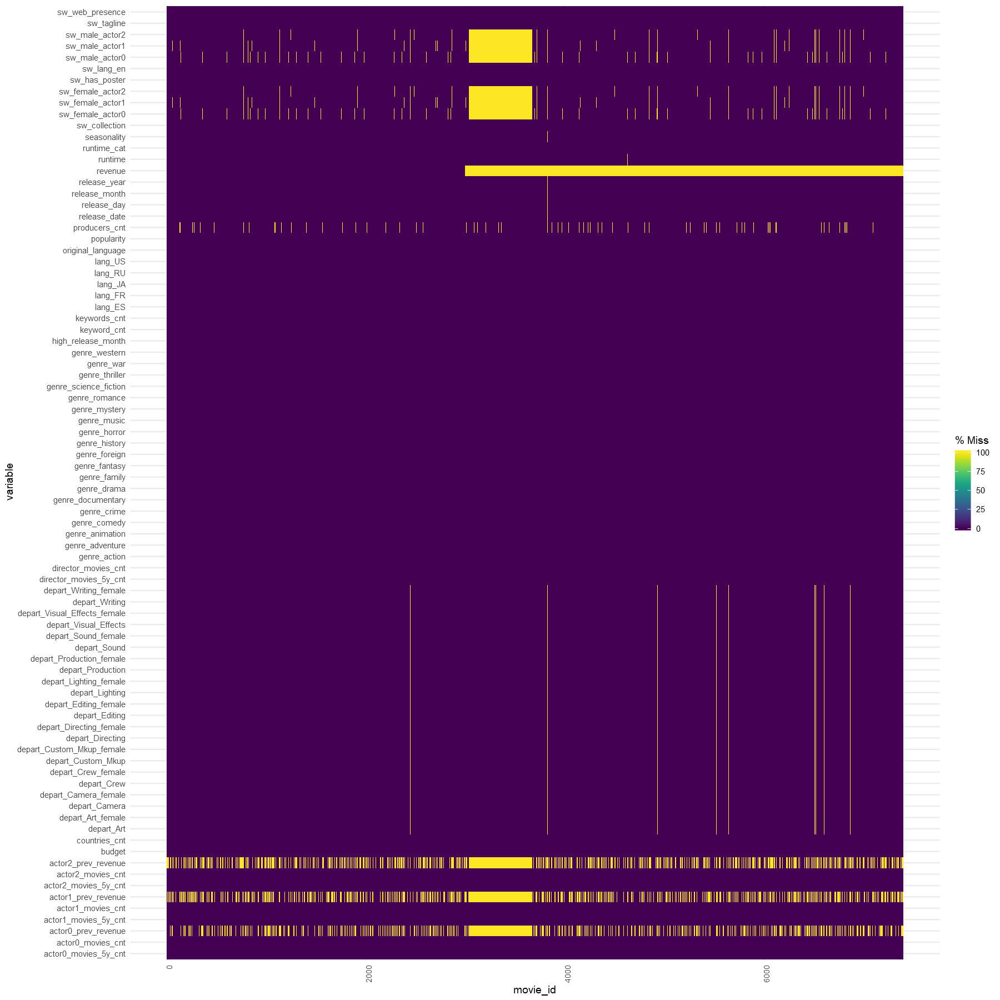

In [178]:
if(!require(naniar)) {install.packages("naniar");require(naniar)}
library(naniar)
options(repr.plot.width = 15, repr.plot.height = 15)

gg_miss_fct(x=movies_ff, fct=movie_id) + 
theme(axis.text.x = element_text(angle=90, size=8))

#### 2.7 - Missing matrix

In [63]:
df.na <- df
for(i in names(df)) {
    df.na[,i] <- ifelse(is.na(df.na[,i])==T,1,0)
}

In [64]:
head(df.na)

,movie_id,budget,original_language,popularity,release_date,runtime,runtime_cat,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [65]:
df.na

movie_id,budget,original_language,popularity,release_date,runtime,runtime_cat,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


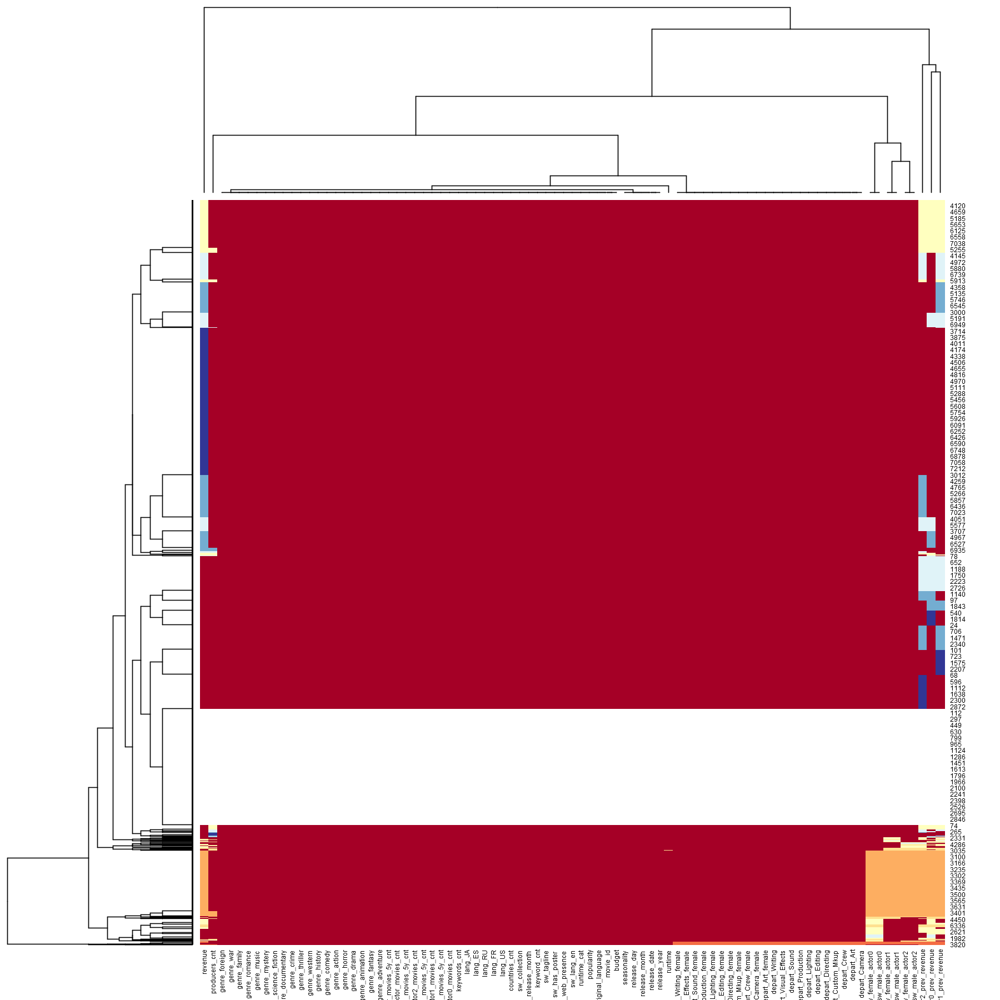

In [125]:
heatmap(as.matrix(df.na),cexCol = 0.7, cexRow = 0.7, col=brewer.pal(n=ncol(df), name="RdYlBu"))

In [126]:
if (!require("VIM")) install.packages("VIM")

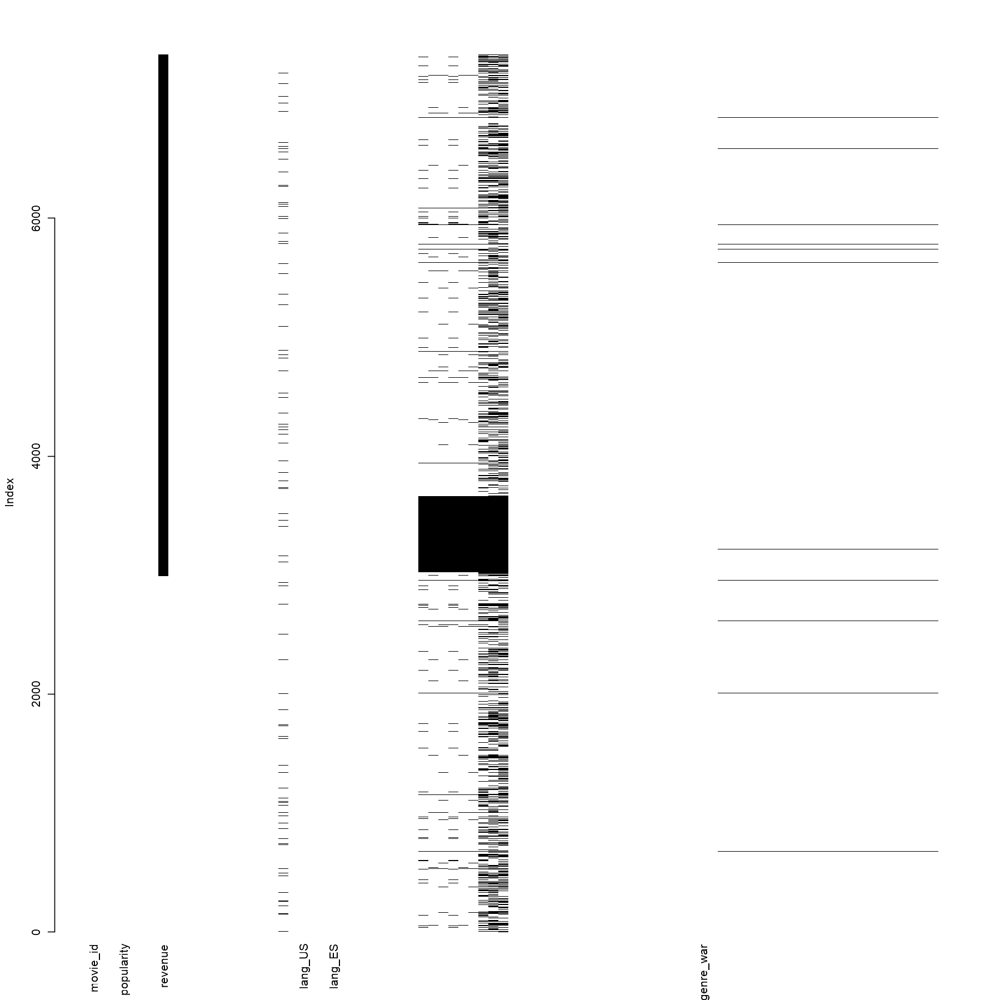

In [127]:
matrixplot(as.matrix(df.na))

## 3 - Data Cleansing
 
### 3.1 -  Outliers

#### 3.1.1 - For the variables where outliers were found, check the distribution with/without outliers


In [183]:
vn <- names(df[,2:84])
vn <- c('movie_id')
for(v in vn) {
        if((is.numeric(df[[v]])) & (max(df[[v]],na.rm=T)>1))
            {vn <- c(vn,v)}}

In [184]:
vn <- setdiff(vn,"movie_id")

In [187]:
 for (v in vn){
    newdf <- left_join(df[,c("movie_id","revenue")], movies_outliers[,c("movie_id",paste0(v,"_out"))])
    print(    ggplot (newdf,aes(x=log(newdf$revenue), group = factor(newdf[[paste0(v,"_out")]]),
                                color = factor(newdf[[paste0(v,"_out")]]))) + 
          geom_density() + ggtitle(paste("Revenue by",v)) )
 
    options(repr.plot.width = 8, repr.plot.height = 8)
}
vn

character(0)

In [189]:
runtime.out <- ifelse(df[["runtime"]] > 154 | df[["runtime"]] <59, 1, 0)
table(runtime.out)

runtime.out
   0    1 
7095  275 

In [190]:
runtime.noout <- df[["runtime"]]
runtime.noout <- ifelse(runtime.out==1,NA,runtime.noout)
head(runtime.noout)

[1]  93 113 105 122 118  83

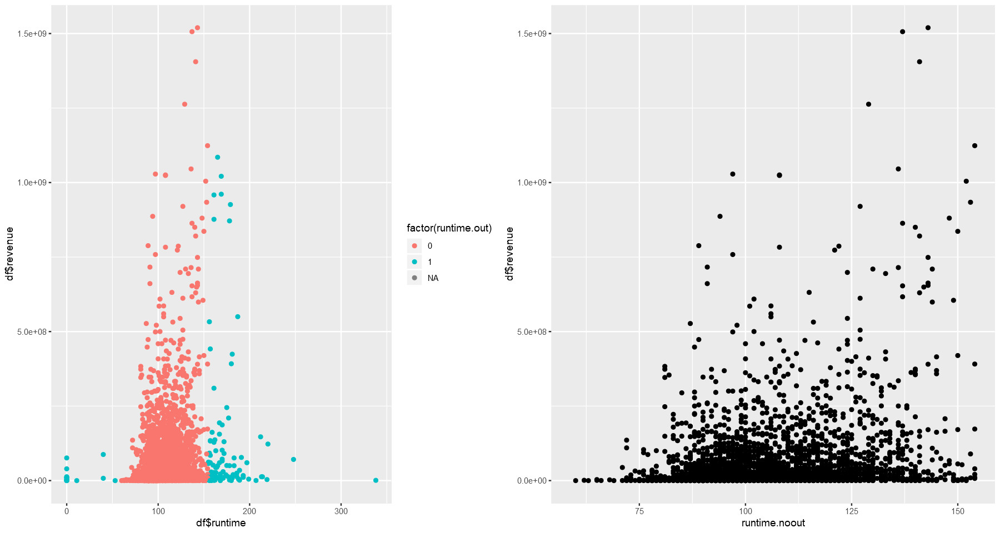

In [191]:
p1 <- ggplot() + geom_point(aes(x=df$runtime, y=df$revenue, color=factor(runtime.out)))
p2 <- ggplot() + geom_point(aes(x=runtime.noout, y=df$revenue))

options(repr.plot.width = 15, repr.plot.height = 8)
grid.arrange(p1, p2, nrow = 1)

In [192]:
budget.out <- ifelse(df[["budget"]] > 72500000, 1, 0)
table(budget.out)

budget.out
   0    1 
6751  624 

In [194]:
budget.noout <- df[["budget"]]
budget.noout  <- ifelse(budget.out ==1,NA,budget.noout )
head(budget.noout )

[1] 14000000 40000000  3300000  1200000        0  8000000

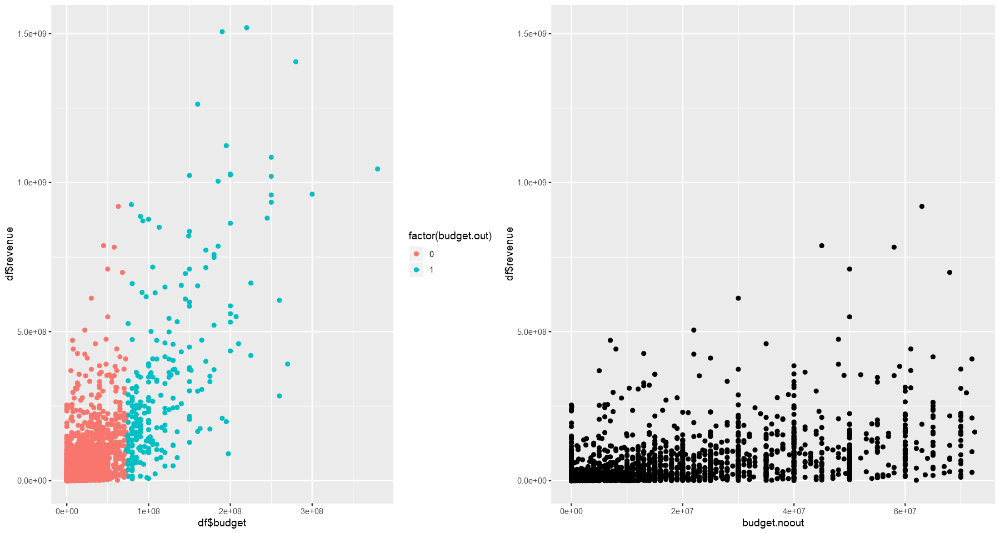

In [195]:
p1 <- ggplot() + geom_point(aes(x=df$budget, y=df$revenue, color=factor(budget.out)))
p2 <- ggplot() + geom_point(aes(x=budget.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)


In [196]:
countries_cnt.out <- ifelse(df[["countries_cnt"]] > 1 | df[["countries_cnt"]] <= 0, 1, 0)
table(countries_cnt.out)

countries_cnt.out
   0    1 
5452 1923 

In [197]:
countries_cnt.noout <- df[["countries_cnt"]]
countries_cnt.noout  <- ifelse(countries_cnt.out ==1,NA,countries_cnt.noout )
head(countries_cnt.noout )

[1]  1  1  1  1  1 NA

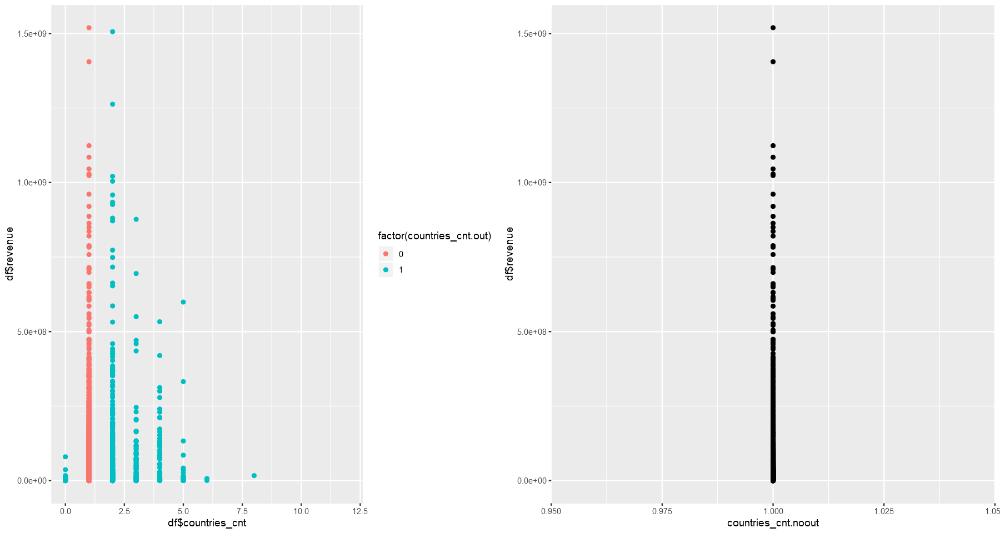

In [198]:
p1 <- ggplot() + geom_point(aes(x=df$countries_cnt, y=df$revenue, color=factor(countries_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=countries_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [199]:
actor1_movies_cnt.out <- ifelse(df[["actor1_movies_cnt"]] >= 21 , 1, 0)
table(actor1_movies_cnt.out)

actor1_movies_cnt.out
   0    1 
6964  411 

In [200]:
actor1_movies_cnt.noout <- df[["revenue"]]
actor1_movies_cnt.noout  <- ifelse(actor1_movies_cnt.out ==1,NA,actor1_movies_cnt.noout )
head(actor1_movies_cnt.noout )

[1] 12314651 95149435       NA 16000000  3923970  3261638

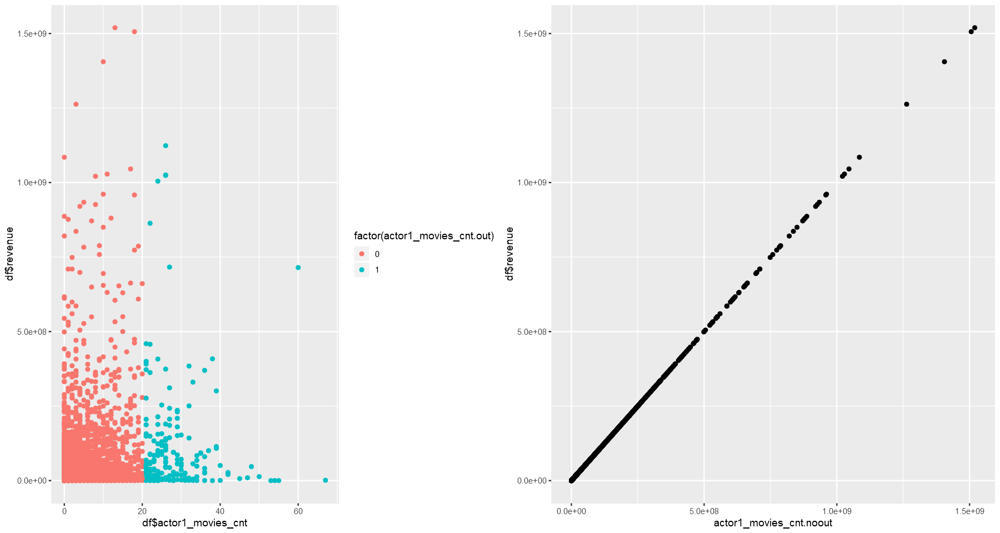

In [201]:
p1 <- ggplot() + geom_point(aes(x=df$actor1_movies_cnt, y=df$revenue, color=factor(actor1_movies_cnt.out)))
p2 <- ggplot() + geom_point(aes(x=actor1_movies_cnt.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [203]:
actor0_prev_revenue.out <- ifelse(df[["actor0_prev_revenue"]] >= 714766572 , 1, 0)
table(actor0_prev_revenue.out)

actor0_prev_revenue.out
   0    1 
4342  281 

In [204]:
actor0_prev_revenue.noout <- df[["actor0_prev_revenue"]]
actor0_prev_revenue.noout  <- ifelse(actor0_prev_revenue.out ==1,NA,actor0_prev_revenue.noout )
head(actor0_prev_revenue.noout )

[1] 116980662 165335153  48065672   4100000        NA        NA

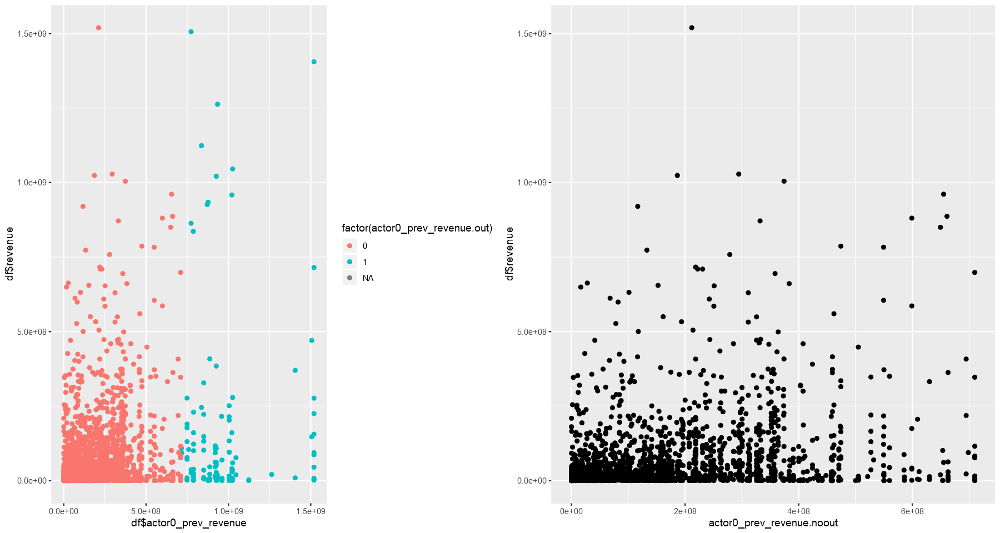

In [205]:
p1 <- ggplot() + geom_point(aes(x=df$actor0_prev_revenue, y=df$revenue, color=factor(actor0_prev_revenue.out)))
p2 <- ggplot() + geom_point(aes(x=actor0_prev_revenue.noout, y=df$revenue))


grid.arrange(p1, p2, nrow = 1)

In [206]:
par(mfrow=c(2,2))
for (v in nm){
            a <- max(df[[v]],na.rm=TRUE)
            b1 <- df %>% select(revenue,v)   
            b2 <- df %>% select(revenue,v) %>% filter(movies_outliers[[paste0(v,'_out')]]==0) 
            plot (b1[[v]],b1$revenue,xlab=v,ylab='revenue',xlim=c(0,a))
            abline(coef(lm(b1$revenue~b1[[v]])), col='blue')
            if (length(unique(b2[[v]]))!=1){
            abline(coef(lm(b2$revenue~b2[[v]])), col = "red")}
    }

ERROR: Error in .subset2(x, i, exact = exact): recursive indexing failed at level 2



In [74]:
outliers_treatments <- read.csv("https://github.com/ilyalevner/DataScience/tree/master/stats/outliers_treat.csv")
outliers_treatments

ï..Variable,Density.change,revenue.change.with.without,decision
<fct>,<fct>,<fct>,<fct>
budget,no change,small change,drop
popularity,no change,big change,drop
runtime,no change,small change,drop
revenue,no change,no change,leave it
keyword_cnt,no change,big change,drop
release_year,no change,no change,drop
producers_cnt,no change,no change,drop
countries_cnt,no change,big change,leave it
actor0_movies_cnt,no change,small change,drop


In [207]:
## save the original table into another table and put the dataset after the outlier treatment into df
df.orig <- df

NULL

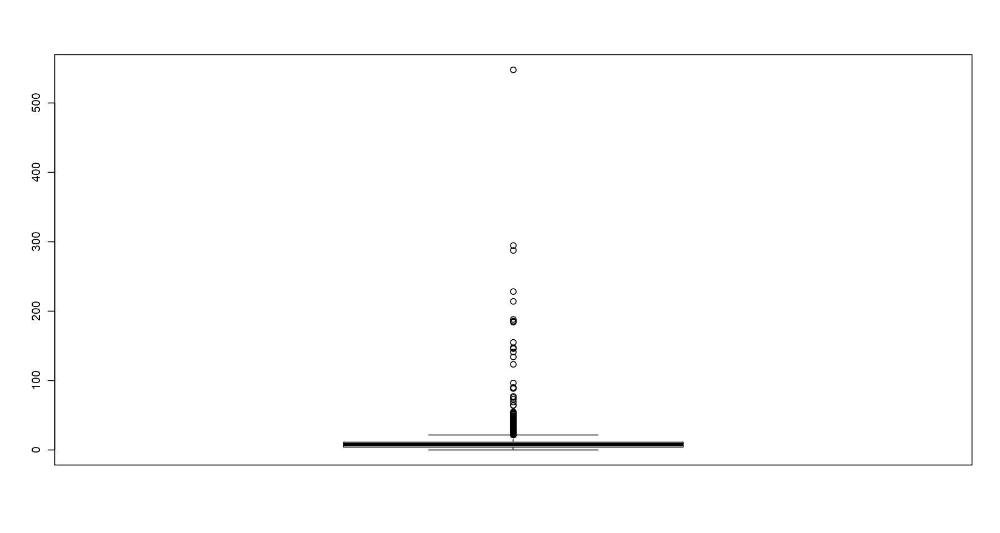

In [210]:
out <- boxplot(df["popularity"])
out$popularity

In [ ]:
out <- boxplot(df["budget"])
out$budget

In [76]:
outliers_drop <-  outliers_treatments[outliers_treatments$decision == "drop",]
outliers_drop <-as.vector(outliers_drop[,-2:-4])
outliers_drop

[1] "budget"                    "popularity"               
 [3] "runtime"                   "keyword_cnt"              
 [5] "release_year"              "producers_cnt"            
 [7] "actor0_movies_cnt"         "actor0_movies_5y_cnt"     
 [9] "actor1_movies_5y_cnt"      "actor2_movies_cnt"        
[11] "actor2_movies_5y_cnt"      "actor1_prev_revenue"      
[13] "actor2_prev_revenue"       "director_movies_5y_cnt"   
[15] "depart_Art"                "depart_Camera"            
[17] "depart_Custom_Mkup"        "depart_Editing"           
[19] "depart_Production"         "depart_Sound"             
[21] "depart_Writing"            "depart_Custom_Mkup_female"
[23] "depart_Production_female"

In [78]:
length(outliers_drop)

[1] 23

In [97]:
dfnoout <- movies_ff
head(denoout)

,movie_id,budget,original_language,popularity,release_date,runtime,runtime_cat,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<int>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,14000000,en,6.575393,2015-02-20,93,Short,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,40000000,en,8.248895,2004-08-06,113,Medium,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,3300000,en,64.299990,2014-10-10,105,Medium,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,1200000,hi,3.174936,2012-03-09,122,Large,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,0,ko,1.148070,2009-02-05,118,Medium,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,8000000,en,0.743274,1987-08-06,83,Short,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0


In [85]:
for (v in outliers_drop){
    print(v)
    v_out <-paste0(v,"drop")
    dfnoout[[v]] <- ifelse(dfnoout[[v_out]]==1,NA,dfnoout[[v]])
}

[1] "budget"


ERROR: Error in `[[<-.data.frame`(`*tmp*`, v, value = logical(0)): replacement has 0 rows, data has 7375


In [98]:
mo_noout <- movies_ff
head(mo_noout)

,movie_id,budget,original_language,popularity,release_date,runtime,runtime_cat,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<int>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,14000000,en,6.575393,2015-02-20,93,Short,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,40000000,en,8.248895,2004-08-06,113,Medium,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,3300000,en,64.299990,2014-10-10,105,Medium,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,1200000,hi,3.174936,2012-03-09,122,Large,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,0,ko,1.148070,2009-02-05,118,Medium,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,8000000,en,0.743274,1987-08-06,83,Short,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0


In [99]:
mo_noout <- ifelse(df[["revenue"]] >= 7,1,0)
table(wt.out)

wt.out
   0    1 
   9 2984 

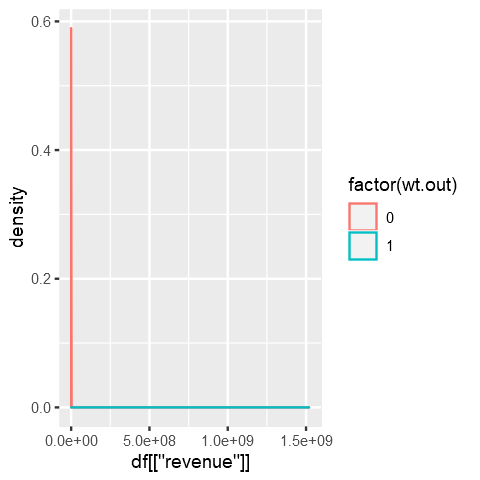

In [100]:
ggplot() + geom_density(aes(df[["revenue"]], group=factor(wt.out), color=factor(wt.out)))

#### 3.1.2 - Influence of the outluers on the outcome

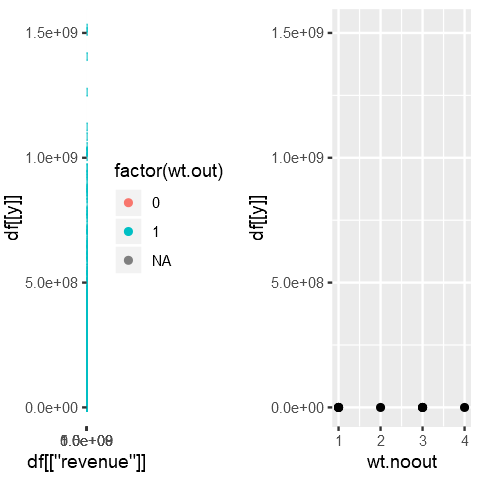

In [102]:
p1 <- ggplot() + geom_point(aes(x=df[['revenue']], y=df[[y]], color=factor(wt.out)))
p2 <- ggplot() + geom_point(aes(x=wt.noout, y=df[[y]]))
grid.arrange(p1, p2, nrow = 1)


In [103]:
mod1 <- lm(df[[y]] ~ df[['revenue']])
mod2 <- lm(df[[y]] ~ wt.noout)


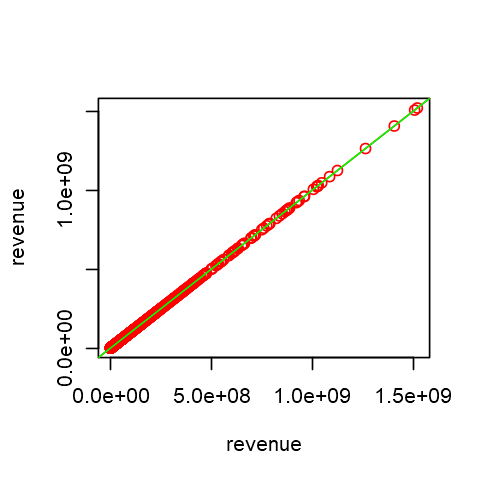

In [104]:
options(repr.plot.width = 4, repr.plot.height = 4)
plot(df[['revenue']], df[[y]], col=factor(wt.out),xlab="revenue",ylab=y)
abline(mod1, col="red") 
abline(mod2, col="green")

#### 3.1.3 - Table with variables having outliers.  

In [105]:
outres <- data.frame(variable=NULL,treatment=NULL,why=NULL)
outres

<0 x 0 matrix>

#### 3.1.4 - Cleansed dataset for Outliers

In [163]:
df.noout <- df
## here treat the outliers as described in 3.1.3

### 3.2 - Missing values
 
#### 3.2.1 - Show the distribution of each numeric variable by missingness of other variables 

In [211]:

## remade the missing matrix to include the new missing values generated by the outliers treatment
df.na <- df
for(i in names(df)) {
    df.na[,i] <- ifelse(is.na(df.na[,i])==T,1,0)
}

In [213]:
df$original_language <- factor(df$original_language)
df$release_date      <- factor(df$release_date)
df$runtime_cat       <- factor(df$runtime_cat)
summary (df)

    movie_id        budget          original_language   popularity     
 Min.   :   1   Min.   :        0   en     :6336      Min.   :  0.000  
 1st Qu.:1848   1st Qu.:        0   fr     : 199      1st Qu.:  3.970  
 Median :3696   Median :  8000000   hi     : 118      Median :  7.456  
 Mean   :3698   Mean   : 22666657   ru     : 105      Mean   :  8.540  
 3rd Qu.:5550   3rd Qu.: 29000000   es     :  95      3rd Qu.: 10.932  
 Max.   :7398   Max.   :380000000   ja     :  90      Max.   :547.488  
                                    (Other): 432                       
     release_date     runtime      runtime_cat      revenue         
 2010-09-10:  10   Min.   :  0.0   Large :1769   Min.   :1.000e+00  
 2011-09-09:   8   1st Qu.: 94.0   Medium:3884   1st Qu.:2.405e+06  
 2005-09-16:   7   Median :104.0   Short :1722   Median :1.693e+07  
 2008-12-25:   7   Mean   :107.7                 Mean   :6.688e+07  
 2009-01-16:   7   3rd Qu.:118.0                 3rd Qu.:6.906e+07  
 (Other)  

In [214]:
getMissingness(df)

[[1]]
                   var na_count rate
1              revenue     4382 59.4
2  actor2_prev_revenue     3423 46.4
3  actor1_prev_revenue     3201 43.4
4  actor0_prev_revenue     2752 37.3
5     sw_female_actor0      934 12.7
6       sw_male_actor0      934 12.7
7     sw_female_actor2      788 10.7
8       sw_male_actor2      788 10.7
9     sw_female_actor1      782 10.6
10      sw_male_actor1      782 10.6

[[2]]
[1] "This dataset has 1154 (15.6%) complete rows. Original data has 7375 rows."



var,na_count,rate
<fct>,<dbl>,<dbl>
revenue,4382,59.4
actor2_prev_revenue,3423,46.4
actor1_prev_revenue,3201,43.4
actor0_prev_revenue,2752,37.3
sw_female_actor0,934,12.7
sw_male_actor0,934,12.7
sw_female_actor2,788,10.7
sw_male_actor2,788,10.7
sw_female_actor1,782,10.6


In [215]:
missing_5_pct <- function (data, getRows = FALSE) {
       l <- nrow(data)
      vn <- names(data)
    nadf <- data
     cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(rate > 
        5)
    }
na_5_pct <-missing_5_pct(df)
na_5_pct

var,na.count,rate
<fct>,<dbl>,<dbl>
revenue,4382,59.4
actor2_prev_revenue,3423,46.4
actor1_prev_revenue,3201,43.4
actor0_prev_revenue,2752,37.3
sw_female_actor0,934,12.7
sw_male_actor0,934,12.7
sw_female_actor2,788,10.7
sw_male_actor2,788,10.7
sw_female_actor1,782,10.6


In [216]:
missing_less_5_pct <- function (data, getRows = FALSE) {
       l <- nrow(data)
      vn <- names(data)
    nadf <- data
     cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(rate < 
        5)
    }
na_less_5_pct <-missing_less_5_pct(df)
na_less_5_pct

var,na.count,rate
<fct>,<dbl>,<dbl>
depart_Art,34,0.5
depart_Camera,34,0.5
depart_Crew,34,0.5
depart_Custom_Mkup,34,0.5
depart_Directing,34,0.5
depart_Editing,34,0.5
depart_Lighting,34,0.5
depart_Production,34,0.5
depart_Sound,34,0.5


In [223]:
miss_treatments <- read.csv("https://github.com/ilyalevner/DataScience/tree/master/stats/missing_treat.csv")
miss_treatments

ï..Variable,Mechanism,Treatment
<fct>,<fct>,<fct>
revenue,MNAR,leave
actor2_prev_revenue,MNAR,leave
actor1_prev_revenue,MNAR,leave
actor0_prev_revenue,MNAR,leave
sw_female_actor0,catogory,leave
sw_male_actor0,catogory,leave
sw_female_actor2,catogory,leave
sw_male_actor2,catogory,leave
sw_female_actor1,catogory,leave


In [224]:
na_5_pct <- na_5_pct$var
na_less_5_pct <- na_less_5_pct$var

ERROR: Error in na_5_pct$var: $ operator is invalid for atomic vectors


### 3.2.3 - Missingess treatment

In [227]:
na.omit(df$depart_Cameradepart_Camera)
na.omit(df$depart_Crew)
na.omit(df$depart_Custom_Mkup)
na.omit(df$depart_Directing)
na.omit(df$depart_Editing)
na.omit(df$depart_Lighting)
na.omit(df$depart_Production)
na.omit(df$depart_Sound)
na.omit(df$depart_Visual_Effects)
na.omit(df$depart_Writing)
na.omit(df$depart_Art_female)
na.omit(df$depart_Camera_female)
na.omit(df$depart_Crew_female)
na.omit(df$depart_Custom_Mkup_female)
na.omit(df$depart_Directing_female)
na.omit(df$depart_Editing_female)
na.omit(df$depart_Lighting_female)
na.omit(df$depart_Production_female)
na.omit(df$depart_Sound_female)
na.omit(df$depart_Visual_Effects_female)
na.omit(df$depart_Writing_female)
na.omit(df$runtime)
na.omit(df$release_date)
na.omit(df$release_year)
na.omit(df$release_month)
na.omit(df$release_day)
na.omit(df$seasonality)


NULL

[1]   4   0   9   0   0   0  11   0   0   0   5   0  23   0  36   5   1   2
  [19]   0   0  25   0   0   0   0   3   0   0   0   0   2   0   7   0   1   0
  [37]   0   0   0   0   0   4   0   0   0   0   1   7   4   0   0   0   0   0
  [55]   0   0   0  26   0   0  17   0   8   0  20   1   0   0   0   4   0   0
  [73]   0   0   0   1   1   0   0   5   0   0  19   3   0   0   3   0   0   0
  [91]  29   0   0   0   0   0   0   0   0   0   7   8   1   0   0   4   0   9
 [109]   0   0  22   0  12   0   0   0   1   0   0   0   0   2  37   0   2   0
 [127]   0   7   0   0   0   0   0   4   0   0   0   1   8   4   0   0   0   0
 [145]   3   2   0   1   0   5   1   0   0   4   0   0   0  21   2   0   0   0
 [163]   1   0   0   0   0   8   1   1   0   0   2   0   0  28   6   0  13   0
 [181]   0   0   0   1   0   0   0   0   9   0   0   1   0   0   0   0   0   2
 [199]   0   7   0   0   0  12   0   4   0   0   4  27   0   3   0   1   0   2
 [217]   0   0   0   0   0   0   0   3   0   0  11   0   9   0  21   0   3   0
 [235]   5   0   1   0  12   0   0   4   1   1   0   1   1   9   0   0   0   0
 [253]  19   1   0   0   9   0   1   0   0   0   0   4   1   0   4   0   0   0
 [271]   0   0   0   0   0   0   1   3   0  33   8  15   0   0   9   1   9   0
 [289]   1   0   0   0   9   0  13   0   5   0   0   0   0   0   0   0   0   2
 [307]   0   1   0   1   0   0   0   0   0   2   0  21   0   0   0   0  14  17
 [325]   0   0   8  10   1   2   0   0   0   1   0   0   0   0   0   0   0   0
 [343]   0   0   0   0   1   0   0   0   1   0   0   0  16   1  18   4   7   0
 [361]   0   0   0   2   2   1   0   0   0   5   0   5   7   0   2   2   2   4
 [379]   0   0  13   0   0   1   0   4   0   0   2   0   0   0   0   1   0   0
 [397]   0   0   5   0   0   0   0   3   9  14   1   0   0   0   7   5   0   0
 [415]   1   0   0   0   0   0   8   1   2   0   0   0   0   0   0   5   0  21
 [433]   0   0   0   1   0   0   7   0  13   1   1   0   1   0   0   0  26   0
 [451]   2   0   0   1   0   0   7   0   1   2   0   0  38   0   0   0   3   0
 [469]   0   0   0   4   0   0   0   0   0   8   0   0   2   0   0   0   8   0
 [487]   0   7   0   1   1  13   0   0   0   1   0   0   0   0   1   1   0   0
 [505]   1   0  18   0  11   1   2   0   0   0   0   2   5   3   1   0   0   2
 [523]   4   0   0   0   6   0   0   0   0   5   0   0   0   1  12   0   0   0
 [541]  12   2   0   2   0   4   0   0   0   4  21   0   0   2   2   1   0   0
 [559]   0   0  18   0   0   0   1   1   4   0   6  18  13   0   0   0   6   0
 [577]   1   0   1   0   0  16   0   1   0   4   0   0   0   1  10   3   0   0
 [595]   1   7   2   0   4   0  16   4   0   9   2   0   0   0   2   1   0   1
 [613]   2   1   0   0   0   0   0   0   1  24  15  12   0   1   0   8   1   2
 [631]   2  33   0   3   0   5   0   1   0   1   0   0   0   5   1   0   3   4
 [649]   0  24   0   0   0   0   0   1   0   0  88   2   0  13   0   1  10   0
 [667]   2   0   2   1   0   0  20   0   0   1   0   0   0   0   1  15   3   4
 [685]   0   0   0   0  20   1   1   0   0   1   2   0   0   0   7  19   0   0
 [703]   1   0   0  11   0   0   0   1   7   0   0   0   0   0   1   0   0   1
 [721]   0   3   7   2   0   0   0   0   1   0   0   6   0   0   9   5  23   0
 [739]   0   1   0   0   0   0   1   2   0   0   0   0   0   0   0   0   0   0
 [757]   7  21   0   3   1   1  15   1   0   0   0   7   0   3   0   5   1  18
 [775]   5  29   0   1   1   1   1   0   0   1   1   0   5   0   4  27   0  12
 [793]  11   1   0   6  23   2   0   0   0   0   1   0   1   1   3   2   0   0
 [811]   0   2   1   0   0   3   1   6   0   0   1  13   0   1   0   1   0   0
 [829]   0  37   0   0   0   1  12   0   0   1   0   0   0   0   3   5   0   5
 [847]   2   4   1   1   0   0   0   0  12   5   1   2   6   0   0   1   0   0
 [865]   0   3   1   0   0   1   0   2   0   0   9   0   0   8   0   4   6   0
 [883]   1   0   0   0   6   0   0   0   0  23   0   2   3   0   5   0   0   1
 [901]   0   1   0   1   0   5   0   0   0   0   1   

[1] 13  0  5  0  0  0 12  0  0  1  1  0 11  0 14  3 14  3  0  0  9  0  0  0
  [25]  1  0  1  0  0  0  3  1 13  0  1  2  0  0  0  0  0  4  1  0  1  0  0 13
  [49]  6  1  0  0  0  1  1  0  0  9  0  0  8  0  8  0  5  0  1  0  6  5  1  2
  [73]  0  0  3  0  0  0  1 10  1  0  8  3  0  0  5  0  1  2 15  0  0  0  1  0
  [97]  1  0  0  0  6  6  0  1  2  4  2  7  0  0  8 11 12  1  2  0  2  0  0  0
 [121]  0  0  7  0  2  0  0  3  1  0  0  0  0  1  0  4  0  1  4  1  1  1  0  0
 [145]  3  6  0  1  0  7  1  0  0  4  0  0  0  1  0  0  0  0  0  0  2  0  0  7
 [169]  3  1  0  0  0  2  1 10  2  0  4  1  0  0  1  0  1  0  0  0  3  0  3  2
 [193] 12  0  1  0  0  2  0  5  1  0  0  0  0  9  1  2  1 12  1  3  0  1  1 13
 [217]  0  0  0  0  0  0  2  1  0  1  9  0  2  0  7  1  3  0 16  2  6  3  7  0
 [241]  1  0  0  2  0  8  0  5  0  1  0  1  9  0  0  0 15  3  0  0  1  0  0  0
 [265]  1  1  4  0  1  0  0  0  0  1  1  0  0 10  0 15  4  7  0  1  7  3  9  1
 [289]  4  0  0  0 14  0 22  0 13  0  1  0  1  0  1  0  0  1  0  1  1  2  1  1
 [313]  1  0  0  3  0 14  0  0  1  0 17  6  0  0 12 11  0  0  0  0  0  1  0  0
 [337]  4  0  0  3  0  0  0  0  2  0  0  1  0  0  4  1  0  1  9  0  9  0  8  1
 [361]  0  0  0  5  8  0  0  0  0  4  0  0  2  1  2  3  0  3  0  1  5  1  0  3
 [385]  3  2  0  3  1  0  0  0  1  0  0  2  0  1  4  0  0  0  0  3  2  8  1  1
 [409]  1  0  3 12  1  0  2  3  0  3  1  1  7  0  1  1  0  0  0  1  1 11  1  6
 [433]  1  1  0  1  0  0  4  3  9  1  0  1  2  0  2  0  7  2  5  0  0  1  0  1
 [457]  2  0  1  1  0  0 19  0  0  0  2  1  0  0  1  5  0  0  0  0  1  8  0  0
 [481]  0  0  0  0 11  2  0  9  0  0  1  5  0  0  0  5  0  0  0  0  0  7  0  1
 [505]  1  1  9  0  3  0  4  0  2  0  0  0 10 11  1  2  0  4  0  1  1  2  8  1
 [529]  2  0  0  5  0  1  0  2  4  0  1  0  8  2  1  6  9  0  0  0  1  4  8  0
 [553]  0  0  2  1  0  0  0  0 12  0  0  0  0  0 13  0  2  7 15  1  0  0  6  0
 [577]  1  1  1  1  3  7  0  5  0  6  2  1  0  0  8  4  0  0  1  7 13  4  2  3
 [601]  8  4  3  2  0  0  1  0  0  0  0  0  4  0  0  3  3  1  0  1  4  6  7  3
 [625]  0  0  1  2  3  3  0  9  1  4  0  5  0  1  4  0  0  0  0  0  7  2  2  0
 [649]  0  2  0  0  0  1  1  2  0  1 11  1  0  7  0  0 17  0  1  0  1  0  1  0
 [673]  7  0  1  0  0  1  0  1  1 14  0  6  0  0  3  0  9  3  0  0  0  0  4  1
 [697]  1  1  2  6  0  0  2  0  4 14  0  1  0  0 22  3  0  1  0  0  0  0  0  1
 [721]  0  1  7  4  1  3  0  6  5  1  0  0  0  0  2  7 10  1  0  0  0  0  1  0
 [745]  0  0  0  3  2  0  0  1  0  0  1  1  9  7  0  3  1  1 23  0  1  0  0 17
 [769]  0  4  0  6  0  8 12 13  3 13 10  6  1  0  0  1  0  0  3  1  0 10  0  5
 [793]  2  0  0  3  8  4  0  1  0  0  1  0  1  3  4  1  0  2  0  5  2  0  0  1
 [817]  0  3  4  1  1  0  1  0  0  1  0  0  0 11  0  1  0  1  7  0  4  2  1  0
 [841]  0  0  1 14  2  1  0  3  0  0  0  0  0  1  0  6  1  0  5  0  0  1  0  0
 [865]  1  5  2  0  0  0  0  1  1  0 13  1  7  7  1  1  3  0  0  0  0  0  6  1
 [889]  0  0  0  5  1  1  1  0  0  2  0  1  0  8  1  2  0  4  0  0  0  0  5  0
 [913]  0  1  0  0  0  0  0  0  0  0  8 16  1  1  3  0 11 16  0  0  0  1  1  3
 [937]  1  1  0  0  0  2  1  3  1  0  0  1  0  1  0  0  2  3  0  0  2  2  1  2
 [961]  0 14  0  0 15  0  7  0  4  4  0 12  0  1  0  9  0  0  3  2  2  0 12  5
 [985]  0  0  0  3  2 11  0  0  7  1  4  0  1  1  1  1  9  0  0  0  4  4  0  6
[1009]  0  9  0  7  1  8  0  0  2  0  1  6  8  2  0  0  2  1  0  1  0  2  1  2
[1033]  1  0  0  2  0 11  0  0  0  1  8  0  5  0  2  0  0  7  0  0  1  1  1  3
[1057]  1  0  1  0 19  2  2  0  2  0  0  2  0  0  3  0  1  1  2  0  1  0  0  0
[1081]  1  0  0  4  2  4  0  0  6  1  1  6  0  1  0  0  0  1  1  0  0  0  1 10
[1105]  0  0  0  3  0  7  3  0  0  0  0  2  0  0  3  0  7 18  4  1  1  0  1 14
[1129]  1  0  0  0  3  0  0  1  0  8  3  0  1  0  1  5  2  0  4  0  1  1  1  0
[1153]  2  1  3  1  1  0  0  6  0  7  0  2  0  0  0  0  0  0  0  1  8  1  0  9
[1177] 10 11 11  9  0  1  0  0  1  0  0 10  2  1  6  9  1  0  0  0  1  3  2  0
[1201]  1  0  2  5  6 15  0  4  0  2  9  1  6  1  0  

[1]  4  1  3  1  1  1  4  1  1  1  4  1  5  1  4  1  2  1  1  2  5  1 10  1
  [25]  1  1  2  1  1  1  3  1  4 30  1  2  1  1  1  1  1  2  1  1  1  1  1  2
  [49]  2  1  1  1  1  1  1  1  1  2  1  1 10  1  1  1  3  1  1  1  4  3  1  1
  [73]  1  2  1  1  1  1  1  2  1  1  3  1  2  1  5  1  1  2  4  1  1  1  1  1
  [97]  1  1  1  1  2  2  1  1  2  2  2  1  1  1  3  2  3  1  1  1  1  1  1  1
 [121]  1  5  2  1  2  1  1  2  1  1  1  1  1  3  1  2  1  3  2  2  1  1  1  1
 [145]  3  2  1  3  1  2  1  1  1  3  1  3  1  1  2  1  1  1  1  1  1  1  1  4
 [169]  3  1  1  1  2  1  1  3  4  4  4  1  1  1  1  1  1  1  1  1  2  1  2  2
 [193]  2  1  1  1  1  2  1  2  1  1  1 17  1  1  1  1  1  5  1  5  1  1  1  2
 [217]  2  1  2  1  2  1  2  2  1  2  2  1  3  1  5  2  1  2  2  1  2  4  2  1
 [241]  1  3  1  2  1  1  1  3  1  1  1  1  4  1  1  1  3  2  1  1  1  1  1  1
 [265]  1  2  5  1  1  1  1  1  1  1  2  1  1  2  1  3  2  2  2  1  1  1  5  1
 [289]  1  3  1  1  3  1  2  1  3  1  1  1  2  1  1  1  1  2  1  1  1  2  1  1
 [313]  1  1  1  2  2  4  1  1  2  1  4  3  1  1  4  3  1  5  1  1  2  1  1  1
 [337]  2  1  2  3  2  1  1  1  3  1  1  1  3  2  4  1  1  1  2  1  3  4  2  1
 [361]  1  1  1  2  4  1  1  2  2  2  1  1  3  1  2  1  3  3  1  1  2  1  1  3
 [385]  2  1  1  1  1  1  1  1  1  1  1  1  2  1  1  1  1  1  1  2  2  3  1  2
 [409]  1  1  1  3  1  1  1  2  1  1  2  1  4  1  1  1  1  1  1  4  1  3  2  7
 [433]  1  2  1  1  1  1  2  1  1  1  1  1  2  1  1  1  3  1  2  1  1  1  1  1
 [457]  3  1  1  2  1  1  3  1  1  1  1  1  1  1  1  2  1  2  1  1  1  3  1  1
 [481]  1  1  2  1  2  1  1  2  1  1  1  2  1  1  1  4  1  1  1  1  1  2  1  1
 [505]  1  1  4  1  3  1  1  1  2  1  1  1  3  3  1  1  1  5  1  1  2  1  3  1
 [529]  1  1  1  3  1  1  2  3  2  1  2  1  3  1  1  2  2  1  1  1  2  2  5  1
 [553]  1  2  1  2  1  1  1  1  5  1  3  1  1  2  5  1  2  4  3  2  1  1  2  1
 [577]  1  1  2  1  1  4  2  1  1  2  1  2  1  1  3  3  1  1  1  4  2  1  2  1
 [601]  5  3  3 19  1  1  2  1  1  1  2  1  3  6  1  3  1  1  1  1  2  2  3  2
 [625]  1  1  1  2  2  2  1  4  1  1  1  2  1  2  2  1  1  1  1  1  2  1  1  3
 [649]  1  1  1  1  1  1  1  1  1  1  4  2  1  3  1  2  4  1  1  1  2  1  3  1
 [673]  4  2  3  1  1  1  1  1  2  9  2  2  1  1  1  1  3  2  1  1  1  1  2  2
 [697]  1  1  1  4  1  1  1  1  2  3  1  1  2  1  7  1  1  1  1  2  1  1  1  2
 [721]  1  1  1  2  1  1  1  2  4  1  1  3  1  2  1  2  5  2  1  1  1  1  1  3
 [745]  1  1  1  3  1  1  1  1  2  1  3  1  3  5  1  1  2  1  4  1  1  2  1  2
 [769]  1  2  2  2  1  2  1  4  2  2  3  1  2  1  1  2  1  2  2  3 10  4  1  4
 [793]  1  1  1  2  2  3  1  2  1  1  1  1  1  4  3  1  1  1  1  1  2  1  1  1
 [817]  1  2  2  1  1  2  1  1  1  2  1  1  1  3  1  2  1  1  3  1  2  1  1  1
 [841]  1  1  1  4  2  2  3  3  1  1  1  1  1  1  3  6  2  2  2  1  1  1  1  1
 [865]  1  3  2  1  1  1  1  1  1  1  3  2  5  2  3  2  2  1  1  1  1  1  2  2
 [889]  1  1  1  6  1  2  1  3  1  1  1  1  1  2  1  1  1  2  1  1  1  1  1  1
 [913]  1  1  1  1  1  1  2  1  2  2  3  3  1  1  3  1  3  4  1  2  1  2  1  1
 [937]  2  2  2  1  1  1  1  1  1  1  1  1  1  1  1  1  4  3  1  1  2  1  1  3
 [961]  1  3  1  1  4  1  2  1  2  1  2  2  1  1  1  2  1  1  2  2  1  1  2  2
 [985]  1  1  1  1  2  2  1  3  3  2  2  1  2  1  1  1  4  1  1  1  3  2  1  2
[1009]  1  2  1  2  2  2  1  1  1  1  2  2  4  1  1  1  2  1  1  1  1  4  1  1
[1033]  1  1  1  2  1  5  1  1  1  2  2  1  2  1  1  1  1  2  1  1  1  1  1  3
[1057]  1  1  1  1  2  1  1  1  5  1  1  1  1  2  2  1  1  1  4  1  1  1  1  1
[1081]  2  1  1  3  2  2  1  1  4  1  2  1  1  1  1  1  1  2  1  2  1  1  1  2
[1105]  1  1  2  2  2  3  1  4  2  1  3  1  1  1  1  2  3  2  3  1  1  1  1  2
[1129]  1  1  1  1  1  1  1  2  1  2  2  2  1  1  1  2  1  1  1  1  1  1  1  2
[1153]  1  1  1  1  2  1  1  2  1  3  1  1  3  1  2  1  1  1  1  1  3  1  1  4
[1177]  2 15  6  2  1  4  1  1  1  5  1  2  2  1  3  2  1  1  2  1  1  1  1  1
[1201]  1  1  1  1  3  2  1  2  1  2  2  2  3  1  1  

[1]  2  1  6  0  0  0  9  0  1  1  4  0  8  2  6  2  3  1  0  2  4  1  0  1
  [25]  1  1  1  1  1  1  2  2 10  0  3  3  0  3  0  3  0  1  1  0  1  1  1  5
  [49]  1  1  0  1  0  0  2  0  0  4  0  0  6  0  3  1  4  1  1  0  2  5  1  1
  [73]  1  0  1  0  1  1  2  6  2  1  4  2  0  1  3  0  1  1  7  0  1  1  1  0
  [97]  1  2  0  1  4  5  0  1  0  3  1  3  0  1  4  1  7  1  1  2  0  2  1  1
 [121]  2  0 11  1  2  0  0  6  1  0  0  0  0  4  1  1  0  1  0  2  1  1  0  0
 [145]  1  7  1  2  2  3  3  0  1  3  1  0  0  1  0  1  0  0  1  1  1  0  2  3
 [169]  2  3  1  0  1  1  0  7  8  0  1  1  2  0  2  1  1  0  1  0  6  0  3  1
 [193]  8  1  0  0  0  1  0  6  2  1  0  2  0  2  1  1  2  3  1  3  0  1  0  1
 [217]  0  3  0  1  1  0  1  1  0  1  6  1  3  0  5  1  2  0  7  1  1  1  3  0
 [241]  1  3  1  1  2  2  1  2  1  1  0  0  4  0  1  0  5  1  5  0  1  1  1  2
 [265]  3  2  2  1  1  0  0  1  1  1  4  1  1  1  0 14  5  5  2  1  6  1  4  1
 [289]  2  2  1  1  2  0  4  0  4  2  1  0  3  0  0  1  2  1  0  1  1  2  1  1
 [313]  0  0  2  3  0  6  0  1  0  2 11  4  0  1  4  3  2 11  0  0  2  1  0  0
 [337]  2  0  1  1  0  3  0  0  0  0  0  1  3  0  2  2  0  0  3  0  4  3  1  1
 [361]  1  1  0  1  3  1  1  2  1  3  0  1  3  1  2  1  0  5  0  1  5  1  1  1
 [385]  9  1  0  2  1  1  0  0  1  3  2  1  0  1  3  1  2  0  2  2  1  3  2  2
 [409]  2  1  2  3  1  0  1  1  1  1  1  1  8  3  1  1  0  0  0  1  1  2  1  5
 [433]  1  1  1  1  0  1  2  2  4  4  2  1  1  0  2  2  3  1  1  1  0  2  0  0
 [457]  2  0  1  2  0  1  9  2  0  1  2  1  2  3  1  6  0  0  0  0  1  3  1  0
 [481]  0  1  0  0  9  3  0  3  0  1  1  6  1  0  0  1  1  0  0  1  1  4  0  1
 [505]  2  0  6  1  3  1  6  0  1  0  1  1  5  7  1  2  1  1  0  0  1  3  2  2
 [529]  1  0  0  1  1  0  0  1  2  0  2  1  3  2  1  2  1  1  0  0  1  2  7  2
 [553]  0  3  1  3  1  1  0  1  4  1  1  0  1  1  6  1  2  5  6  2  0  1  2  1
 [577]  1  1  1  1  1  4  1  1  0  3  1  2  0  0  2  1  0  0  4  4  1  1  3  1
 [601]  5  2  2  6  0  3  2  0  1  1  1  0  5  1  0  4  1  1  1  1  5  3  5  6
 [625]  1  1  1  3  1  1  1  7  1  1  0  1  0  1  1  1  2  0  1  1  1  1  1  3
 [649]  0  1  0  0  1  1  1  1  2  1  5  2  0  5  0  1  5  0  1  1  1  0  1  1
 [673]  4  1  1  0  0  1  3  1  1  1  2  6  1  0  2  0  2  6  0  1  0  1  0  2
 [697]  1  1  1  4  0  1  1  0  1  3  1  2  1  1  7  2  0  1  0  1  1  1  0  1
 [721]  0  1  4  1  2  2  1  1  1  1  1  2  2  1  2  4  6  1  0  1  0  3  1  0
 [745]  1  0  2  1  1  0  0  2  0  1  1  1  4  7  1  2  2  1  9  0  1  2  1  5
 [769]  0  1  0  4  1  7  5  5  2  3  6  2  1  1  0  1  0  1  4  1  2  9  2  3
 [793]  2  1  0  4  1  3  1  1  2  2  0  0  1  2  2  1  0  1  0  1  2  2  1  0
 [817]  1  1  1  2  1  8  1  0  0  5  0  0  1  6  1  1  0  1  6  0  1  1  1  0
 [841]  0  2  3  5  1  1  2  4  0  0  0  1  0  1  5  6  1  0  2  4  2  1  1  1
 [865]  1  2  3  0  0  0  1  1  2  0  6  2  1  3  1  1  5  0  1  0  2  1  2  1
 [889]  2  0  0  6  1  1  1  0  1  1  0  1  0  1  1  4  0  3  0  0  0  1  1  0
 [913]  1  0  2  0  0  2  1  0  1  0  3  4  0  1  1  1  2  8  0  1  1  1  1  2
 [937]  0  2  5  1  0  2  1  5  1  0  0  1  0  1  0  1  1  3  1  0  3  1  2  4
 [961]  1  5  1  1  7  1  4  1  1  1  0  1  0  1  0  6  0  0  1  1  1  0  1  7
 [985]  0  1  0  1  1  1  1  2  4  1  2  2  1  1  2  1  6  1  0  1  8  3  1  1
[1009]  1  0  1  2  4  2  0  1  1  0  2  2  3  0  0  0  1  2  1  1  1  3  0  1
[1033]  0  2  0  4  1  5  0  0  1  1  4  1  3  1  1  1  2  5  0  0  0  1  2  2
[1057]  1  0  2  2  3  2  1  0  3  0  1  1  0  0  1  0  1  1  2  2  1  1  1  0
[1081]  2  0  2  1  1  9  0  0  2  1  2  1  1  1  0  1  0  2  1  0  0  0  1  0
[1105]  2  0  1  2  0  2  1  1  2  1  4  1  1  1  0  0  2  4  1  1  1  2  1  7
[1129]  2  1  0  0  1  1  2  3  1  2  1  1  1  0  1  7  1  1  3  1  1  1  1  0
[1153]  0  0  1  1  1  1  0  2  0  3  0  1  0  0  1  0  1  0  1  1  4  1  1  2
[1177]  5  5  4  4  1  1  1  1  1  0  1  1  1  1  7  3  1  0  1  0  1  1  1  1
[1201]  1  0  1  1  3  2  2  2  0  1  6  1  5  1  0  

[1]  4  0  1  0  0  0  4  0  0  0  1  0  3  0  7  0  0  0  0  0  4  0  0  0
  [25]  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  2  0  0  0  0  1  0
  [49]  0  0  0  0  0  0  0  0  0  6  0  0  4  0  0  0  2  0  0  0  0  2  0  0
  [73]  0  0  0  1  0  0  0  0  0  0  6  1  0  0  2  0  0  0  6  0  0  0  0  0
  [97]  0  0  0  0  0  2  0  0  0  1  0  3  0  0  4  0  5  0  0  0  0  0  0  0
 [121]  0  0  4  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  1  0  0  0  0  0
 [145]  0  2  0  0  0  1  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  1
 [169]  0  0  0  0  0  0  0  8  0  0  2  0  0  0  0  0  0  0  0  0  1  0  0  0
 [193]  0  0  0  0  0  0  0  2  1  0  1  0  0  1  0  0  0  6  0  0  0  0  0  0
 [217]  0  0  0  0  0  0  0  0  0  0  2  0  1  0  6  0  0  0  4  0  0  0  1  0
 [241]  0  0  0  0  0  0  0  2  0  0  0  0  3  0  0  0  4  0  0  0  0  0  0  0
 [265]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  5  2  0  0  0  1  0  2  0
 [289]  0  0  0  0  0  0  4  0  4  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0
 [313]  0  0  0  0  0  5  0  0  0  1  6  5  0  0  1  2  0  1  0  0  0  0  0  0
 [337]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  6  0  4  0  3  0
 [361]  0  0  0  1  0  0  0  0  0  1  0  0  2  0  0  0  0  2  0  0  0  0  0  0
 [385]  0  0  0  0  0  0  0  0  0  0  0  0  1  0  2  0  0  0  0  1  1  3  0  0
 [409]  0  0  1  5  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0  0  0  1  0  5
 [433]  0  0  0  0  0  0  1  2  1  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0
 [457]  0  0  0  0  0  0  4  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0
 [481]  0  0  0  0  2  0  0  5  0  0  0  0  0  0  0  2  0  0  0  0  0  2  0  0
 [505]  0  0  5  0  0  0  2  0  0  0  0  0  2  1  0  0  0  0  0  0  1  0  3  0
 [529]  0  0  0  4  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  6  0
 [553]  0  0  0  1  0  0  0  0  3  0  0  0  0  0  2  0  0  5  2  0  0  0  2  0
 [577]  0  0  0  0  0  3  0  0  0  0  0  0  0  0  2  0  0  0  0  0  2  0  0  0
 [601]  2  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  2  4  6  0
 [625]  0  0  0  0  2  0  0  7  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0
 [649]  0  0  0  0  0  0  0  0  0  0 12  0  0  3  0  0  1  0  0  0  1  0  0  0
 [673]  5  0  0  0  0  0  0  0  0  3  0  6  0  0  0  0  1  0  0  0  0  0  1  0
 [697]  0  0  0  5  0  0  0  0  0  1  0  0  0  0  2  1  0  0  0  0  0  0  0  0
 [721]  0  0  2  1  0  0  0  0  0  0  0  1  0  0  0  1  1  0  0  0  0  0  0  0
 [745]  0  0  0  0  0  0  0  0  0  0  0  0  3  1  0  3  0  0  6  1  0  0  0  2
 [769]  0  0  0  1  0  1  3  6  0  2  2  0  0  0  0  0  0  0  0  0  0  3  0  0
 [793]  0  0  0  1  1  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [817]  0  0  0  0  0  0  0  0  0  1  0  0  0  5  0  0  0  0  2  0  0  0  0  0
 [841]  0  0  0  4  0  0  0  0  0  0  0  0  0  0  1  3  0  0  0  0  0  0  0  0
 [865]  0  0  0  0  0  0  0  0  0  0  3  0  0  2  1  0  0  0  0  0  0  0  2  0
 [889]  0  0  0  5  0  2  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0
 [913]  0  0  0  0  0  0  0  0  0  0  6  1  0  0  0  0  5  2  0  0  0  0  0  0
 [937]  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1
 [961]  0  2  0  0  3  0  1  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  6  1
 [985]  0  0  0  0  1  0  0  0  4  0  0  0  0  0  0  0  8  0  0  0  1  0  0  1
[1009]  0  3  0  1  0  0  0  0  0  0  0  1  1  0  0  0  0  0  0  0  0  0  0  0
[1033]  0  0  0  0  0  5  0  0  0  0  3  0  0  0  0  0  0  0  0  0  0  0  0  0
[1057]  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0
[1081]  0  0  0  1  0  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0  0  0  0  2
[1105]  0  0  0  0  0  1  0  0  0  0  1  0  0  0  0  0  0  6  0  0  0  0  0  9
[1129]  0  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1153]  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  4  0  0  1
[1177]  1  5  2  4  0  0  0  0  0  0  0  0  0  0  0  1  0  0  1  0  0  0  0  0
[1201]  0  0  0  1  1  0  0  0  0  0  2  1  5  0  0  

[1]  9  4 18  1  0  1  8  0  2  2  6  0 11  7 21  2  8  5  0  6 23  1  3  3
  [25]  1  4  7  6 13  1  5  9  7  9  5  9  0  4  0  1  0  2  4  5  4  1  1 11
  [49]  4  5  0  1  2  0  8  0  0 13  0  0 23  1  3  2  9  3  2  2  8 10 13  3
  [73]  2  3  3  6  1  2  3 31  8  5 15  3  2  3  5  1 13  7 24  0  1  0  6  0
  [97]  0  1  8  2  9 11  1  2  1  7  4 12  0  4 20  5  8  5 12  6  8  5  7  2
 [121]  2  3 13  1  8  0  0 11  9  0  6  0  0 13  4  8  0  4 13  4  1  3  0  1
 [145]  3  7  1 32  3  7  5  4  2  5  5  0  0 10  2  5  0  0  1  3  5  2  2 11
 [169]  2  1  1  0  2  4  0 13  4  7  8  6  8  2  2  2  8  0  1  2  9  2  6  6
 [193]  4  3  1  0  0  7  8  6  8  4  0 13  0 14  7  4  1 14  1  4  0  4  4  8
 [217]  0  2  1  3  5  2  6  5  0  7 10  1  3  2 30  4  1  1 11  2  3  3  5  5
 [241]  8  4  5  4  5  9  7 14  5  4  3  6 14  0  0  0 18  1  9  0  5  2 11  3
 [265]  9  5 11  2 11  0  0  8  3  6  7  7  2  6  1 23  4  8  4  1 15 15 16  6
 [289]  6  0  4 10  8  2 19  2 11  1  5  2  3  0  2  1  2 17  5  9 10  2 15  1
 [313]  2  0  4 10  1 10  0  1  4 18 11  9  0  3 12 16  4 14  0  0 12  1  1  0
 [337]  7  0  7  4  0  6  2  0 13  0  5  0  5  0 13  3  0  0 21  5 27  2  4 16
 [361]  4  0  0  6  8  1  9  2  1  6  0  7  6  5  6  2  0 10  0  5 16  2  4  5
 [385]  7  4  0  5  4  7  0  1  5  4  1  6 14  8  4  1  5  0  6  4  5 11  3  7
 [409]  3  3  5 10  6  0  3  8  6  2  8  1 14  3  4 10  0  2  0  6  2 14  9 25
 [433]  1  3  7 10  4  3  6  5  8 13  5  6  7  0  6  3 16 18  6  8  0  6  0  4
 [457]  1  0 10  4  2  2 19  2  0  2  4  7  7  1 12 13  1  0  0  0  0  4  2  0
 [481]  3  1  0  0  5  7  0 10  0  7  7  5  3  0  0  7  3  0  1  1  0  6  0  4
 [505]  3  8 19  2 13  2  8  0  4  0  2  1 18  6 10  3  9  2  1  2 11  4  5  7
 [529]  1  5  0  9  3  6  5  7  9  0  6  3 11 12  1  9  4  5  0  0  2  6 24  3
 [553]  3  3  6  7  5  3  0 10 18 14  1  0  4  7  9  3  2 15  7  9  0  2  6  7
 [577]  3  2  4  5  5 16  3  8  0  8  1  4  0  0 10 12  1  0  3 16 10 12  3  6
 [601] 14  9  3  2  2  9  3  0  7  2  3  0 12 20  4  4  5  1  1 13  8 14 17  8
 [625]  4  1 13  3  4  3  4 22  1  7  1 11  0 12  5  3  4  0  1  1 14  1  1 10
 [649]  3  6  0  0 15  4  5  4 12  7 19  1  0 11  0  1 17  0  4  1  4  1 10  3
 [673] 17  5  6  0  1  1  6  4 17 15  2 11  1  0  3  0 15  5  5  1  0  0 18  9
 [697] 10  5  7 15  3  3  3  0  4 10  1 16  3  4 24  5  0  0  0  3  6  2  0  1
 [721]  0 12  6  5  6  2  4  3  3  2  4  5  4  1  4  8 12 15  0  3  7  3  6  0
 [745]  2  4  2  9 21  2  1  7  0  4  8  3 14 23  7 12 12  7 10  0  6  5  4  7
 [769]  1  7  0 21  4 11 20  9  7 14  9  9 19  3  0 17  0  0  3  3  6 14  6 19
 [793]  4  3  0  9 16 12  8  9  1  4  3  0  5  6  5  2  0  5  0  3 11  3  3  2
 [817]  4 12  2  3  3  7  3  2  0  6  0  2  9 18  3  8  0  4 14  1  3  5 19  0
 [841]  0  3 10  9  5  2  3 11  0  2  0  0  7  7 10 27  6  0 14  3  5  5  0  0
 [865]  1 14 19  0  0  1  4  4  5  1  9  7  5 12 10 13 15  0  2  1  1  3 12  2
 [889]  2  0  2 15  2  9  4  1  3  9  0  3  0 11  8  2  0  8  0  0  0  5  7  0
 [913]  3  1  1  0  0  3  3  0  4  2 15 14  4  5 14  3 19 13  0  4  4  5  1  5
 [937]  4  9  7  5  0 15  2  2  3  0  0  1  0 10  0 12  3 10  7  1  5  6  4  6
 [961]  3  7  5 13 17  1  8  4  5  4  0  9  2  7  0 13  3  0  8 16  3  0  7  8
 [985]  0  5 12  1  3  5  3  7 14 14  2  4  4  7 17  1 20  4  5  1  7  2  3  7
[1009] 10 13  1  7  9 14  0  3  6  7  3  6 26  4  2  3  7  4  4  4  3  5  1  2
[1033]  7  6  0  1  8 19  0  4  2  7 15  1  8  6  4  2  4 10  3  0  0  3  5  7
[1057]  4  1  8  4  3  4  7  0 12  0  1 10  0  0  3  0  3  5  9  5  4  3  1  0
[1081]  1  0  8  6  9  9  0  0 10  2  6  4  3 10  0  1  0  5  8 10  0  1  4 13
[1105]  1  0  6 14  0 11  4  5  4  1 14  6 10  2  9  1  3 18  3  5  4  3 14 22
[1129] 16  0  0  0  7  5  1  9  0  5  3 12  5  1 18  8  4  1 15  5  0  4 10  0
[1153]  1  7  7 15  1  1  0 15  0  1  0  5  1  0  2  1  9  3  2 16 16  5  3 14
[1177] 22 12 13  7  2  6  2  7  2  2  4  5  6 17 15  6  5  0  3  0 10  2  3  4
[1201]  3  1  3  5 15  7  9  4  0 11 16  6 15  7  0  

[1] 10  1  9  0  0  0  8  0  1  0  3  0 19  1 17  4  1  6  0  1 16  1  0  2
  [25]  1  1  1  1  1  1  4  1  8  2  1 13  0  1  0  1  0  5  0  1  2  1  1 14
  [49]  7  1  0  1  0  0  1  0  0 12  0  0 17  1 10  1 12  1  0  0  5 14  1  1
  [73]  1  0  1  0  1  1  1 10  3  1 12  8  1  1  3  0  1  1 21  0  1  0  2  0
  [97]  1  1  0  1 10 10  0  1  3  7  1 11  0  1 15  1 13  1  1  1  1  2  1  3
 [121]  1  4 17  1  9  0  0 14  1  0  0  0  0 16  0  0  0  0  7  2  1  1  0  0
 [145]  2 11  1  1  2  7  1  0  2  7  1  0  0  1  0  1  0  0  1  1  1  0  4  9
 [169]  2  1  1  0  2  1  0 25 10  0 10  2  1  1  0  1  1  0  1  1  6  1  1  2
 [193]  7  3  0  0  0  3  0  9  1  1  0  3  0  6  0  1  1 17  1  2  0  6  1  1
 [217]  1  1  1  0  1  1  2  2  0  2 10  1  5  0 18  1  3  0  9  1  3  0  8  1
 [241]  2  7  1  1  2  3  1  8  1  1  0  0 14  0  1  0 14  3  2  0  1  1  1  1
 [265]  8  7 11  1  1  1  0  1  1  3  7  1  1  1  0 14  7 12  1  1 14  1 10  1
 [289]  4  4  3  1 13  3  6  0  9  2  1  0 10  0  0  1  1  5  0  1  1 11  3  1
 [313]  0  0  4  3  1 13  0  1  0  1 19  9  0  1 16 12  1 24  1  0  1  4  1  0
 [337]  8  0  1  1  0  1  0  0  2  0  1  1  2  0  3  3  0  0 11  0 13 10  4  1
 [361]  0  1  1  2  2  1  1  2  1  7  0  2  6  1  0  5  0  6  0  0 16  1  1  3
 [385] 15  3  0  1  3  1  0  0  2  1  1  1  0  2 17  1  3  1  1  4 10 11  1  1
 [409]  1  1  4  2  1  0  1  1  1  1  7  0 10  1  1  1  0  0  0  1  1 10  5 21
 [433]  1  1  2  1  1  1 12  3 10  1  1  1  1  0  2  1 13  1  1  1  0  1  0  1
 [457] 11  0  1  5  1  1 20  0  0  1  2  1  1  1  1 12  0  0  0  0  1 12  1  0
 [481]  0  1  0  0 13  6  0  9  0  2  1 10  1  0  0 12  1  0  0  1  1  5  0  1
 [505]  1  1 18  1  4  2  8  0  1  0  1  3 21 12  1  3  0  1  2  1  2  2 11  1
 [529]  1  0  0 13  0  1  2  8  4  0  5  1 12  2  1  1  1  5  0  0  1  9 18  1
 [553]  1  3  6  2  0  1  0  1 17  1  2  0  1  1  9  1 10 10 11  1  1  1 12  2
 [577]  1  1  2  0  2 26  1  2  0 11  1  5  0  0  3  3  1  1  1 12  3  1  9  3
 [601] 18  6  1  5  0  1  0  0  1  1  1  0  9  1  0 17  0  5  1  1  9 11 16  4
 [625]  1  1  1  7  4  2  1 14  1  1  1  4  0  1  1  1  1  0  1  1  9  1  3  2
 [649]  1  1  0  0  2  2  1  1  1  1 21  1  0 11  0  0 15  0  2  1  4  0  1  1
 [673] 12  1  2  0  0  1  2  1  1  2  5  9  1  0  1  0 13  9  1  2  0  1  4  2
 [697]  1  1  0 15  0  0  1  0  1  8  1  3  1  1 25  0  0  1  0  9  2  1  0  1
 [721]  0  1  9  7  2  1  8  7  6  1  1  1  1  1 19 11 13  1  0  1  1  1  5  0
 [745]  0  2  1  3  1  0  1  2  0  2  2  1  9 28  1 11  1  1 18  1  1  0  1 10
 [769]  1  2  0  6  2  8  8 22  8 10  8  1  1  1  0  1  1  0 14  0  6 23  2  3
 [793]  2  1  0  7 10  8  0  2  3  2  1  0  6  3  1  1  0  2  0  2  9  1  1  1
 [817]  0  4  2  2  1 15  0  2  0  5  0  7  0 18  0  1  0  2  2  0  2  3  1  0
 [841]  0  2  2  9  2  2  3  3  0  0  0  1  0  1 14  9  2  0 10  1  3  2  0  1
 [865]  1  6  1  0  0  0  1  1  1  0 17  1  1  7  1  1  8  0  1  0  0  2  9  2
 [889]  1  0  0 17  1  4  1  1  2  2  0  1  1  3  2  1  1  9  0  1  0  5  9  1
 [913]  1  0  3  0  0  1  8  0  2  0 13 19  1  3 10  1 18 15  0  3  1  1  1  9
 [937]  1  5  1  1  0  1  1  4  1  0  0  1  0  0  0  3  1 12  1  0  2  1  1  4
 [961]  1 15  1  1 12  2  8  1  2  1  0  1  0  1  0 11  2  2  5  2  1  0  6  4
 [985]  2  1  2  5  8  1  1  3  9  1  1  1  2  1  1  1 15  1  0  1 11  5  1  3
[1009]  1  1  1  4 10  3  0  1  1  0  6  4  8  2  0  1  8  2  2  2  2  6  0  1
[1033]  1  1  0 12  1 11  0  2  1  2  4  1  7  1  1  1  0  3  0  0  0  1  1  5
[1057]  1  0  1  1  3  3  1  0  8  0  1  3  0  1  4  0  1  1  7  2  2  1  1  0
[1081]  1  0  0  6  7 10  1  0  6  1  8  1  1  2  1  1  0  1  1  0  1  0  1  1
[1105]  1  0  1  4  0  9  1  9  1  1 13  0  0  1  1  2  2  9  9  1  1  2  0 22
[1129]  1  1  0  0  1  1  1  3  0 10  6  5  1  0  0 10  0  2  1  1  1  1  4  0
[1153]  1  1  2  1  6  1  0 12  1  5  0  1  1  0  2  0  1  1  1  1 11  1  1  8
[1177]  9 19 12 11  3  0  1  1  1  3  1  3  1  1 12  5  1  0  1  0  1  2  1  1
[1201]  2  0  2  7  9  2  0  3  0  0 12  1 11  1  0  

[1]  4  0  3  0  0  4  2  0  0  0  0  0  8  0 13  0  0  3  0  0 11  1  0  0
  [25]  0  0  0  0  0  0  0  0 21  0  0  0  0  0  0  0  0  0  0  0  0  0  2 10
  [49]  0  0  0  0  0  0  0  0  0  6  0  0  7  0  1  0  1  0  0  0  0  3  0  0
  [73]  0  0  0  0  0  0  0  4  0  0  6  1  0  0  0  0  0  0 17  0  0  0  0  0
  [97]  0  0  0  0  1  2  0  0  0  2  1  2  0  0  1  0 25  0  1  0  1  0  0  0
 [121]  0  7  0  0  0  0  0  3  0  0  0  0  0  0  0  0  0  0  2  2  0  0  0  0
 [145]  0  0  0  1  0  6  0  0  0  0  0  5  0  0  0  0  0  0  0  0  1  0  0  3
 [169]  0  0  0  0  0  0  0 11  7  0  0  0  0  0  0  0  0  0  0  0  5  0  0  0
 [193]  0  0  0  0  0  0  0  2  3  0  6  6  0  2  0  0  0 10  0  0  0  2  0  1
 [217]  0  0  0  0  0  0  0  0  0  0  7  0  0  0 10  0  0  0  5  0  2  0 12  0
 [241]  0  2  1  0  0  0  1  2  0  0  0  1  4  0  0  0 25  0  5  0  0  0  0  0
 [265]  0  0  2  0  0  0  0  0  0  2  0  0  0  3  0  9  6  4  0  0  2  0  5  0
 [289]  0  3  0  0 13  0 11  0  3  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [313]  0  0  1  2 36 14  0  0  0  3 20  1  0  0  0  6  0  3  0  0  0  0  0  0
 [337]  1  0  0  0  0  0  0  0  1  0  0  0  5  0 13  0  0  0  1  0  6  6 10  1
 [361]  0  0  0  5  2  0  0  0  0  3  0  0  8  0  0  0  1  0  1  0  9  1  0  0
 [385]  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0 22  0
 [409]  0  0  3  6  0  0  0  0  0  0  0  0  1  0  1  0  0  0  0  0  0  1  0  7
 [433]  0  0  1  0  0  0  0  1 12  2  0  0  0  0  0  0  5  0  2  0  0  0  0  0
 [457]  0  0  0  0  0  0 16  0  0  0  0  0  0  0  0  0  0  0  0  0  0  5  0  0
 [481]  0  0  0  0  3  0  0  4  0 13  0  1  0  0  0  6  0  0  3  0  0  3  0  0
 [505]  0  0  2  0 11  0 13  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0
 [529]  0  0  0  2  0  0  0  1  2  0  1  0  5  2  0  0  1  0  0  0  0 10  6  0
 [553]  0  0  2  0  0  0  0  0  3  0  0  0  0  0  2  0  0  0  0  0  0  0  5  2
 [577]  0  0  0  0  0  4  0  2  0 10  0  0  0  0  0  1  0  0  0  2  2  0  2  1
 [601]  5  0  0  1  0  0  0  2  1  0  0  0  0  0  0  0  0  0  0  0  6  7  6  2
 [625]  0  0  0  1  1  0  0  7  0  0  0  2  0  0  0  5  0  0  0  0  1  0  0 39
 [649]  0  0  0  0  0  0  0  1  0  0  0  0  0  5  0  0 13  0  2  0  0  0  0  0
 [673]  9  3  0  0  0  0  0  0  0 26  0  8  0  0  0  0  8  0  0  0  0  0  0  0
 [697]  0  0  2  0  0  0  0  0  0 12  0  0  0  0  3  0  0  0  0  3  0  0  0  0
 [721]  0  3 12  0  0  0  2  0  1  0  0 10  0  0  0 10  6  0  0  0  0  0  0  0
 [745]  0  0  0  0  0  0  0  0  0  0  0  0  0  2  0  0  2  0 27  1  0  0  0  7
 [769]  0  0  0  0  1 24 20  7  0  0  4  0  0  0  0  0  0  0  6  0  7  5  0  3
 [793]  1  0  0  2 12  1  0  0  4  0  0  0  2  1  0  0  0  0  0  0  0  0  0  0
 [817]  0  0  0  0  0  1  0  0  0  0  0  0  0  9  0  0  0  0  4  0  0  0  0  0
 [841]  0  0  0  6  0  0  0  0  0  0  0  0  0  0  5  1  0  0  2  0  0  0  0  0
 [865]  0  4  0  0  0  0  0  0  0  0  9  0  0  2  2  5  5  0  0  0  0  0  3  0
 [889]  2  0  0  2  0  0  0  4  0  0  0  0  0  0  0  0  0  3  0  0  0  0  2  0
 [913]  0  0  0  0  0  1  2  0  0  0  1  7  0  0  1  0 12  9  0  0  0  0  0  0
 [937]  2  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [961]  0  4  0  0  4  0  2  0  1  0  0  0  0  0  0 10  0  0  0  2  0  0  5  0
 [985]  0  0  0  0  1  1  0  4  5  0  0  0  0  0  0  0  5  0  1  0  0  0  0  0
[1009]  0  0  0  0  9  1  0  0  0  1  0  2  0  0  0  0  1  0  1  0  0  0  0  0
[1033]  0  0  0  3  0  6  0  0  0  0  6  0  0  0  0  0  0  6  0  0  6  0  0  0
[1057]  0  0  3  0  4  0  0  0  1  0  0  0  0  0  2  0  3  0  2  1  0  0  0  0
[1081]  0  0  0  2  0  7  0  0  1  0  2  0  0  0  0  0  0  0  0  0  0  0  0  2
[1105]  0  0  0  0  0  0  0  9  0  0 24  0  0  0  1  0  0 29  4  0  0  0  0 27
[1129]  0  0  0  0  0  0  0  0  0  3  0  3  0  0  0  0  0  0  2  0  0  0  1  0
[1153]  0  7  1  0  0  0  0  2  0  1  0  0  9  0  0  0  0  0  0  0  4  0  0  4
[1177]  4  8  2  8  0  0  0  0  0  0  0  0  0  0  4  1  0  0  0  0  0  1  0  0
[1201]  0  0  0  0  1  3  0  0  0  0  4  0  1  0  0  

[1]  2  1  1  1  1  4  4  0  2  2  1  1  3  2  4  4  1  2  1  4  3  5  6  2
  [25]  1  2  1  3  1  2  3  1  4 18  2  1  1  2  1  4  0  3  1  2  1  2  2  1
  [49]  2  2  1  1  4  2  3  2  2  3  0  0  4  5  1  1  1  4  4  1  3  1  2  1
  [73]  1  0  1  1  2  3  2  1  2  1  2  2  2  2  2  2  2  3  3  2  4  2  1  2
  [97]  4  2  6  1  2  3  2  1  1  1  1  2  2  3  2  1  5  2  4  2  2  1  2  2
 [121]  2  5  3  2  2  0  1  2  3  1  5  1  0  6  2  1  2  2  1  6  1  2  2  3
 [145]  3  1  1  6  2  3  3  0  1  1  1  1  0  5  2  1  1  2  1  2  5  1  4  2
 [169]  2  3  3  2  2  2  1  6  1  4  5  3  5  1  1  2  2  2  3  2  4  1  1  3
 [193]  1  1  1  2  1  2  1  1  4  3  5 12  0  2  3  2  2  1  4  3  1  4  1  2
 [217]  2  3  2  2  1  1  1  1  1  2  2  1  4  1  5  1  1  0  2  6  5  2  1  2
 [241]  1  3  1  2  3  3  1  4  1  2  2  4  6  1  1  1  2  2  3  0  1  1  2  2
 [265]  2  2  2  1  1  0  3  2  2  2  3  1  1  1  4  1  1  2  1  1  1  3  2  3
 [289]  2  1  1  1  5  2  4  5  3  2  2  1  2  1  1  1  5  3  3  2  5  3  2  1
 [313]  0  0 11  1 13  1  3  2  1  5  3  3  1  2  4  2  1  4  1  3  1  4  1  1
 [337]  5  0  6  2  2  2  1  1  3  0  1  2  2  0  3  3  1  0  4  1  6  4  1  4
 [361]  0  2  2  3  2  1  2  3  2  2  1  4  2  1  4  1  1  3  2  1  3  2  2  2
 [385]  2  3  0  4  4  0  0  2  3  1  1  1  3  2  4  1  2  0  1  1  2  2  4  2
 [409]  2  2  1  2  3  1  2  3  1  4  2  3  2  2  3  2  1  1  3  2  3  3  1  3
 [433]  3  1  2  2  1  4  1  1  4  1  0  2  3  2  1  3  2  4  2  1  0  4  0  1
 [457]  5  0  1  1  2  3  6  2  1  1  1  1  2  1  2  2  0  2  0  1  1  2  1  1
 [481]  2  1  1  1  4  3  2  2  2  1  1  1  2  1  1  2  2  1  3  2  1  1  2  1
 [505]  2  2  2  3  2  2  6  2  1  2  2  4  3  1  1  0  2  7  3  2  5  2  1  5
 [529]  4  0  2  3  2  2  0  3  4  1  2  1  2  4  4  1  2  4  2  0  1  2  2  1
 [553]  2  5  2  2  2  4  1  1  2  2  3  1  1  4  2  2  2  2  2  2  3  3  6  3
 [577]  3  4  2  3  2  2  2  4  0  1  2  1  1  3  1  5  2  2  1  1  2  2  3  1
 [601]  2  3  2  4  2  2  1  0  2  3  1  1  2  1  0  2  2  2  2  2  2  4  3  4
 [625]  1  4  4  1  3  3  2  5  1  3  3  3  2  4  3  2  2  1  2  1  2  8  3  6
 [649]  2  3  1  1  1  1  1  5  1  3  3  3  1  3  1  1  5  1  2  2  2  1  4  3
 [673]  2  5  3  2  1  2  3  2  2  3  3  3  1  1  1  2  2  2  1  4  1  5  2  2
 [697]  3  2  2  1  1  1  2  2  1  5  2  5  1  1  4  4  2  5  2  2  2  3  1  1
 [721]  3  2  1  1  1  2  5  2  1  1  4 10  6  4  0  4  3  3  1  4  2  5  2  0
 [745]  2  1  2  3  3  0  2  2  1  5  2  2  2  2  1  1  6  1  4  3  2  2  1  2
 [769]  2  1  0  1  0  5  6  2  1  2  4  5  1  1  1  2  1  0  1  2 10  2  3  6
 [793]  1  3  1  1  4  1  2  2  2  1  1  5  3  2  2  1  1  3  2  5  3  2  1  4
 [817]  1  1  3  1  3  8  7  2  1  1  1  7  2  4  1  3  1  1  3  1  6  3  3  1
 [841]  2  4  2  2  1  2  1  3  1  2  3  0  2  1  5  2  4  1  3  1  0  1  2  1
 [865]  1  2  1  2  1  1  2  3  2  0  1  2  1  2  3  5  3  2  3  1  1  1  9  2
 [889]  2  0  1  4  4  3  4 20  3  3  2  5  1  5  1  4  2  1  1  2  1  2  2  3
 [913]  1  1  1  4  1  3  4  1  4  2  1  5  1  2  5  2  6  2  2  3  1  1  2  1
 [937]  1  1  1  2  1  4  1  2  2  4  1  2  1  2  2  0  6  1  5  1  2  4  3  2
 [961]  1  2  1  1  3  1  2  5  2  1  2  2  3  2  0  3  1  1  1  2  0  2  3  4
 [985]  1  1  1  4  2  2  4  1  3  1  3  2  2  2  2  1  3  1  1  1  1  1  2  2
[1009]  1  2  2  1  1  1  1  2  2  1  3  6  3  3  1  3  3  2  1  1  2  4  3  3
[1033]  1  2  1  4  2  7  2  2  1  4  1  1  2  2  3  2  1  2  1  3  2  1  3  4
[1057]  1  3  5  2  4  2  1  0  3  1  2  3  2  0  2  2  2  1  2  5  1  1  2  0
[1081]  3  0  1  2  1  1  2  0  3  1  4  3  1  6  1  3  3  1  2  0  2  2  1  4
[1105]  3  0  1  3  3  3  4  6  3  1 11  2  1  2  2  1  2  6  2  1  3  3  1  8
[1129]  2  1  3  0  2  3  1  2  1  2  5  3  2  6  1  2  1  3  5  2  2  1  1  1
[1153]  1  4  1  6  2  4  0  2  1  3  2  1  1  1  3  1  0  3  4  1  4  4  2  2
[1177] 14  4  2  3  3  2  3  0  3  2  2  3  1  2  3  1  3  1  1  1  1  3  2  4
[1201]  2  3  2  1  2  2  3  1  0  1  2  2  5  1  2  

[1] 0 0 1 0 0 0 1 0 0 1 0 0 3 2 2 0 1 1 0 0 1 0 0 0 1 0 1 1 0 1 0 0 1 0 1 0 0
  [38] 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 2 0 0 0 0 0 0 0 4
 [149] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 1 0 0 0 0 0 1 0 0
 [186] 0 0 0 1 0 1 0 0 0 0 0 0 1 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 [223] 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 [260] 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 2 1 0 2 0 1 0 2 0
 [297] 2 0 0 0 1 0 0 0 0 0 0 2 1 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0 1
 [371] 0 0 0 0 0 0 0 2 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 2 1 0 0 0 0 1 0 0 0
 [408] 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0
 [445] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 2 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 [519] 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 2 0 0 2 2 0 0 0 0 0 0 0 0 0 1
 [556] 0 0 0 0 1 0 0 0 0 0 0 0 0 0 2 1 1 0 0 1 0 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 3 2 0 0 0 0 1 0 0 0 0 2 0 0 0 0 0 0 1 0 0 0 1 0 1 1 1 0 0 0 0 1 0 3
 [630] 0 0 1 0 0 0 1 0 5 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 2 0 1 0 1 0 0 0 0 0 0 0
 [667] 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 2 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0
 [704] 0 0 2 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 2 0 1 0 0 0 0 0 0 0 0 0 0 1 2 1 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 2 0 2
 [778] 0 0 2 3 0 0 1 0 0 0 0 0 0 0 2 0 0 0 1 2 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 [815] 0 0 0 1 0 1 0 0 0 0 0 2 0 0 0 0 0 1 0 1 6 0 0 0 1 0 0 0 0 2 1 0 0 1 0 0 0
 [852] 0 0 1 0 0 2 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 2 0 0 0 0 0 0 0 0 2 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 [926] 0 1 0 2 4 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 0 0 1
 [963] 0 0 0 1 1 0 2 0 0 0 0 0 0 1 0 0 1 2 0 0 1 1 0 0 0 0 0 0 0 0 1 5 0 0 0 2 1
[1000] 0 0 0 0 0 1 2 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1
[1037] 0 1 0 0 0 2 0 0 0 0 1 0 0 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 2 0 0
[1111] 0 0 0 0 0 0 1 0 1 0 2 1 0 0 0 0 0 2 0 0 0 0 2 0 0 0 0 1 0 0 0 0 1 1 0 0 1
[1148] 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 2 0 1 0 0 0 0
[1185] 0 0 0 0 0 1 0 1 0 0 1 0 0 0 2 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 0 0 0 0 1 0 0
[1222] 0 0 3 0 0 0 0 0 1 0 0 0 0 0 0 0 2 1 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
[1259] 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 2 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 2 0 0 0
[1296] 0 0 0 0 0 0 0 0 3 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 2 0 0 0 0 0
[1333] 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 2 0 0 1
[1370] 1 0 0 0 0 0 0 0 2 0 0 1 2 0 2 1 0 0 0 1 0 0 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0
[1407] 1 0 1 0 0 2 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0
[1444] 0 1 0 0 0 1 0 0 0 0 0 2 1 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 1 0 0 0
[1481] 1 0 0 0 0 0 2 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 1 0 2 0 0 0 0 0 0 1 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
[1555] 0 1 0 0 0 1 0 1 0 0 0 3 0 0 3 0 1 0 0 0 0 0 0 0 0 0 2 0 1 0 1 0 0 0 0 0 0
[1592] 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 3 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1
[1629] 0 0 0 1 0 0 0 2 0 0 0 1 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
[1666] 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 3 0 1 1 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0
[1777] 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0
[1814] 0 0 0 0 0 0 1 0 1 0 1 0 0 0

[1] 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 [704] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
[1222] 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1]  0  0  1  0  0  0  0  0  0  0  0  0  4  0  1  0  0  0  0  0  0  0  0  0
  [25]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1
  [49]  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0
  [73]  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0
  [97]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0
 [121]  0  0  0  0  0  0  0  1  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0
 [145]  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0
 [169]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0
 [193]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [217]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [241]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [265]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  2  0  2  0  0  0  0  0  0
 [289]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0
 [313]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0
 [337]  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0
 [361]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [385]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [409]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  1
 [433]  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0
 [457]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0
 [481]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [505]  0  0  0  0  0  0  1  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0
 [529]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0
 [553]  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [577]  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [601]  0  1  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  1  0  0  0
 [625]  0  0  0  0  0  0  0  3  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0
 [649]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0
 [673]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [697]  0  0  0  1  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0
 [721]  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0
 [745]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [769]  0  0  0  0  0  0  0  1  0  0  0  0  1  0  0  0  0  0  0  0  0  2  0  1
 [793]  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [817]  0  0  0  0  0  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0  0  0  0  0
 [841]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0
 [865]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [889]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [913]  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  1  0  0  0  0  0  0
 [937]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 [961]  0  1  0  0  2  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0
 [985]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1009]  0  1  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1033]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1057]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1081]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1105]  0  0  0  1  0  0  0  0  0  0  2  3  0  0  0  0  0  1  0  0  0  0  0  2
[1129]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1153]  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1177]  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
[1201]  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  

[1] 0 0 0 0 0 0 1 0 0 1 0 0 3 0 1 0 4 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 1 0 1 2 0
  [38] 0 0 0 0 0 1 0 0 0 0 2 0 0 0 0 0 0 0 0 0 3 0 0 1 0 1 0 1 0 1 0 0 1 1 1 0 0
  [75] 0 0 0 0 0 0 0 0 2 1 0 0 1 0 0 2 3 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 2
 [112] 2 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 2 1 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1
 [149] 0 2 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 2 1 0 0 0 0 0 1 2 0 0 1 0 0 0 1 0 0
 [186] 0 0 0 0 0 1 2 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0
 [223] 1 1 0 1 1 0 0 0 2 0 1 0 1 0 2 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 2 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 1 2 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 1 1 1 0 1 1 0 0 0 1 0 3 0
 [297] 2 0 0 0 1 0 1 0 0 0 0 1 0 1 1 0 0 0 0 1 0 1 0 0 1 0 1 1 0 0 1 0 0 0 0 0 0
 [334] 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1 0 1 1 0 0 0 0 2 0 0 0 0 0
 [371] 0 0 0 1 1 0 0 1 0 0 1 0 0 1 1 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 2 1
 [408] 1 1 0 1 5 0 0 0 2 0 1 1 0 2 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 1 1 0 1
 [445] 1 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 0 0
 [482] 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 2 0 1 0 0 2 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 1 0 2 0 0 0 0 0 2 0 0 0 1 1 0 1 0 0 1 1 0 1 0 0 0 0 1 3 0 0 0 0
 [556] 1 0 0 0 0 4 0 0 0 0 0 0 0 0 1 2 1 0 0 2 0 1 0 1 1 0 1 0 0 0 0 0 0 0 0 1 0
 [593] 0 0 0 1 1 1 1 0 2 2 1 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 2 0 0 0 1 1
 [630] 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 0
 [667] 1 0 0 0 1 0 1 0 0 0 0 1 0 0 1 1 0 0 0 0 1 0 1 2 0 0 0 0 0 1 1 1 1 2 0 0 1
 [704] 0 0 2 0 0 0 0 1 1 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 1 1 0 0 0 0 1 0 0 1 0 0
 [741] 0 0 0 0 0 0 0 2 0 0 0 1 0 0 1 0 1 0 0 0 0 0 1 0 1 0 0 2 0 1 0 1 0 0 0 0 0
 [778] 1 0 2 0 0 0 1 0 0 0 0 0 2 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0
 [815] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 6 0 3 0 0 0 0 0 1 0 2 0 0 0 0 0 0
 [852] 0 0 0 0 2 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0
 [889] 0 0 0 2 0 0 0 0 0 0 0 0 0 3 1 2 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0
 [926] 0 1 0 0 2 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0
 [963] 0 0 1 0 0 0 1 1 0 2 0 1 0 3 0 0 3 1 0 0 1 1 0 0 0 0 0 3 0 0 0 1 1 0 1 1 1
[1000] 0 0 0 0 0 0 2 0 1 0 0 0 2 1 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0
[1037] 0 3 0 0 0 1 1 0 2 0 2 0 0 1 0 0 0 0 1 0 0 0 1 0 3 0 0 0 0 0 0 1 0 0 0 0 0
[1074] 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0 0 0 1 1 0 0 0 1 0 1
[1111] 1 0 0 0 0 2 0 0 2 0 2 1 1 0 1 0 0 3 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 1
[1148] 0 1 0 1 0 0 1 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 1 1 0 1 1 0 0 0 0
[1185] 0 0 0 2 0 1 1 1 1 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0
[1222] 0 0 1 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0
[1259] 0 2 0 0 0 0 0 2 0 0 1 0 0 0 0 1 0 0 1 1 0 0 1 0 0 0 0 1 0 0 0 0 0 2 0 0 1
[1296] 0 0 0 0 2 1 0 0 1 0 2 0 0 1 1 0 0 0 0 1 2 0 0 0 0 0 0 0 1 0 0 3 0 1 0 0 0
[1333] 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 1 0 0 1
[1370] 1 0 0 0 0 0 0 0 1 0 1 3 1 0 1 3 0 0 0 0 0 0 3 1 1 0 2 0 0 0 0 0 0 0 0 1 0
[1407] 1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 1 2 4 0 1 1 0 0 0 0 0 0 0 0 0 1 0 0 2 0 0 0
[1444] 0 2 0 1 0 1 0 0 0 0 1 2 1 0 0 0 0 1 1 0 0 0 0 1 1 0 1 0 3 0 0 1 0 0 0 1 0
[1481] 0 1 0 0 0 0 1 0 0 0 1 0 1 0 2 0 0 0 0 0 0 1 1 1 0 0 0 0 2 1 0 0 0 0 0 2 0
[1518] 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
[1555] 0 0 0 1 1 2 0 0 1 0 0 1 0 0 4 0 1 0 1 0 2 0 0 1 0 0 1 0 1 0 0 0 1 3 1 0 1
[1592] 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 2 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 2
[1629] 0 0 0 1 1 0 1 2 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0
[1666] 3 2 0 0 0 2 0 0 0 0 0 0 1 0 0 2 0 0 1 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 0 1
[1703] 0 0 0 4 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 0 0 0 1 0 1 0 1 1 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0
[1777] 0 0 0 0 3 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 1 1 2 0 0 3 0 0 1 0 0 0 0
[1814] 0 0 0 0 2 0 1 0 1 0 0 0 0 2

[1] 0 0 0 0 0 0 1 1 0 0 1 0 1 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 1 3 0 0 0
  [38] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 1 0 0 0 0 1 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0
 [112] 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 1 1 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 3 0 0 0 0 0 0 0 1 2 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 [223] 0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 1 0 0 0
 [334] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 1 1
 [371] 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 [408] 0 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0
 [445] 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 1 1 0 0 0
 [482] 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 1
 [519] 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0
 [556] 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 2 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1
 [630] 0 0 0 0 0 0 0 0 1 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 1 0 0
 [667] 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 [704] 0 0 2 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 1 1 0 0
 [741] 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0 1 0 0 0
 [778] 0 1 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 1 1 0 0 0 1 0 0 0 0 0 0 0
 [852] 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 1 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 1 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 [963] 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 1 1 0 0 1 1 1 0 0 0 0
[1000] 0 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 0
[1074] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 1
[1111] 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 0 0
[1185] 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0
[1222] 0 0 1 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1
[1333] 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1
[1370] 1 0 0 1 0 0 0 0 1 0 2 1 1 0 0 1 0 0 0 0 0 0 0 0 2 0 1 0 1 0 0 0 1 0 0 1 0
[1407] 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1
[1518] 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 1 1 1 0 0 0 0 0 0 3 0 2 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 1
[1592] 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1
[1703] 0 1 0 2 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 1 0 0 0 0 1 0 0 0

[1] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0
  [38] 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0
  [75] 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 2 0 1 0 1 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 [149] 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 2 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 [223] 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 0 1 0 0 0 2 1 0 1 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0
 [334] 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0
 [371] 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0
 [445] 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 2 0 0 0 1 0 0 0 1 0 0 1
 [519] 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1
 [593] 0 0 0 1 1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0
 [630] 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 1 0 0 0
 [704] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 2 0 0 0 0 0 0 0 2 0 0 0 0 0 1 1 1 0
 [778] 0 0 0 0 1 0 1 0 0 0 0 0 2 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 1 0 0 2 0 0 0 0 0 0 0 1 5 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0
 [889] 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1
 [963] 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1
[1000] 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
[1111] 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 1 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
[1185] 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 0 0 0 0 0 0 1 0 1 0
[1222] 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 1
[1296] 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
[1370] 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 2 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0
[1555] 0 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0
[1777] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 1 0 0 0 0 1 0 0 0

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1]  0  3  2  0  0  0  3  0  0  1  0  0  4  1  4  0  4  2  0  0  2  0  1  0
  [25]  0  1  4  1  0  0  0  1  3  0  0  0  0  1  0  0  0  0  2  1  1  0  0  4
  [49]  1  1  0  0  0  0  0  0  0  2  0  0  2  0  1  1  0  0  1  0  1  3  2  1
  [73]  1  0  0  1  0  0  0  3  1  2  3  1  2  1  2  0  4  1  5  0  0  0  1  0
  [97]  0  0  0  1  1  6  0  1  0  0  3  1  0  2  5  3  2  2  3  1  0  2  1  0
 [121]  1  2  2  1  2  0  0  1  3  0  1  0  0  2  2  1  0  1  2  1  0  1  0  0
 [145]  0  0  0  6  0  0  0  0  1  3  0  0  0  0  0  0  0  0  0  0  2  1  0  2
 [169]  0  0  0  0  0  0  0  3  1  3  1  3  2  0  0  0  0  0  0  0  1  0  2  2
 [193]  0  0  0  0  0  1  1  1  2  0  0  1  0  0  1  1  0  0  1  1  0  0  0  3
 [217]  0  0  0  0  0  0  0  0  0  2  1  1  0  0  2  0  0  0  1  1  1  0  3  1
 [241]  2  0  0  2  0  3  1  0  0  0  0  1  1  0  0  0  1  0  0  0  1  0  0  0
 [265]  3  1  3  0  0  0  0  0  0  0  4  0  0  1  0  6  2  5  2  0  2  3  2  2
 [289]  3  0  1  2  3  0  2  0  2  0  1  0  1  0  0  0  0  2  0  3  2  1  2  0
 [313]  0  0  1  1  1  3  0  0  2  0  2  2  0  0  2  0  2  1  0  0  1  0  0  0
 [337]  1  0  2  0  0  2  0  0  5  0  0  0  0  0  2  0  0  0  4  0  5  0  2  7
 [361]  1  0  0  0  1  0  3  0  1  2  0  0  2  2  1  1  0  1  0  1  3  0  1  1
 [385]  2  1  0  0  1  0  0  0  1  0  0  1  0  1  1  0  2  0  1  0  0  3  1  1
 [409]  0  0  4  4  1  0  0  1  0  0  3  0  5  0  0  2  0  0  0  0  0  2  4  4
 [433]  1  1  1  1  0  0  1  0  2  1  0  2  0  0  1  0  3  2  3  0  0  0  0  1
 [457]  0  0  2  1  0  0  5  0  0  0  1  1  2  0  1  1  0  0  0  0  0  1  1  0
 [481]  0  1  0  0  2  3  0  2  0  1  2  1  1  0  0  1  0  0  0  0  0  1  0  0
 [505]  1  1  6  1  0  0  2  0  1  0  1  0  4  2  3  1  0  0  0  0  6  0  4  1
 [529]  0  0  0  3  0  1  0  1  2  0  1  0  2  3  0  0  0  0  0  0  1  1  3  1
 [553]  0  0  1  1  0  0  0  0  3  4  0  0  0  3  1  2  0  0  1  2  0  0  2  0
 [577]  1  0  2  0  2  3  1  0  0  1  0  4  0  0  3  2  0  0  0  3  6  2  1  2
 [601]  3  3  0  0  0  0  2  0  1  0  1  0  0  2  0  0  0  0  0  2  0  3  1  0
 [625]  0  0  1  0  1  0  0  1  0  0  1  4  0  2  1  0  1  0  0  1  5  0  0  2
 [649]  1  2  0  0  0  0  2  2  0  0  3  0  0  1  0  0  4  0  1  1  0  0  1  0
 [673]  6  0  0  0  0  0  1  2  6  1  0  1  0  0  1  0  2  1  2  0  0  0  3  2
 [697]  1  1  0  1  0  1  0  0  3  1  0  2  1  2  2  0  0  0  0  1  1  0  0  0
 [721]  0  1  2  3  2  1  0  1  0  0  0  0  1  0  1  2  7  6  0  0  0  1  1  0
 [745]  0  0  1  3  1  0  0  2  0  0  1  0  2  4  2  2  3  1  1  0  2  1  0  1
 [769]  0  4  0  1  0  2  5  3  4  3  1  3 12  0  0  7  0  0  0  0  3  4  0  2
 [793]  0  0  0  1  5  2  0  4  0  0  1  0  1  0  1  1  0  1  0  2  1  0  0  0
 [817]  1  0  0  0  0  1  1  0  0  2  0  0  2  3  1  1  0  3  5  0  2  0  6  0
 [841]  0  0  3  1  1  0  0  5  0  0  0  0  0  5  1  5  2  0  3  1  1  1  0  0
 [865]  1  6  3  0  0  0  0  1  2  0  1  1  1  2  3  0  1  0  0  0  0  1  0  0
 [889]  1  0  0  2  0  2  2  1  0  1  0  1  0  5  2  1  0  1  0  0  0  1  0  0
 [913]  0  0  0  0  0  0  0  0  0  0  3  1  1  1  2  1  2  1  0  0  0  1  0  2
 [937]  2  1  0  0  0  1  1  1  1  0  0  0  0  1  0  0  0  2  2  0  1  1  0  0
 [961]  1  2  2  1  2  0  1  0  2  0  0  3  0  1  0  2  0  0  1  1  0  0  1  3
 [985]  0  1  1  0  1  1  0  0  2  4  0  0  2  2  4  0  1  1  0  0  1  0  1  1
[1009]  2  2  0  2  3  3  0  0  2  0  1  0  3  1  0  1  1  0  0  1  1  0  0  0
[1033]  2  1  0  0  1  3  0  0  1  4  4  0  3  1  1  1  0  3  0  0  0  1  2  1
[1057]  0  0  0  0  1  0  0  0  0  0  0  3  0  0  0  0  1  2  0  1  2  2  0  0
[1081]  0  0  0  0  2  3  0  0  0  1  3  0  0  5  0  0  0  3  1  2  0  0  0  4
[1105]  0  0  1  7  0  4  1  1  0  0  1  1  4  0  1  0  1  2  2  0  0  0  1  2
[1129]  7  0  0  0  1  1  0  2  0  1  0  0  1  0  3  4  0  0  3  1  0  1  5  0
[1153]  0  1  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  3  5  0  0  1
[1177]  2  1  2  2  0  1  0  0  0  0  1  3  2  6  4  2  2  0  1  0  2  0  2  1
[1201]  1  0  1  3  2  2  1  1  0  1  4  1  6  0  0  

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1
 [112] 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0
 [297] 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 2
 [371] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 1
 [519] 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 [556] 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 2 0 0 1 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 2 1 0 0 0 1 1 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 2 1 1
 [778] 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 1 0 0 0 0 2 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 1 1 0 1 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 1 0 0 0 0 0 0 1 0 2 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1 2 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 2 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 2 0 1 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 2
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0
[1629] 0 0 0 0 0 0 1 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 2 0 0 0 0
[1777] 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 1 1 1 0 0 0 0 0 0 2

[1] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [38] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  [75] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [112] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [149] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [408] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 [445] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [519] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [556] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [593] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [630] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [667] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [815] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [889] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [963] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1000] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1037] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1074] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1111] 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
[1222] 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1259] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1407] 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1703] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1740] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 0 0 0 0 0 0 0 0 0

[1] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0
  [38] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0
  [75] 0 1 1 0 0 0 0 0 0 0 1 0 0 0 0 1 1 0 1 0 0 0 0 0 1 0 0 2 0 0 0 0 0 0 0 0 0
 [112] 0 1 0 2 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 [149] 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [186] 0 0 0 0 0 0 2 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [223] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 [260] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 1 0 0 0
 [297] 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0
 [334] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 2 0 0 0 0 0 0 0 0 1 0
 [371] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 [408] 0 0 0 0 1 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 [445] 1 0 0 0 0 0 0 0 0 0 0 0 2 0 1 0 0 2 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 [482] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 1 0 1 0 0 0 0
 [519] 0 0 0 0 0 0 2 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 2 0 0 0 0 0 0 0 1 0 0 0 0 0
 [556] 0 0 1 0 0 0 0 0 0 0 3 0 0 0 0 0 2 2 0 0 0 1 1 0 1 0 0 0 0 0 0 0 1 0 0 0 2
 [593] 1 0 0 0 0 0 0 0 0 2 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0
 [630] 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 1 0 0 0 2 1 1 0 0 0 2 0
 [667] 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [704] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 1 0 0 0 0 0 0
 [741] 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [778] 0 0 0 0 0 0 2 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0
 [815] 0 1 0 0 0 1 0 0 3 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0
 [852] 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0
 [889] 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 [926] 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0
 [963] 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0
[1000] 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 2 0 0 0 0 0 0 0
[1037] 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 2 0 0 0 0
[1074] 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 3 0 0 0 1 0 0 0 1 0 0 0 0 0 3 0 0
[1111] 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 0 0
[1148] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0
[1185] 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1222] 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
[1259] 1 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0
[1296] 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0
[1333] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1370] 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0 2 0 1 0 0 0 0 0 0 0 0
[1407] 0 1 0 2 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 2 0 1 0 0 0 0 0 0 0 0 0 2 0 0 0 0
[1444] 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
[1481] 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1
[1518] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
[1555] 0 0 0 0 0 0 0 1 0 0 0 1 0 0 1 0 1 0 1 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 0 0
[1592] 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0
[1629] 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
[1666] 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0
[1703] 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 1
[1740] 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0
[1777] 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0
[1814] 0 0 0 0 0 1 2 0 1 0 0 0 0 0

[1]  93 113 105 122 118  83  92  84 100  91 119  98 122 118 145  97  85 111
  [19]  96  87 130  95 116  92  87  95 110  93  84  89 112 117 106 125  91  94
  [37] 105 127  90 123 118 126 108  92  88  95  91 167  94 118 102 160  97  98
  [55] 107  95  97 125  95  95 144 105 124 100 115  92 108 133 129 104 103 126
  [73]  85  90  84 106 157  98 122 102 118 104 104 116  85 109 105  91 126 109
  [91] 111 106 135  96 147  72  98 158  90 120  91 135 102 121 117 105 105 177
 [109]  97 189 123 111 122 106 178  86 145 100 107 113  90  88  94 115  95 125
 [127] 105 111 100 120  90  93  97  95 100  90  92  79  93 133 176 101 108  98
 [145] 108  88  90 126  87 113 108 100  92  91  90  72 126  94 102 107  98  88
 [163]  90  93  99  90  87 122 113  95  87 102 121  98  97 106  91  74  93 133
 [181] 130 119 104 141 107  93  95  65  98 111  86 110  91  90  97  96  87 108
 [199] 107 106  97 100  91  87  94  97 105  92  96 136 105 124  95 143 105 111
 [217]  90 106 107 105 132  97  98 127  53 110 105 100 145 139 120 114  93 101
 [235] 140  94  87  95 127 118 102  88 114 103  96 109 101 156  99 140 105 119
 [253] 104  95 104  88 121  89  83  95  99  99 133  99 108 135 148  92  93 119
 [271]  99 116  94  87 119 127 132  98 102 120  91  95 100 130 109  95 117 113
 [289] 110  87 117  99 137 110 137  99 104 101  89  94  96  87 105 107 101 167
 [307] 101 129 104  97  96 168  97  89 109 141  88 109 126 113  96 106 156 100
 [325]  83  85 102 108 117 108 100 139  97 132 140 124 115 116 118 124  95 115
 [343]  88  93 105 113  97  84 117  85 107 120  96  93 102  99 124  89  99 136
 [361]  87 154 120 123 157  77  99 109  98  83 112 140 106  97  97 112  79 115
 [379]  76  97 143 109  98 130 163  90  92 189  85 106   0 140  89  89  95  87
 [397]  74 103 112  95  98 155 100  93 105 100 102 125  90 115 137 141 115  83
 [415]  83 116 130  90 100 155  94  91  90 111 100 115  89  84 106 130 116 113
 [433] 113 123 104  90  95  88 108 140 102  94  83 103 120  93  97  89 124 110
 [451] 111 102 116  93 101  84 130  82  94 104 124 110 150 124 100 121  99 108
 [469] 100 113 100  99  99  85 120 100 100  92 104  91 149 132 129  85 122 170
 [487]  65 104  85  92  92  95 110  97  99  80  84 152  89 145 123 104 128 122
 [505] 109 104 131  84  89 108 100 107  99  96  99 156 123 141 137 108 116 105
 [523] 220 181  99 109  87 125 103 135 117 107 107 105 160 113 136 127  87 111
 [541] 102 100 179 149  95 125  93  99 180  81 120  98  96 108  90 112  96 106
 [559] 118  98  96  99 100 120 101 167  91 100 118 113  89 117  97 123 130  96
 [577]  86 114  88  82 116 135 108 116 161 162 107  72 134  94   0 109 108  97
 [595]  88 120 102 110 112 110 100 132  97 109 193 141  88  77  71  82 145 101
 [613]  95 158 110  95  94  90 188 105 120 109 130  84 212 112 142 116 116 126
 [631] 125 110 106 106 102 107  98 105 122 146  95 116  84 143 113 128  98 130
 [649]  85 136 107 101 111  92  97  99 106 161  93 132 116 111  88  85  98 161
 [667] 118 101 106 147 151 107 114 121  77 103 117 106 106 124  99 107  91 129
 [685]  81 114  80 122 140 104 102 108 112  97 132 108  94 137 102  94  94  95
 [703] 102 167 112 113  90 127 146 100 112 120 132 125 108  89 132  76  95  95
 [721]  94  99 100 130 114 105 129 112 102  97 108 104 121 108  89 171  91 134
 [739] 124  86  92 101  92  96 112 103  96  91 107 103  92 100 104  97  96 103
 [757]  88  99 124  92  95 137 116 115 114 107 113  98 105 139 135 110  75  97
 [775]  40 165 103 116 112  87 123 108 105  90  95  95  96  89 145  99  83  83
 [793]  93 116  90 133 102  89 117 108  94 108  83  72 119 100 150  90 121 124
 [811] 113  98  95  97  96  92  90  92 107  99 103 107  81  76  80 130  89 121
 [829]  78 139 110 140  82  98  91 100 120 126  86 122  97 104  85  72 162 120
 [847] 102 140  87 121  90 108 111 107 105 109  81  99 115  89  91  82  87 111
 [865] 114  91 109 144 125  85 124 108 135 100  95 136  84 107  93 123 108  95
 [883] 117  85 104 100 128  95  94 105 110  89 100 113 111 104 121  88 185  93
 [901]  95 122 113  90  96 165 161 121  84  89 105 10

[1] 2015-02-20 2004-08-06 2014-10-10 2012-03-09 2009-02-05 1987-08-06
   [7] 2012-08-30 2004-01-15 1996-02-16 2003-04-16 1976-11-21 1987-07-10
  [13] 1999-09-15 2005-03-04 2002-06-20 2010-10-06 2005-08-04 2013-12-25
  [19] 2011-02-02 2005-08-02 1998-04-03 1982-08-13 2012-07-28 2011-09-02
  [25] 2006-09-09 1992-10-23 1997-09-08 2013-09-07 1986-08-08 2002-04-07
  [31] 2011-11-02 2005-05-02 2015-10-21 2014-10-02 2007-08-08 2012-04-16
  [37] 2000-01-28 1995-03-10 2013-09-13 1965-04-07 2006-04-26 1967-06-22
  [43] 2000-03-03 2014-09-05 2005-02-04 2009-10-09 2006-03-23 2015-12-25
  [49] 2017-03-24 1994-11-17 2008-01-30 1965-07-01 1980-06-24 1988-01-15
  [55] 2016-02-19 1993-07-02 2009-08-05 1997-06-20 2008-06-24 2002-03-08
  [61] 2006-11-14 1956-05-30 1998-01-16 1989-07-28 2013-09-21 1988-02-26
  [67] 2010-01-14 2013-10-04 1962-12-25 2006-06-03 2005-03-04 2004-02-06
  [73] 1990-04-05 2004-03-30 1976-03-31 2011-08-18 2000-05-05 1980-07-25
  [79] 1981-12-18 2016-09-15 2002-12-14 2005-10-21 2005-07-29 1984-12-06
  [85] 2011-01-21 1995-06-09 1979-12-18 1995-01-30 2017-03-31 1993-02-05
  [91] 2003-10-10 2001-03-16 1995-09-20 2008-05-15 2001-05-16 2012-12-09
  [97] 2011-11-14 2011-06-26 2012-08-31 1988-04-15 1990-01-26 2001-12-11
 [103] 2007-08-18 2012-09-28 2014-02-20 2013-09-08 2010-01-21 1995-05-24
 [109] 1999-04-15 1966-10-10 2001-10-12 2004-08-06 2015-11-20 1988-03-25
 [115] 2001-12-18 2002-05-31 2012-11-01 2007-03-02 1993-06-18 1997-01-31
 [121] 2001-08-03 1999-06-18 1990-02-09 2000-03-20 2009-07-17 2008-07-03
 [127] 1978-06-02 2000-12-22 2005-10-14 1996-10-16 2013-07-24 2011-01-01
 [133] 2000-09-02 2010-11-04 2007-09-06 2006-06-29 2012-05-25 1994-04-29
 [139] 2010-02-05 2003-04-24 1968-07-18 2003-08-31 2016-01-22 2008-11-05
 [145] 1967-10-26 2016-12-09 1988-03-17 2013-08-01 1992-04-03 2012-03-28
 [151] 1980-12-12 2016-01-25 1988-01-01 2015-01-23 1983-01-04 2002-02-14
 [157] 2005-03-05 1994-01-07 2000-10-06 1995-02-09 2006-02-07 1988-04-22
 [163] 2011-09-11 1998-09-17 2007-04-05 1989-01-01 1982-06-06 2005-09-09
 [169] 1975-05-21 1981-12-24 1985-03-28 1987-10-11 1966-02-23 1991-08-02
 [175] 2011-10-14 2001-06-22 2000-01-14 1997-03-07 1982-10-22 1989-07-07
 [181] 2008-09-09 2002-10-24 1991-05-24 2010-09-09 2006-06-22 1997-02-20
 [187] 2006-10-06 1928-11-24 2008-06-22 2014-03-14 1996-03-08 2012-05-17
 [193] 2016-07-01 1983-09-07 2009-10-10 2008-10-01 1988-12-02 2006-04-19
 [199] 2000-04-07 2014-09-12 2006-12-15 1988-09-08 2013-10-30 2007-07-25
 [205] 1985-11-15 2015-09-17 1992-05-08 1995-06-30 1994-04-22 2004-03-05
 [211] 1997-12-25 1975-06-18 1993-08-27 2012-06-01 2012-09-01 2013-02-07
 [217] 2014-08-08 1981-06-25 1980-08-22 2004-07-09 2009-04-22 1992-11-13
 [223] 2010-06-04 1992-03-20 2016-05-01 2003-03-22 2011-02-24 2009-10-29
 [229] 1969-06-17 1995-03-31 2004-06-16 1993-10-08 2013-10-04 2009-02-04
 [235] 2016-10-15 2007-02-09 1996-08-16 1978-09-14 1990-07-12 2002-12-13
 [241] 1997-10-08 2013-06-13 2009-08-01 1995-11-02 1979-04-26 2008-10-16
 [247] 1994-07-29 2004-09-08 2001-06-07 1978-10-06 2001-02-07 1995-12-22
 [253] 2004-02-27 2012-11-29 2012-09-05 2013-09-06 2015-09-10 1956-11-15
 [259] 1995-11-18 1998-09-12 1988-09-02 2006-04-28 2010-12-11 1987-11-12
 [265] 2004-05-14 2002-12-16 2007-09-11 1994-09-13 2006-07-21 2007-09-07
 [271] 2011-03-25 2006-08-04 1990-10-05 2010-06-04 1998-12-17 2013-05-24
 [277] 2009-01-16 1998-06-12 2016-09-23 2004-08-04 1999-10-22 2012-04-12
 [283] 1998-10-30 2008-01-19 2012-09-20 1996-03-01 2016-11-15 1994-10-14
 [289] 2003-01-31 1994-03-30 1994-03-09 2007-03-09 2014-12-25 1997-05-01
 [295] 2015-11-18 2009-04-23 2002-02-22 2003-02-28 1991-02-22 1991-11-21
 [301] 1990-01-19 1933-10-06 2005-09-13 1993-06-04 1988-01-22 2002-12-14
 [307] 2009-10-16 2016-12-25 2004-06-15 2003-08-03 2009-03-25 2012-05-18
 [313] 2004-09-03 2001-02-10 2017-06-15 2008-01-30 2012-03-12 2013-08-07
 [319] 2006-06-17 1985-02-08 1986-09-06 2012-03-15 2015-12-25 1999-02-05
 [325] 1987-08-07 1998-06-22 1996-09-20 2011-07-27 2010-12-22

[1] 2015 2004 2014 2012 2009 1987 2012 2004 1996 2003 1976 1987 1999 2005
  [15] 2002 2010 2005 2013 2011 2005 1998 1982 2012 2011 2006 1992 1997 2013
  [29] 1986 2002 2011 2005 2015 2014 2007 2012 2000 1995 2013 1965 2006 1967
  [43] 2000 2014 2005 2009 2006 2015 2017 1994 2008 1965 1980 1988 2016 1993
  [57] 2009 1997 2008 2002 2006 1956 1998 1989 2013 1988 2010 2013 1962 2006
  [71] 2005 2004 1990 2004 1976 2011 2000 1980 1981 2016 2002 2005 2005 1984
  [85] 2011 1995 1979 1995 2017 1993 2003 2001 1995 2008 2001 2012 2011 2011
  [99] 2012 1988 1990 2001 2007 2012 2014 2013 2010 1995 1999 1966 2001 2004
 [113] 2015 1988 2001 2002 2012 2007 1993 1997 2001 1999 1990 2000 2009 2008
 [127] 1978 2000 2005 1996 2013 2011 2000 2010 2007 2006 2012 1994 2010 2003
 [141] 1968 2003 2016 2008 1967 2016 1988 2013 1992 2012 1980 2016 1988 2015
 [155] 1983 2002 2005 1994 2000 1995 2006 1988 2011 1998 2007 1989 1982 2005
 [169] 1975 1981 1985 1987 1966 1991 2011 2001 2000 1997 1982 1989 2008 2002
 [183] 1991 2010 2006 1997 2006 1928 2008 2014 1996 2012 2016 1983 2009 2008
 [197] 1988 2006 2000 2014 2006 1988 2013 2007 1985 2015 1992 1995 1994 2004
 [211] 1997 1975 1993 2012 2012 2013 2014 1981 1980 2004 2009 1992 2010 1992
 [225] 2016 2003 2011 2009 1969 1995 2004 1993 2013 2009 2016 2007 1996 1978
 [239] 1990 2002 1997 2013 2009 1995 1979 2008 1994 2004 2001 1978 2001 1995
 [253] 2004 2012 2012 2013 2015 1956 1995 1998 1988 2006 2010 1987 2004 2002
 [267] 2007 1994 2006 2007 2011 2006 1990 2010 1998 2013 2009 1998 2016 2004
 [281] 1999 2012 1998 2008 2012 1996 2016 1994 2003 1994 1994 2007 2014 1997
 [295] 2015 2009 2002 2003 1991 1991 1990 1933 2005 1993 1988 2002 2009 2016
 [309] 2004 2003 2009 2012 2004 2001 2017 2008 2012 2013 2006 1985 1986 2012
 [323] 2015 1999 1987 1998 1996 2011 2010 2006 1982 2009 2007 1949 2003 2014
 [337] 2013 2010 2005 1970 2014 1997 2005 1982 2014 1988 2016 1996 1984 2004
 [351] 2016 1971 1984 2001 2008 2017 2005 1994 1998 2009 2016 2010 2015 2012
 [365] 1999 2004 2014 1999 2016 2015 1988 2011 2001 1985 1977 1981 1998 1990
 [379] 2005 2015 2006 2004 1993 2012 1999 2007 2010 1991 2011 2003 2012 2017
 [393] 2016 1996 1981 2008 2013 1989 1992 1994 2005 2002 2014 2013 1989 1997
 [407] 1992 1997 1989 1993 1986 2003 2013 2006 2012 1999 2008 1985 2003 2010
 [421] 2011 1986 2009 2012 2007 2012 2007 2009 1977 2006 2016 2004 2000 2001
 [435] 2006 1987 2014 2003 1988 2016 2014 2015 1997 1985 2016 1988 2009 1995
 [449] 1997 2005 2004 2016 2014 1992 1988 2007 1940 1992 2016 1995 1986 2007
 [463] 1997 1989 1990 1987 1982 2007 2013 1986 2009 1991 2001 2010 2012 1992
 [477] 2016 2006 1993 1954 2009 2001 2015 1993 2010 1998 2006 2014 1991 2009
 [491] 2007 2012 1985 2009 1997 2017 1992 2006 2015 1969 2005 2015 1995 1957
 [505] 2011 2008 1998 1998 2014 1954 2017 2011 1994 2016 1999 2000 2014 2017
 [519] 2012 2001 2014 2014 1956 2005 2011 2011 2008 2009 2006 1953 2016 1986
 [533] 2010 2007 2008 2002 1996 1989 2011 2015 1993 1998 2002 1969 2006 2002
 [547] 1990 2016 2005 2002 2015 2003 1993 2001 1932 2014 2013 2016 1979 2007
 [561] 2013 2004 2015 1984 2009 1960 2012 2017 1986 2002 2003 2010 2001 2016
 [575] 1990 1990 2017 2012 1948 1986 2014 2007 1996 1987 2016 2015 2016 1958
 [589] 1997 1999 2003 2008 2013 1995 2013 1982 2006 2006 2013 1986 2015 2001
 [603] 1999 1977 2015 2014 2011 2007 1997 1987 2016 2004 2004 1961 2008 2010
 [617] 1993 1982 1982 1999 2004 2016 1993 2001 1959 1993 2016 2016 1998 2004
 [631] 1970 1991 2005 1968 1984 1981 2008 1981 2000 1999 2014 1988 1998 1952
 [645] 2010 2005 1968 1944 2005 1995 1983 1998 1997 2007 1994 1994 1985 2009
 [659] 2012 2006 2012 2009 2012 1994 2010 2013 2013 2012 1995 1962 2010 2014
 [673] 1984 2005 2002 2013 1998 2011 1955 2004 1986 1993 2009 2017 1955 2016
 [687] 1990 2013 2005 1960 2003 2002 2014 1983 2003 1992 2013 2015 2016 1986
 [701] 2015 1999 1999 2006 1954 1978 2014 2014 1960 2011 1984 2006 2005 1979
 [715] 2010 1993 1992 1992 2014 1986 2003 1988 1993 2009 2015 2012 2007 1980

[1]  2  8 10  3  2  8  8  1  2  4 11  7  9  3  6 10  8 12  2  8  4  8  7  9
  [25]  9 10  9  9  8  4 11  5 10 10  8  4  1  3  9  4  4  6  3  9  2 10  3 12
  [49]  3 11  1  7  6  1  2  7  8  6  6  3 11  5  1  7  9  2  1 10 12  6  3  2
  [73]  4  3  3  8  5  7 12  9 12 10  7 12  1  6 12  1  3  2 10  3  9  5  5 12
  [97] 11  6  8  4  1 12  8  9  2  9  1  5  4 10 10  8 11  3 12  5 11  3  6  1
 [121]  8  6  2  3  7  7  6 12 10 10  7  1  9 11  9  6  5  4  2  4  7  8  1 11
 [145] 10 12  3  8  4  3 12  1  1  1  1  2  3  1 10  2  2  4  9  9  4  1  6  9
 [169]  5 12  3 10  2  8 10  6  1  3 10  7  9 10  5  9  6  2 10 11  6  3  3  5
 [193]  7  9 10 10 12  4  4  9 12  9 10  7 11  9  5  6  4  3 12  6  8  6  9  2
 [217]  8  6  8  7  4 11  6  3  5  3  2 10  6  3  6 10 10  2 10  2  8  9  7 12
 [241] 10  6  8 11  4 10  7  9  6 10  2 12  2 11  9  9  9 11 11  9  9  4 12 11
 [265]  5 12  9  9  7  9  3  8 10  6 12  5  1  6  9  8 10  4 10  1  9  3 11 10
 [289]  1  3  3  3 12  5 11  4  2  2  2 11  1 10  9  6  1 12 10 12  6  8  3  5
 [313]  9  2  6  1  3  8  6  2  9  3 12  2  8  6  9  7 12 11  3 12  9 12  5  5
 [337]  5 11  6  1  9 10  4  6  1  7 12 10  3 12  9 12  9 11 12  4  4  6 10 12
 [361] 11  5  4  5 10 10  4  2  4  1  9  4 11  9  8  5 11  9  3  9 12  4  7  9
 [385] 12  3  7 12 11  4 12  4  8 11  6  1  7 11  9  4  7  6 10  2  1 10  7 10
 [409]  2  4  7  7  2 12  5  6  9  8  8  2  5  5 10  3 11  7  8  7  1 10  3  1
 [433]  9  3 10  7  1  4  6  9  3 10 10  2 10 10 10  7  7  5  1  1  9  9  9  8
 [457]  4  9  3  8  2  9  7  7  4 10  5  9  4  6  6  2 10  3  8  3  4 10  8  2
 [481]  1 10  9  8  9  5  3  7  4  2 10 11  6 10 10  4 11  9  9  9 10  4  9  5
 [505] 11 10  3  7 12  6  1  1  9  4  9  4 11  5  9  1  4 12 10  6  4  7  6  3
 [529]  5  9 10  6  7  9  9  8  6  5  4  9  9 11 12  1  9 12  5 10  9  9  3 11
 [553]  3  5  4  3  9  2 10 10  8  2 10 11 11 10  1  4  6 10  4  1  4  9 12  8
 [577]  2  6 11  7 10 10  1 11 12 11 12 10 12  5 12  9  4  3  1 11  7 11  2  5
 [601]  9  5  3 12  2 12  4  2  1  8  6  2  1  4 10 10  6  8 12  9 11  9  6  6
 [625] 12  3  4 11  8 10 10  7  6  2  4  8  2  2  9  9 10  6  5 10  6 11 10  5
 [649]  9 12  4  9 11  9 10  2  8  5  3  3  9  9  5  9  3 12  9  2  2  7  9  3
 [673]  8  7  7  7  9  2  8  5  5  9  1  3  1  8  9  1  5 12  9  9 10  4  8 10
 [697]  9  9  1 12  9  7 10 12  8  5  2  8  6  6 12  2  8 11  5  3  4  4  9  8
 [721]  1 11  9  3  3  3  6  6  3  5 12  5  3  2  7 11  4  9  4  8 11  5  4 12
 [745]  5  2  8 11  4  4  1 10  7  4  2  6 11  9  8  9  5  3  6  3 12  2  8  2
 [769] 12  6  8  4 10  3  4 11 12 11  2  1  2 11  7  9  1  7  5  1 12  1 11 12
 [793] 11 12  8  8  4  3  6  7  5  8 11  2  3  1  9  7 10  5  8  9 10  8  9  2
 [817]  8 12 11  9  8 10  3  4  2  1  7  8  1 12 11  6  1  6  3  5  5  8  4  2
 [841]  8  4  7  2 12 12 11  6  2  9  1 11  3 12  9 10  3 10  9 11  4  5  9  9
 [865] 11  5 11  6  4  9 11  8 10  1  5 11  9  4  3  2  3 12  1 12  7 12 11  2
 [889]  1  3  8  6  8  9  3  8  3  9  6  4  3  5  3 12  7  7 12  9  9  9  6  7
 [913]  2  8  8  4  1  4  8 11 10  4  5 11  3  2  2  7  7  3  5 10  7  2  5  7
 [937]  3 10 12  4  5  4  7  6  2 12 11  5  4  8  5  7  4 11  5  6  1  7 12  9
 [961]  7  4  7  9  2  4  9  6  8  5  7  4  8  7  9 11 10 10 11  7  2  3  8  1
 [985]  7 10 11 12  8  9  1  9 12  3  4  7 10  5  5  4  5  5  9  9 11  2  2  8
[1009] 12  7  6  9  9 10 10  6  8  9 10  2  9  7  5  8 11 11 11  9  5  6  6  3
[1033]  4  4  8  1 12  6  9 12  3 11  5  6  9 11  4  5 12  8 10 11  6  6  5 12
[1057]  6 10  6 10  2  6 12  5  6 11 12  2  1  9  7 10  9  4  1  1  8  9  5 12
[1081]  3  5  2 10  8  7  9 10  5  1  2 10  3 12 11  1  4  1  1 12 10 10 12  2
[1105]  2  7  5 12 11  9  7  5  9  9  7  5 11 11 10  7  7  5  3  6  4  4  1 10
[1129]  9  5  7  2  9  5 11  7 12  2  4 12  9  8 11 10 11  1  9  4  7  6  6  6
[1153]  2  7  9  7 10  8  3  3  9 12 11 11 10  1  9  9  2 11  4  9  6  9  1  9
[1177]  7  2  8  7  2  5  3  5  9 10  3  2  8  1  7 12 10  5  3  9  9 12 11  9
[1201] 10  1  4  7  5 11  7  8  9  8  5  6 10  1  5  

[1] 20  6 10  9  5  6 30 15 16 16 21 10 15  4 20  6  4 25  2  2  3 13 28  2
  [25]  9 23  8  7  8  7  2  2 21  2  8 16 28 10 13  7 26 22  3  5  4  9 23 25
  [49] 24 17 30  1 24 15 19  2  5 20 24  8 14 30 16 28 21 26 14  4 25  3  4  6
  [73]  5 30 31 18  5 25 18 15 14 21 29  6 21  9 18 30 31  5 10 16 20 15 16  9
  [97] 14 26 31 15 26 11 18 28 20  8 21 24 15 10 12  6 20 25 18 31  1  2 18 31
 [121]  3 18  9 20 17  3  2 22 14 16 24  1  2  4  6 29 25 29  5 24 18 31 22  5
 [145] 26  9 17  1  3 28 12 25  1 23  4 14  5  7  6  9  7 22 11 17  5  1  6  9
 [169] 21 24 28 11 23  2 14 22 14  7 22  7  9 24 24  9 22 20  6 24 22 14  8 17
 [193]  1  7 10  1  2 19  7 12 15  8 30 25 15 17  8 30 22  5 25 18 27  1  1  7
 [217]  8 25 22  9 22 13  4 20  1 22 24 29 17 31 16  8  4  4 15  9 16 14 12 13
 [241]  8 13  1  2 26 16 29  8  7  6  7 22 27 29  5  6 10 15 18 12  2 28 11 12
 [265] 14 16 11 13 21  7 25  4  5  4 17 24 16 12 23  4 22 12 30 19 20  1 15 14
 [289] 31 30  9  9 25  1 18 23 22 28 22 21 19  6 13  4 22 14 16 25 15  3 25 18
 [313]  3 10 15 30 12  7 17  8  6 15 25  5  7 22 20 27 22 16 25 18  7 21  5  9
 [337] 29 13  6 27 26  3 29 10 15  8  6 16 11  8 29 13 28 16  5 14  6 23 23 26
 [361]  2 28 30 17 28  8 16  1 27 29  1  8 17 13 24 22 20 21 25 13  7  7  8  6
 [385] 16 22 30  6  4 11 22 12 17 15 19 18  3 10 25 13 21  7 11  9 13 17 10  3
 [409] 17  9 18 22  7 14 15 18 13  8 20 26 11 23 16  9 16  2  8  2  1 19 30 22
 [433] 25  1 15 10 18  6 15  1  5 23  3 15 19 21  1 18 25 15  9 22 26 11 23 16
 [457] 12 11 23 25  6 28 11 31 27 23 28 21  3 18  5  8 14 18  3 13  5 13 13  9
 [481] 16 19 18  6 10 14 16 17  5  9 22  8 20 10 10 21  5  9 21 10  6  9 15 30
 [505]  2 17  6 10  4 22 19 28 15  8 10 14 26 30  7 12 24 24  5 17  9  1 20 19
 [529] 12 16  2  6  3 20 15  1  6 24 22 24 24 13 18  1  1 13  3 20 15  9  4 21
 [553]  5 26  9  6 27 26 17  5 23 13  2  9 27 23 26 20 13 31 11 29 21 14 19 24
 [577]  1 29  9 25 17  1 19 25 23 12 23  1 25 12  4  7  5 31  7 12 26 16 21 16
 [601] 11 11 30 21  8 24 29  8  1 14  1  9 23 27 17 10 23 13 17 24  5 30 18  1
 [625] 26  5 15  4 28 22 29 31 29  7  5  7 14  5  6 17  1 28  8  9  3 23 10 15
 [649]  4 13 14  3  6 20  1 18  7  5 10 15  4 13 24 23 14 11  7 12 10  3 24 13
 [673] 10 28  3 17 11  3  3 26 30 29 15 16  7 17 14 30 17 23  5 26  9 29 15  1
 [697] 14 11 14 19 10  9 22 11  1 18  7  4 19  6 26 17 12  7 20 12 15 10  9  2
 [721] 17 18 10 15 11  8  1 19 19 15 11 31 29 11 16  8 22 15  1 17 15  7  2  7
 [745] 22 22 26  9  9  6 24 21  5 21 13 24 26  3 31  5  2 15 20  3  3  2 17  7
 [769] 24 24 14  4  6 12  8 18 16  4  8 20  5 20 10 10 10 10 15 25 15 15 17 15
 [793] 27 17 30  4 19 31 10 30 27  1  8  7  2 18 23  5 13 13 16 18 20  9 23 16
 [817]  1 17 23  2 27 15  7  2 10  8 10  1  1 16 19 10 29 30  8 14 13 31  8 19
 [841] 18 20 18 12 24 22 14 21  5  1 26  4 13 30  6 17 10 21 23 21  5 13 12 12
 [865]  8 24 22  2  7  6 24 24 13 17  2 22 30 17  1 14  3 10 26 26 19 24 26 22
 [889] 18 24  1 17 13 28 10 11 27 15 14  4 19 21 16 21 21 16 20 12 13  5 15  4
 [913] 14 12 25  9  7 17 14 13 12  7 19 15 14 26 27  5 13 14 21  8 29  8  8  3
 [937] 22 20 26 28 28 10  6  6  8  8  4 21 17 21 17 26 20 26 18 12  2 29 18 10
 [961]  7  7 12  8 13 23 29 11  3 23 18  4 21  9 17  2 27 18  6 23  1  3  9 23
 [985]  1 27 22 23 22  5 19  6 13  8 24 29  1  3 24 19 22 20  2 19  4 25  5  1
[1009] 25 17 28 28 17 14 31 16 13 26 14  1 27 13 13 17  6 25 11 25 12 29 25 19
[1033] 25  2 22  9  3  1 11 21  4 19  6  6 11  3 28 25 20  6 19  7  4  5  3 10
[1057] 17  1 29 21  8 16  7 16  7  9  3  6 16  1 12 27 10 23  9 18  8 10 21 21
[1081]  6 14  8 22 13 22 22 20 29 21 28 20 14  8 16 24  2 21 27 20  1 29 30  4
[1105] 27  1  7 12  8 16 28  3 15  2  7 15  1 17  4 31 27 31 22 23  6 25 14 15
[1129] 17 26 14  8  2 15 29 18  6 11  5 20  8  5 26 20  1  1 30 30  3 13 27 15
[1153] 16 29 11 22 11  7 30 16 23 25 24 11  9 26  9 19  5 21 13  7  5  9 22 26
[1177] 30 19  9 15 10  7  9 16  9  6 22  8 28  1 18 25 11 17 11 13 12 19 12 18
[1201] 25 12 20 22 22 18 17 21  1  5 19 21 25 20  5 2

[1] -15309317 -33273015 -28659422  -7149862 -15309317 -33273015 -33273015
   [8] -50746591 -15309317 -28405871  31944703  40981593 -37667937  -7149862
  [15]  74205073 -28659422 -33273015  32322910 -15309317 -33273015 -28405871
  [22] -33273015  40981593 -37667937 -37667937 -28659422 -37667937 -37667937
  [29] -33273015 -28405871  31944703  21757736 -28659422 -28659422 -33273015
  [36] -28405871 -50746591  -7149862 -37667937 -28405871 -28405871  74205073
  [43]  -7149862 -37667937 -15309317 -28659422  -7149862  32322910  -7149862
  [50]  31944703 -50746591  40981593  74205073 -50746591 -15309317  40981593
  [57] -33273015  74205073  74205073  -7149862  31944703  21757736 -50746591
  [64]  40981593 -37667937 -15309317 -50746591 -28659422  32322910  74205073
  [71]  -7149862 -15309317 -28405871  -7149862  -7149862 -33273015  21757736
  [78]  40981593  32322910 -37667937  32322910 -28659422  40981593  32322910
  [85] -50746591  74205073  32322910 -50746591  -7149862 -15309317 -28659422
  [92]  -7149862 -37667937  21757736  21757736  32322910  31944703  74205073
  [99] -33273015 -28405871 -50746591  32322910 -33273015 -37667937 -15309317
 [106] -37667937 -50746591  21757736 -28405871 -28659422 -28659422 -33273015
 [113]  31944703  -7149862  32322910  21757736  31944703  -7149862  74205073
 [120] -50746591 -33273015  74205073 -15309317  -7149862  40981593  40981593
 [127]  74205073  32322910 -28659422 -28659422  40981593 -50746591 -37667937
 [134]  31944703 -37667937  74205073  21757736 -28405871 -15309317 -28405871
 [141]  40981593 -33273015 -50746591  31944703 -28659422  32322910  -7149862
 [148] -33273015 -28405871  -7149862  32322910 -50746591 -50746591 -50746591
 [155] -50746591 -15309317  -7149862 -50746591 -28659422 -15309317 -15309317
 [162] -28405871 -37667937 -37667937 -28405871 -50746591  74205073 -37667937
 [169]  21757736  32322910  -7149862 -28659422 -15309317 -33273015 -28659422
 [176]  74205073 -50746591  -7149862 -28659422  40981593 -37667937 -28659422
 [183]  21757736 -37667937  74205073 -15309317 -28659422  31944703  74205073
 [190]  -7149862  -7149862  21757736  40981593 -37667937 -28659422 -28659422
 [197]  32322910 -28405871 -28405871 -37667937  32322910 -37667937 -28659422
 [204]  40981593  31944703 -37667937  21757736  74205073 -28405871  -7149862
 [211]  32322910  74205073 -33273015  74205073 -37667937 -15309317 -33273015
 [218]  74205073 -33273015  40981593 -28405871  31944703  74205073  -7149862
 [225]  21757736  -7149862 -15309317 -28659422  74205073  -7149862  74205073
 [232] -28659422 -28659422 -15309317 -28659422 -15309317 -33273015 -37667937
 [239]  40981593  32322910 -28659422  74205073 -33273015  31944703 -28405871
 [246] -28659422  40981593 -37667937  74205073 -28659422 -15309317  32322910
 [253] -15309317  31944703 -37667937 -37667937 -37667937  31944703  31944703
 [260] -37667937 -37667937 -28405871  32322910  31944703  21757736  32322910
 [267] -37667937 -37667937  40981593 -37667937  -7149862 -33273015 -28659422
 [274]  74205073  32322910  21757736 -50746591  74205073 -37667937 -33273015
 [281] -28659422 -28405871 -28659422 -50746591 -37667937  -7149862  31944703
 [288] -28659422 -50746591  -7149862  -7149862  -7149862  32322910  21757736
 [295]  31944703 -28405871 -15309317 -15309317 -15309317  31944703 -50746591
 [302] -28659422 -37667937  74205073 -50746591  32322910 -28659422  32322910
 [309]  74205073 -33273015  -7149862  21757736 -37667937 -15309317  74205073
 [316] -50746591  -7149862 -33273015  74205073 -15309317 -37667937  -7149862
 [323]  32322910 -15309317 -33273015  74205073 -37667937  40981593  32322910
 [330]  31944703  -7149862  32322910 -37667937  32322910  21757736  21757736
 [337]  21757736  31944703  74205073 -50746591 -37667937 -28659422 -28405871
 [344]  74205073 -50746591  40981593  32322910 -28659422  -7149862  32322910
 [351] -37667937  32322910 -37667937  31944703  32322910 -28405871 -28405871
 [358]  74205073 -28659422  32322910  31944703  21757736 -28405871  21757736

[1] "runtime by runtime_cat"
[1] "revenue by runtime_cat"


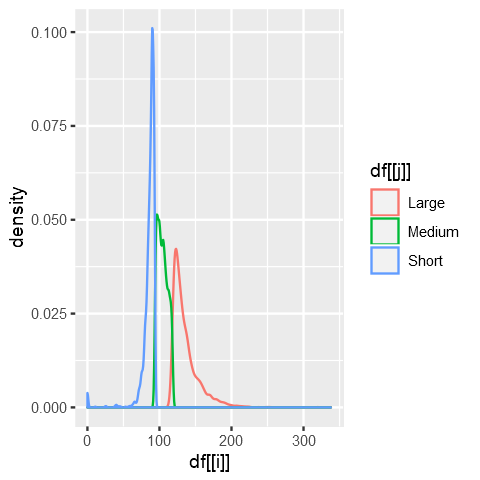

[1] "release_year by runtime_cat"


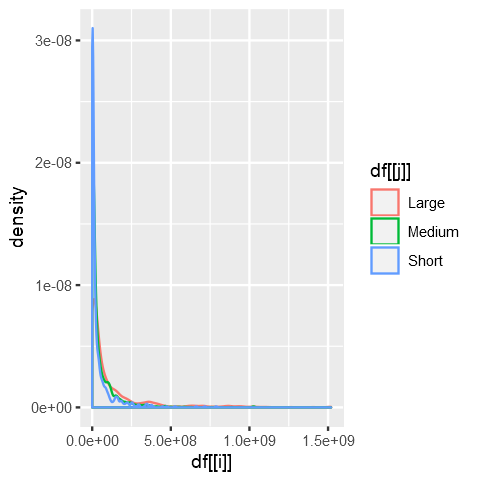

[1] "release_month by runtime_cat"


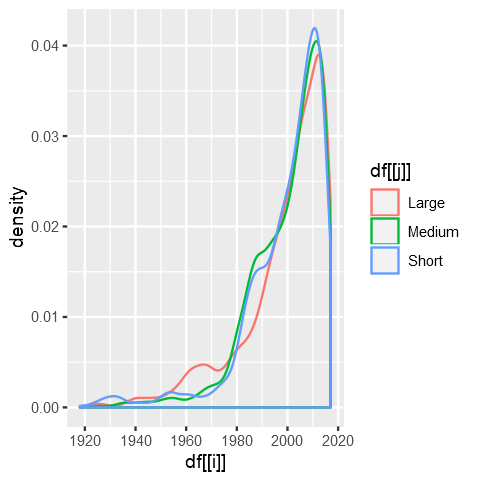

[1] "release_day by runtime_cat"


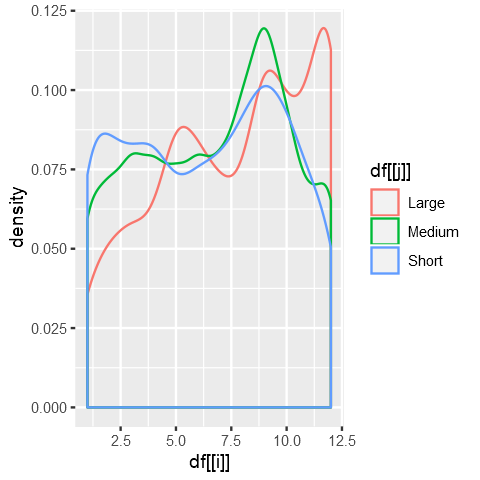

[1] "seasonality by runtime_cat"


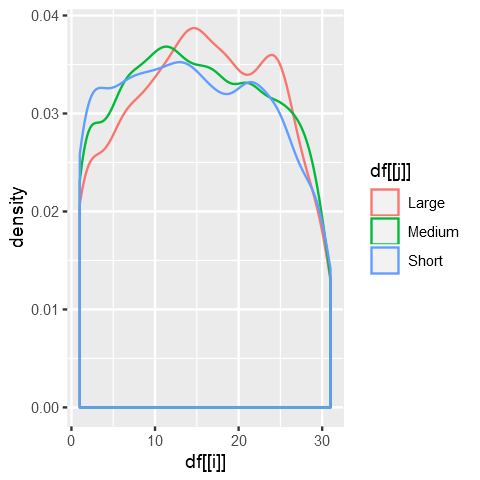

[1] "producers_cnt by runtime_cat"


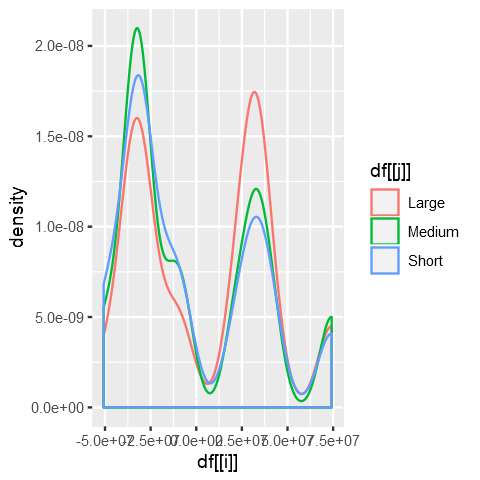

[1] "sw_female_actor0 by runtime_cat"


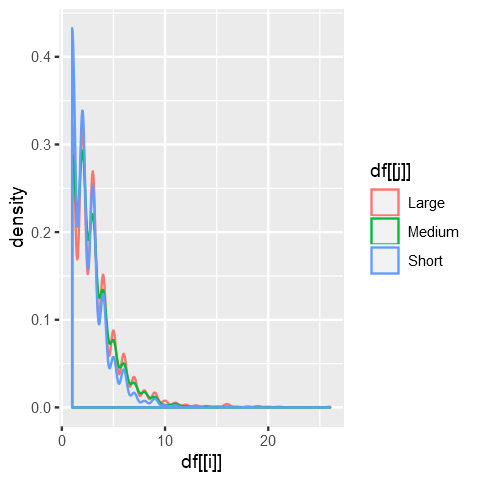

[1] "sw_female_actor1 by runtime_cat"


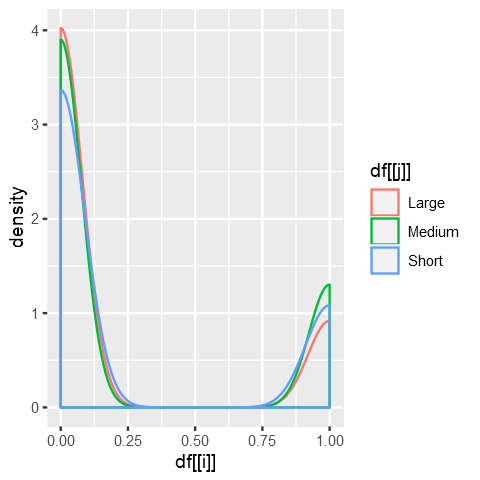

[1] "sw_female_actor2 by runtime_cat"


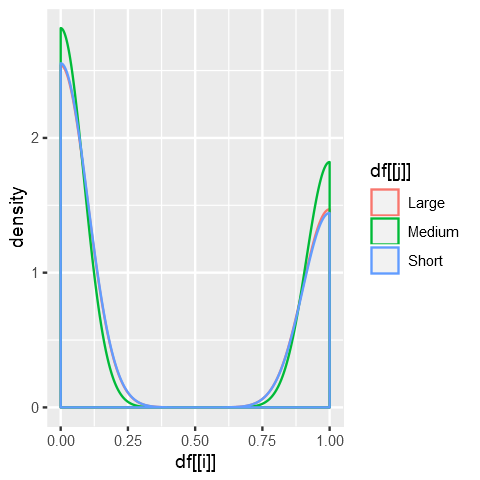

[1] "sw_male_actor0 by runtime_cat"


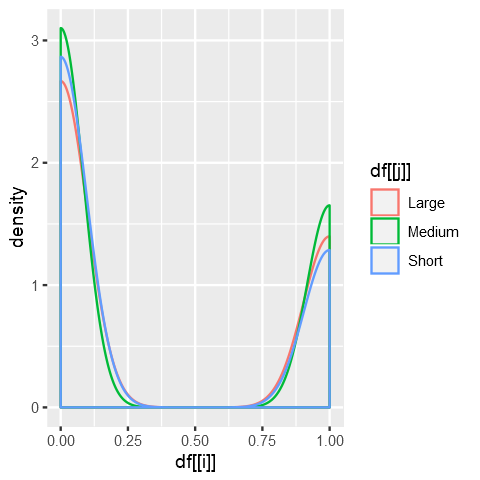

[1] "sw_male_actor1 by runtime_cat"


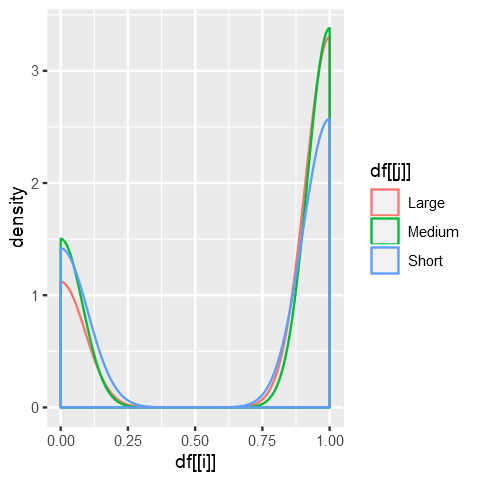

[1] "sw_male_actor2 by runtime_cat"


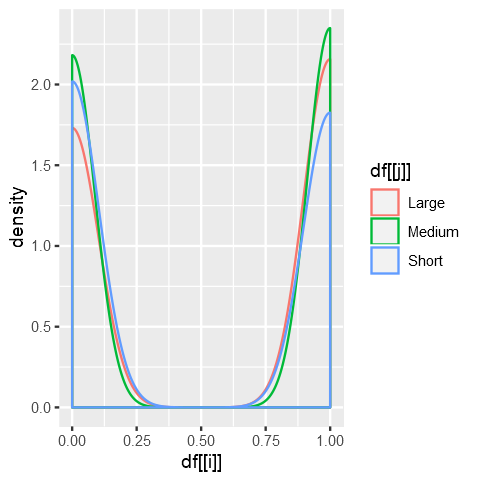

[1] "actor0_prev_revenue by runtime_cat"


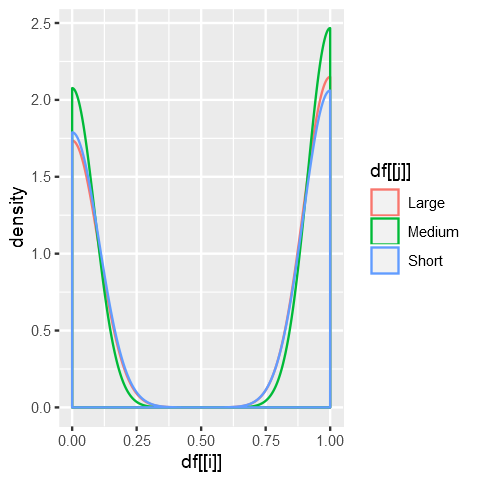

[1] "actor1_prev_revenue by runtime_cat"


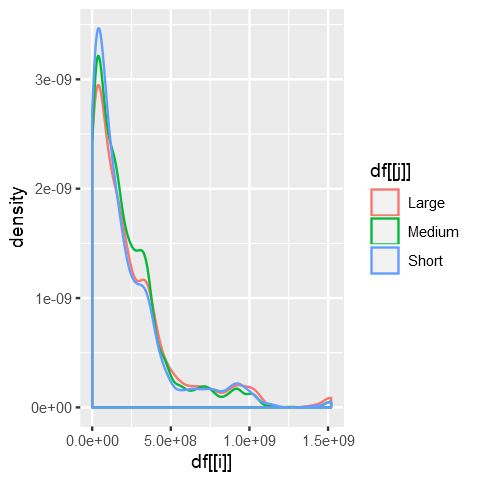

[1] "actor2_prev_revenue by runtime_cat"


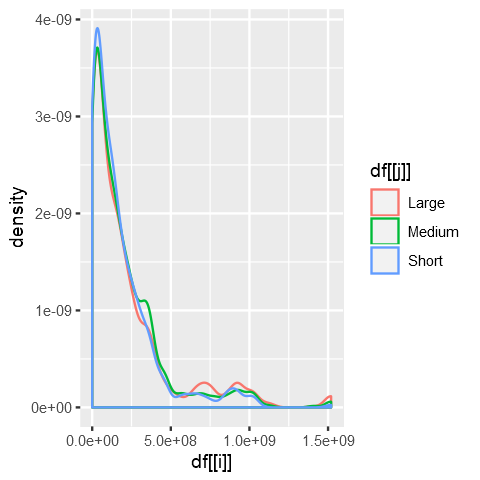

[1] "depart_Art by runtime_cat"


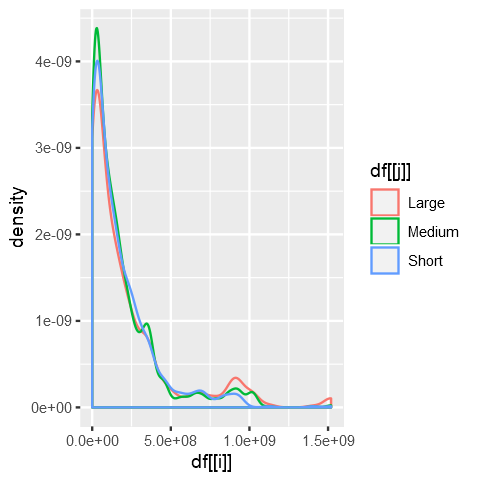

[1] "depart_Camera by runtime_cat"


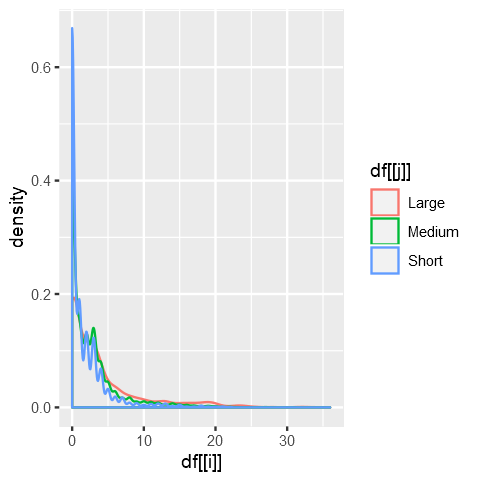

[1] "depart_Crew by runtime_cat"


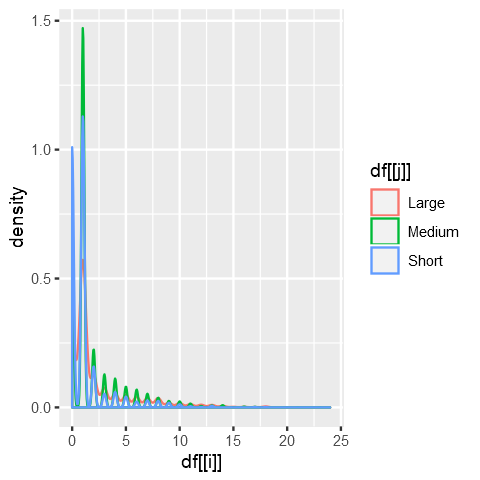

[1] "depart_Custom_Mkup by runtime_cat"


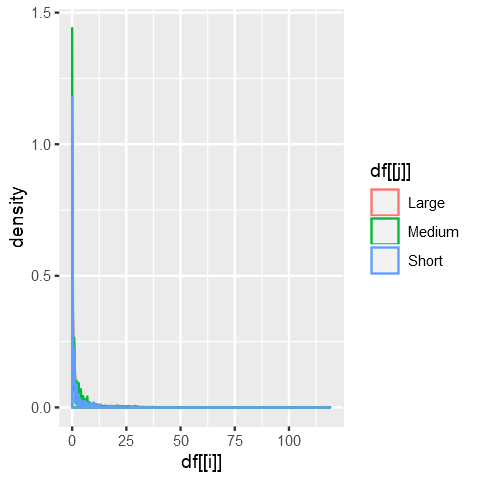

[1] "depart_Directing by runtime_cat"


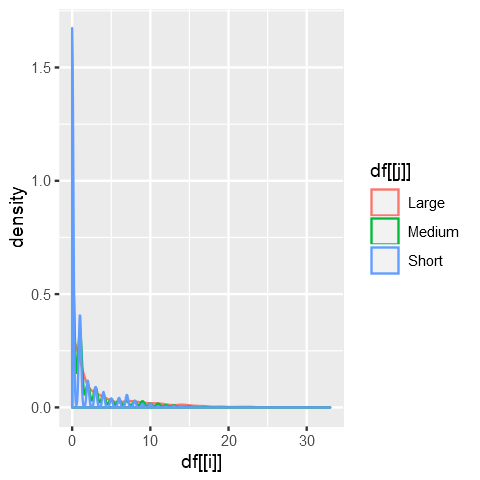

[1] "depart_Editing by runtime_cat"


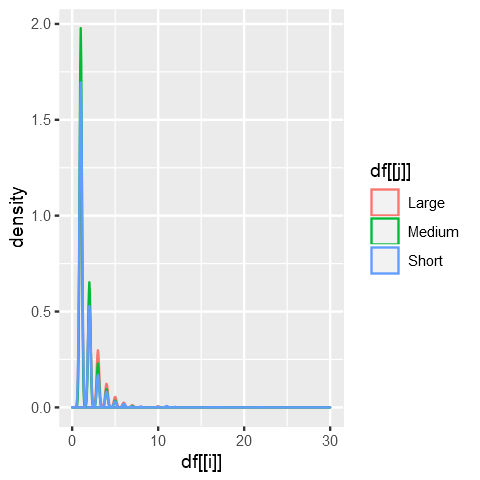

[1] "depart_Lighting by runtime_cat"


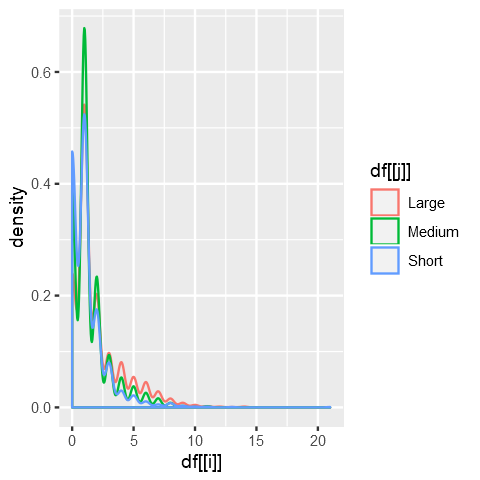

[1] "depart_Production by runtime_cat"


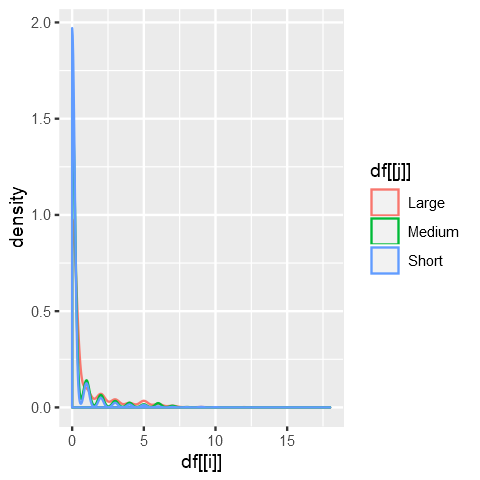

[1] "depart_Sound by runtime_cat"


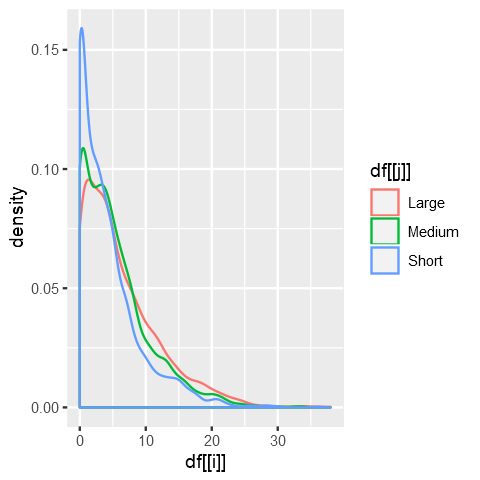

[1] "depart_Visual_Effects by runtime_cat"


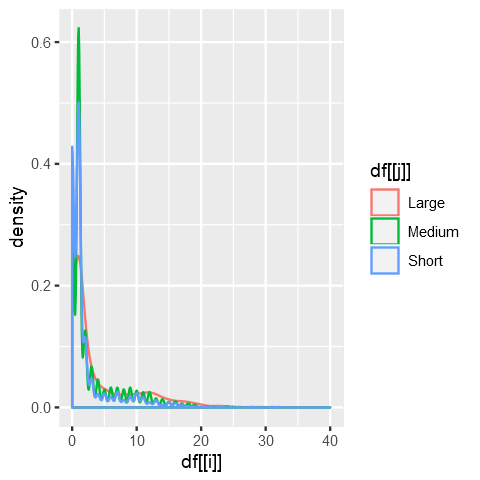

[1] "depart_Writing by runtime_cat"


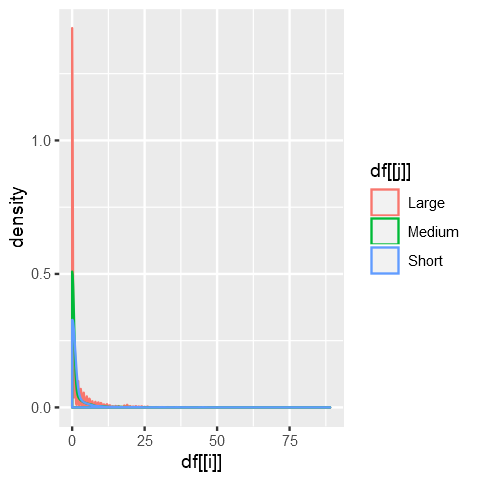

[1] "depart_Art_female by runtime_cat"


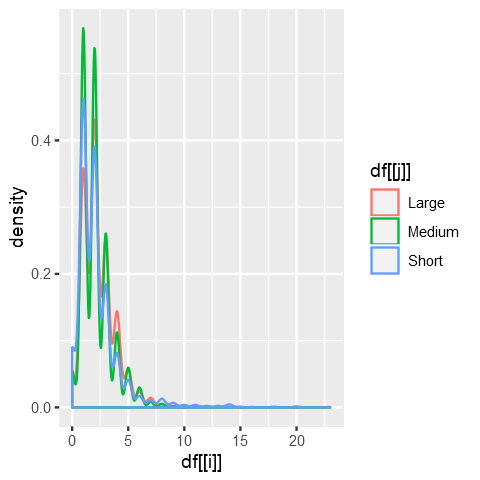

[1] "depart_Camera_female by runtime_cat"


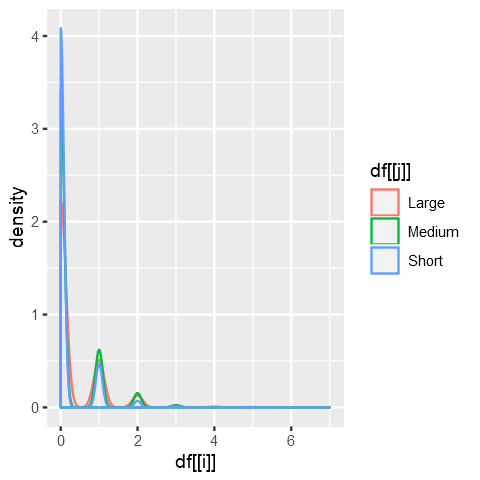

[1] "depart_Crew_female by runtime_cat"


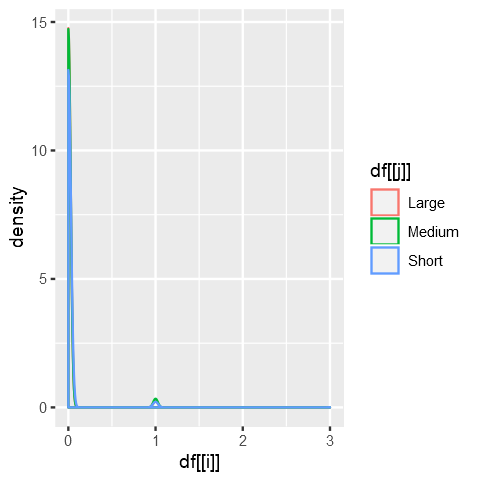

[1] "depart_Custom_Mkup_female by runtime_cat"


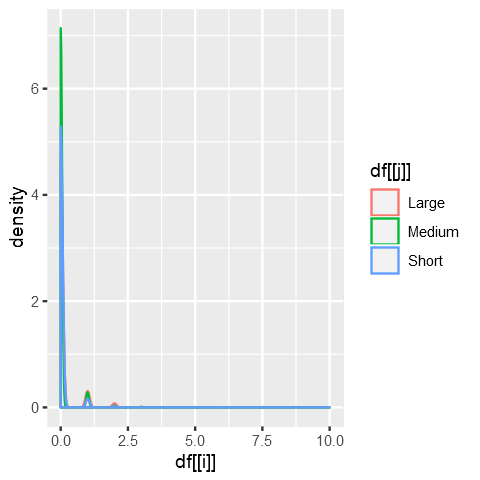

[1] "depart_Directing_female by runtime_cat"


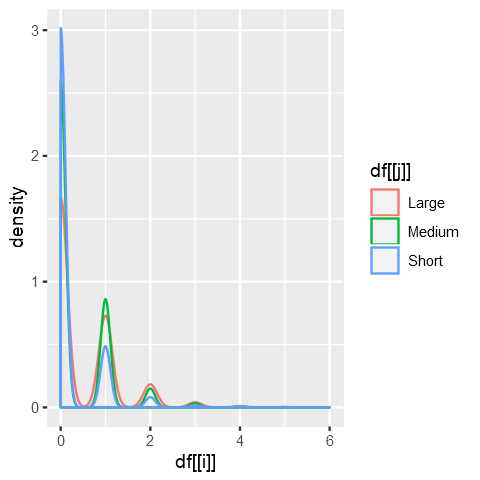

[1] "depart_Editing_female by runtime_cat"


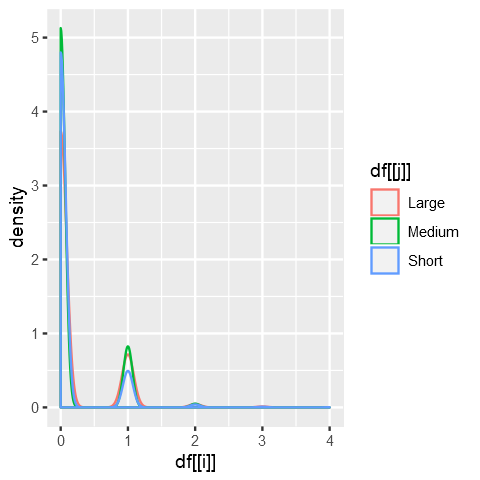

[1] "depart_Lighting_female by runtime_cat"


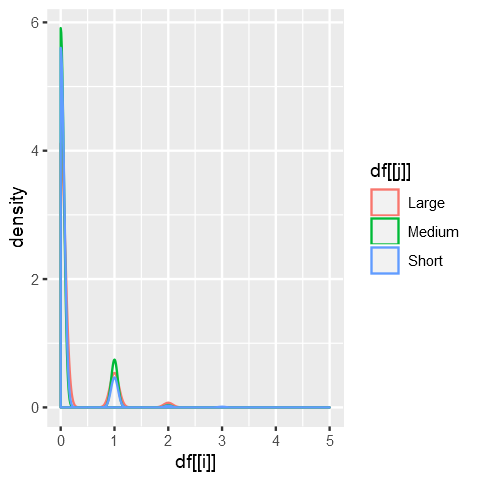

[1] "depart_Production_female by runtime_cat"


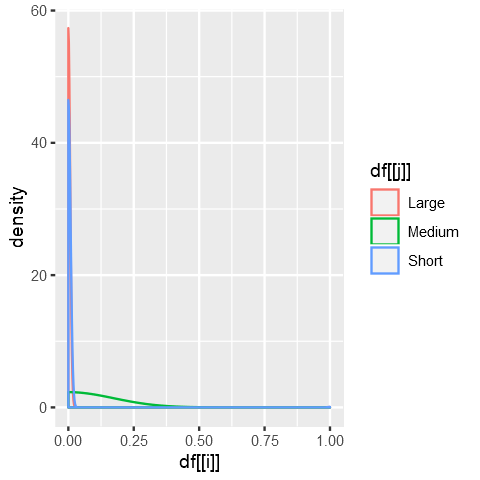

[1] "depart_Sound_female by runtime_cat"


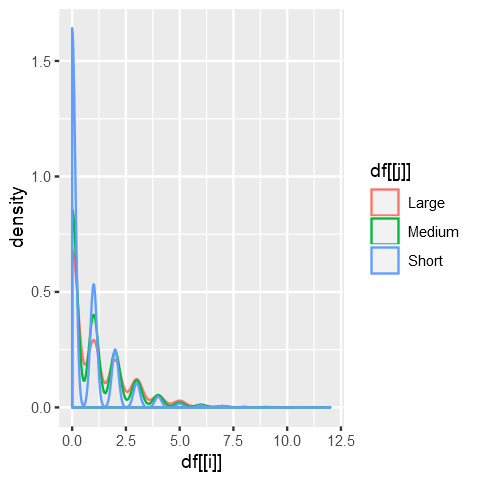

[1] "depart_Visual_Effects_female by runtime_cat"


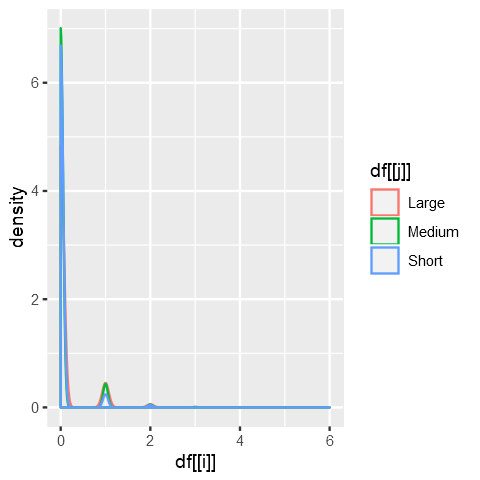

[1] "depart_Writing_female by runtime_cat"


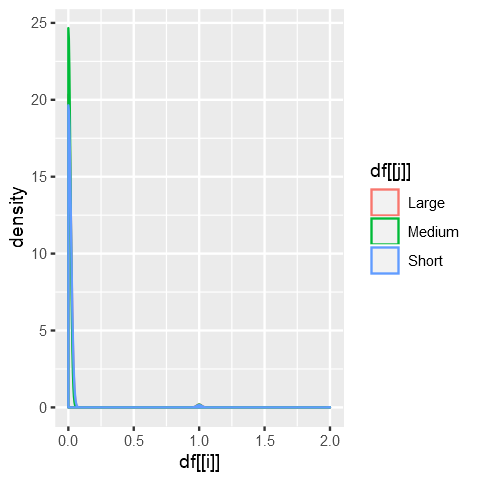

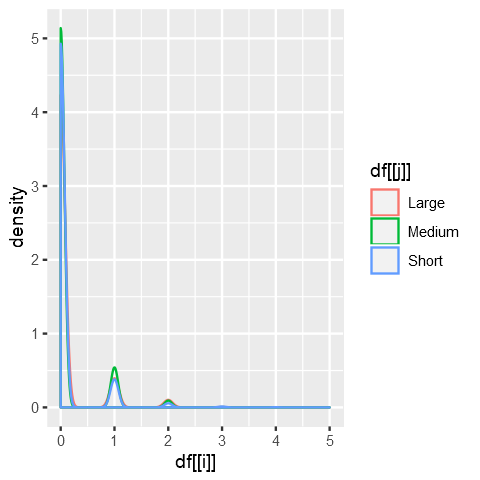

In [112]:
nm <- names(df)
## iterate through the variables
for(i in 1:length(nm)) {
    for(j in 1:length(nm)) {
        ## check if i and j are the same
        if(i!=j) {
            ## check if the variable is numeric and has missing values
            if(is.numeric(df[[i]])==TRUE & sum(df.na[[i]])>0) {
                ## if the j variable is a factor print a differential distribution plot
                if(is.factor(df[[j]])) {
                    print(paste(nm[i],"by",nm[j]))
                    p1 <- ggplot() + geom_density(aes(df[[i]],group=df[[j]],color=df[[j]]))
                    plot(p1)
                }
            }
        }
    }
}


### 4 - Repeat the EDA to ensure that everything is Ok and the dataset is ready for model generation
 
In this phase, we have to make the following steps:

1. Descriptive Statistics
2. Data visualization


In [ ]:
head(df.final)

In [ ]:
summary(df.final)

In [ ]:
#Budget Outliers
ggplot(data=df.final) +
    geom_point(aes(x=movie_id, y=budget)) +
    geom_hline(yintercept = 40000000 ,color="red")

In [128]:
exploreData(data=df.final, y=y)

  |===================================================================== |  99%

character(0)
attr(,"status")
[1] 1